<div style="text-align: center"> <span style="font-size:28px;"><b>Fabiola Barrios Cabrera</b> </span></div>

<br>
<br>
<br>
<div style="text-align: center"> <span style="font-size:28px;"><b>Wage Segmentation By Economic Sector In Ireland (2008-2022), </b> </span></div>
<div style="text-align: center"> <span style="font-size:28px;"><b> An Analysis Through Machine Learning Models.</b> </span></div>
<br>  
<br>
<br>


# Index

1. [Dataset](#1.-Dataset)


2. [Importing the libraries](#2.-Importing-the-libraries)


3. [Data Collection and Analysis. Characterization of the data set](#3.-Data-Collection-and-Analysis.-Characterization-of-the-data-set)


4. [Data preparation](#4.-Data-preparation)

4.1 [Selection of variables within the Statistic column](#4.1-Selection-of-variables-within-the-Statistic-column)

A. [Average Hourly Earnings (Seasonally Adjusted)](#A.-Average-Hourly-Earnings-(Seasonally-Adjusted))

B. [Average Weekly Earnings (Seasonally Adjusted](#B.-Average-Weekly-Earnings-(Seasonally-Adjusted))

C. [Employment](#C-Employment)

D. [Average Weekly Paid Hours (Seasonally Adjusted)](#D.-Average-Weekly-Paid-Hours-(Seasonally-Adjusted))


4.2 [Merging the subsets in a new database](#4.2-Merging-the-subsets-in-a-new-database)


4.3 [New Database Preparation](#4.3-New-Database-Preparation)

A. [Characterization of the New Dataset](#A.-Characterization-of-the-New-Dataset)

B. [Feature Encoding](#B.-Feature-Encoding)

C. [Data Transformation](#C.-Data-Transformation)

D. [Features Scaling](#D.-Features-Scaling)

E. [Data Reduction](#E.-Data-Reduction)

F. [Principal Component Analysis (PCA)](#F.-Principal-Component-Analysis-(PCA))

a. [Hourly Salary (PCA)](#a.-Hourly-Salary-(PCA))

b. [Weekly Salary (PCA)](#b.-Weekly-Salary-(PCA))


5. [Clustering Models](#5.-Clustering-Models)

5.1 [Clustering Hourly Analysis](#5.1-Clustering-Hourly-Analysis)

A1. [K-Means](#A1.-K-Means)

B1. [Agglomerative Hierarchical Clustering](#B1.-Agglomerative-Hierarchical-Clustering)

C1. [Fuzzy C-Means Clustering Model](#C1.-Fuzzy-C-Means-Clustering-Model)

D1. [K-Means vs. Hierarchical vs. C-Means Clustering](#D1.-K-Means-vs.-Hierarchical-vs.-C-Means-Clustering)


5.2 [Clustering Weekly Analysis](#5.2-Clustering-Weekly-Analysis)

A2. [K-Means](#A2.-K-Means)

B2. [Agglomerative Hierarchical Clustering](#B2.-Agglomerative-Hierarchical-Clustering)

C2. [Fuzzy C-Means Clustering Model](#C2.-Fuzzy-C-Means-Clustering-Model)

D2. [K-Means vs. Hierarchical vs. C-Means Clustering](#D2.-K-Means-vs.-Hierarchical-vs.-C-Means-Clustering)

[References](#-References)

# 1. Introduction

# 1. Dataset

For the present analysis we will make use of the public database of Average Earnings, Hours Worked, Employment and Labour Costs of Ireland (EHQ03), whose quarterly database analyses the economic sectors under the NACE Rev.2 classification system of economic activities by type of employee and which covers the study periods from the first quarter of 2008 to the first quarter of 2022. The database was obtained from the official website of the Central Statistics Office (CSO) of Ireland, which can be accessed at the following link: https://data.cso.ie/table/EHQ03.

The database consists of a total of 81396 rows with the following 6 attributes:

**Statistic:** Statistical variables collected within the Irish Wage, Hour and Labour Cost Survey (EHECS). 

**Quarter:** Quarterly analysis date from the first quarter of 2008 to the first quarter of 2022. Q1 being the first quarter, Q2 the second quarter, Q3 the third quarter and Q4 the fourth quarter.

**Economic Sector NACE Rev 2:** Comprises enterprises within the latest system of classification of economic activities

**Type Of Employee:** Corresponds to the category of employees by occupation. For some enterprises, information was collected separately for different occupational groups.

**Unit:** The unit of measurement for the various variables, comprised of Number, Euro and Hours.

**Value:** The values of the data analysed in number of employees, Euro and number of hours.


# 2. Importing the libraries

We will import the libraries that we will utilise to manipulate our database before we start our analysis:

In [1]:
#Importing the libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
import ptitprince
from __future__ import print_function 
import datetime as dt
from datetime import datetime
import warnings
import statsmodels
import plotly.graph_objs as go # Importing high-level chart objects


# Imports to create Neural Net and metrics associated
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import random
import tensorflow as tf

# Imports to create Clustering Models
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics import silhouette_samples
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score
from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score

# import the library for hierarchical clustering
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch
from scipy.cluster.hierarchy import dendrogram, linkage

# import the library for Density Based Clustering (DBSCAN)
from sklearn.cluster import DBSCAN

# import the library for Fuzzy C-Means Clusterings
from fcmeans import FCM

from matplotlib import cm


from sklearn.model_selection import GridSearchCV


import mysql.connector
from pandas_profiling import ProfileReport

import cufflinks as cf
cf.go_offline()

from plotly.offline import iplot, init_notebook_mode # Off-line mode
from plotly import tools # Import tools
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.graph_objs as go # Importing high-level chart objects
init_notebook_mode()

import warnings
warnings.filterwarnings('ignore') # We can suppress the warnings
%matplotlib inline

In [2]:
#!pip install tensorflow

# 3. Data Collection and Analysis. Characterization of the data set

We will proceed to load the database using Pandas, which will read our CSV file, once this is done we will proceed to create a general report of our database.

In [3]:
#Reading the dataset
df = pd.read_csv("Data/employment_type.csv")
df

,Statistic,Quarter,Economic Sector NACE Rev 2,Type of Employee,UNIT,VALUE
0,Employment,2008Q1,All NACE economic sectors,All employees,Number,1767200
1,Employment,2008Q1,All NACE economic sectors,"Managers, professionals and associated profess...",Number,549400
2,Employment,2008Q1,All NACE economic sectors,"Clerical, sales and service employees",Number,685300
3,Employment,2008Q1,All NACE economic sectors,"Production, transport, craft and other manual ...",Number,532600
4,Employment,2008Q1,Mining and quarrying (B),All employees,Number,7100
...,...,...,...,...,...,...
81391,Average Hourly Benefit in Kind (Seasonally Adj...,2022Q1,"Financial, insurance and real estate activitie...","Production, transport, craft and other manual ...",Euro,NaN
81392,Average Hourly Benefit in Kind (Seasonally Adj...,2022Q1,"Arts, entertainment, recreation and other serv...",All employees,Euro,NaN
81393,Average Hourly Benefit in Kind (Seasonally Adj...,2022Q1,"Arts, entertainment, recreation and other serv...","Managers, professionals and associated profess...",Euro,NaN
81394,Average Hourly Benefit in Kind (Seasonally Adj...,2022Q1,"Arts, entertainment, recreation and other serv...","Clerical, sales and service employees",Euro,NaN


In [4]:
#General report of our database
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

We can see a summary of the database, which includes the number of our variables, the number of missing data as well as the percentage of them, etc. In the same way, a summary of each of our features is broken down.

The size of our database is shown below.

In [5]:
#Checking the size
df.shape

(81396, 6)

Using the `.info` function (Pandas, 2008-2021c; McQuaid, 2021a; Louzan, 2021a) we can get a more concise summary of all of our features.

In [6]:
#Gettig some information about the dataset
df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81396 entries, 0 to 81395
Data columns (total 6 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   Statistic                   81396 non-null  object
 1   Quarter                     81396 non-null  object
 2   Economic Sector NACE Rev 2  81396 non-null  object
 3   Type of Employee            81396 non-null  object
 4   UNIT                        81396 non-null  object
 5   VALUE                       22240 non-null  object
dtypes: object(6)
memory usage: 3.7+ MB


We will use the following function to have a better perspective of the performance of the data based on a small statistical description of the data (Louzan, 2021a) .

In [7]:
#Statistical description of the numerical variables
df.describe().T

,count,unique,top,freq
Statistic,81396,17,Employment,4788
Quarter,81396,57,2008Q1,1428
Economic Sector NACE Rev 2,81396,21,All NACE economic sectors,3876
Type of Employee,81396,4,All employees,20349
UNIT,81396,3,Euro,67032
VALUE,22240,7416,0.01,107


In [8]:
#Statistical description of the categorical variables
df.describe(include=object).T

,count,unique,top,freq
Statistic,81396,17,Employment,4788
Quarter,81396,57,2008Q1,1428
Economic Sector NACE Rev 2,81396,21,All NACE economic sectors,3876
Type of Employee,81396,4,All employees,20349
UNIT,81396,3,Euro,67032
VALUE,22240,7416,0.01,107


We check if our database contains any duplicate rows to discard them from our analysis (McQuaid, 2021a), These occur when two or more rows have the same or nearly the same values. Duplicate observations can cause an error in the data and could influence subsequent analyses of the data. Because of this, it is good practice to examine a dataset for duplicate or near-duplicate observations.

In [9]:
#Checking for duplicate rows
duplicate_rows_df = df[df.duplicated()]
print("number of duplicate rows:", duplicate_rows_df.shape)

number of duplicate rows: (0, 6)


The function results in our database showing no duplicate rows.

We analyze the total number of data per column.

In [10]:
#The number of non-null values in each data frame column
df.count()

Statistic                     81396
Quarter                       81396
Economic Sector NACE Rev 2    81396
Type of Employee              81396
UNIT                          81396
VALUE                         22240
dtype: int64

Next we apply the .isnull function which in conjunction with .values.any will check for the existence of any missing values (McQuaid, 2021b).

In [11]:
#Checking missing values
df.isnull().values.any()

True

We have a positive result of missing values

We revise the total number of missing values per feature. For this we use the `.isnull` function in conjunction with `.sum()` (eddie_4072, 2021; Varsheni, 2021).

In [12]:
#Checking total null data per column
print(df.isnull().sum())

Statistic                         0
Quarter                           0
Economic Sector NACE Rev 2        0
Type of Employee                  0
UNIT                              0
VALUE                         59156
dtype: int64


As we can see our columns `VALUE` show a total of `59156` missing data.

We examine the corresponding percentage of missing values with respect to the total data per feature (Varsheni, 2021).

In [13]:
#Percentage of missing values per feature
mis_value_percent = 100 * df.isnull().sum() / len(df)
print(mis_value_percent)

Statistic                      0.00000
Quarter                        0.00000
Economic Sector NACE Rev 2     0.00000
Type of Employee               0.00000
UNIT                           0.00000
VALUE                         72.67679
dtype: float64


At first glance we can corroborate a high percentage of missing data within our `VALUE` column with more than `70%` of missing data.

<AxesSubplot:>

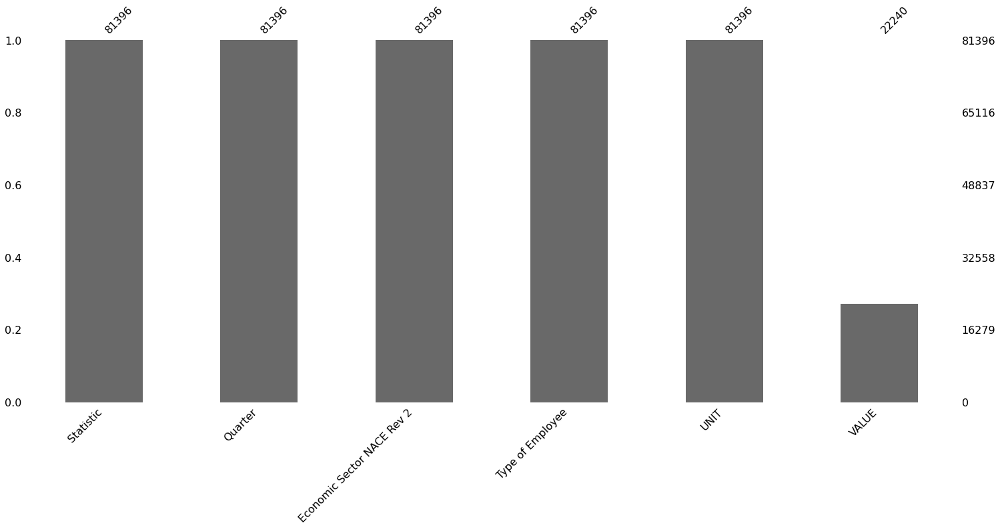

In [14]:
#Visualising missing values graphically
import missingno as msno
msno.bar(df)

The missing graph provides a better overview of the integrity of our database (Varsheni, 2021), we can see our column mentioned above with a high percentage of missing data.

We will similarly employ the `msno.matrix` nullity matrix which will allow us to detect missing data patterns in our data frame (Varsheni, 2021).

<AxesSubplot:>

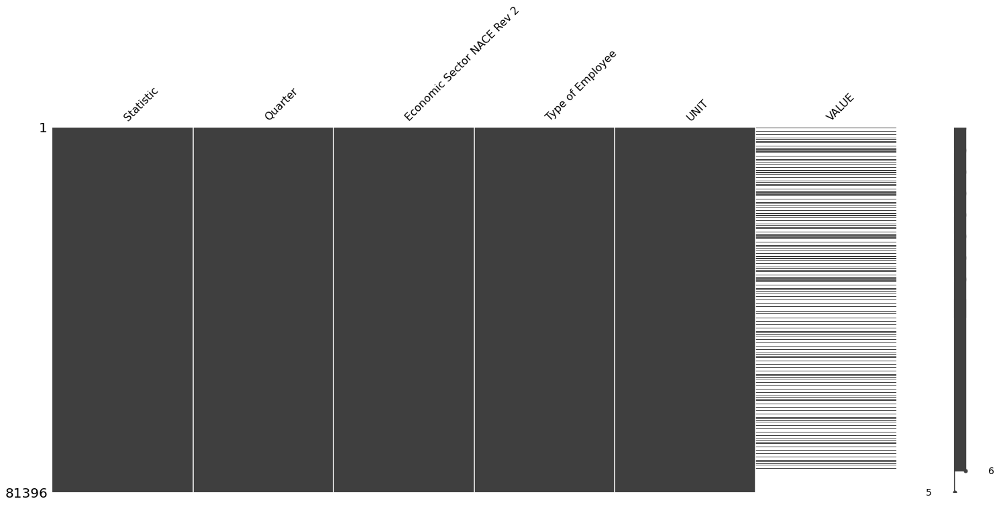

In [15]:
#Visualising missing values graphically
msno.matrix(df)

By observing the graph we can see some blank areas, which represent missing data in the database (Varsheni, 2021).

Another visual way to detect our missing values is through seaborn's heatmap.

<AxesSubplot:>

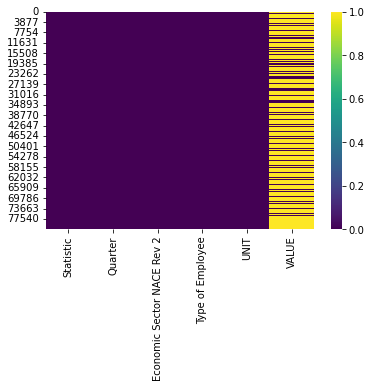

In [16]:
#Visualising missing values graphically
sns.heatmap(df.isnull(), cmap='viridis')

The graph above shows our missing values highlighted in yellow. The x-axis represents our columns and the y-axis represents the rows of our database.

Next we will analyze the unique values within our `Statistic` column.

In [17]:
#Reviewing unique values / showing the different categories within the column
df['Statistic'].unique()

array(['Employment', 'Average Weekly Earnings', 'Average Hourly Earnings',
       'Average Hourly Earnings excluding Irregular Earnings',
       'Average Weekly Paid Hours', 'Average Hourly Irregular Earnings',
       'Average Hourly Other Labour Costs',
       'Average Hourly Total Labour Costs',
       'Average Hourly Benefit in Kind',
       'Average Weekly Earnings (Seasonally Adjusted)',
       'Average Hourly Earnings (Seasonally Adjusted)',
       'Average Hourly Earnings excluding Irregular Earnings (Seasonally Adjusted)',
       'Average Weekly Paid Hours (Seasonally Adjusted)',
       'Average Hourly Irregular Earnings (Seasonally Adjusted)',
       'Average Hourly Other Labour Costs (Seasonally Adjusted)',
       'Average Hourly Total Labour Costs (Seasonally Adjusted)',
       'Average Hourly Benefit in Kind (Seasonally Adjusted)'],
      dtype=object)

16 unique values are observed within our column

We check the total frequency of each of the unique values within the Statistic column.

In [18]:
#Analysing the total frequency by category
df['Statistic'].value_counts()

Employment                                                                    4788
Average Weekly Earnings (Seasonally Adjusted)                                 4788
Average Hourly Total Labour Costs (Seasonally Adjusted)                       4788
Average Hourly Other Labour Costs (Seasonally Adjusted)                       4788
Average Hourly Irregular Earnings (Seasonally Adjusted)                       4788
Average Weekly Paid Hours (Seasonally Adjusted)                               4788
Average Hourly Earnings excluding Irregular Earnings (Seasonally Adjusted)    4788
Average Hourly Earnings (Seasonally Adjusted)                                 4788
Average Hourly Benefit in Kind                                                4788
Average Weekly Earnings                                                       4788
Average Hourly Total Labour Costs                                             4788
Average Hourly Other Labour Costs                                             4788
Aver

We have as a total of `4788` data regarding each variable analyzed within the `Statistic` column

We analyze the unique data within our column `Quarter` to check for the presence of anomalous data

In [19]:
#Reviewing unique values / showing the different categories within the column
df['Quarter'].unique()

array(['2008Q1', '2008Q2', '2008Q3', '2008Q4', '2009Q1', '2009Q2',
       '2009Q3', '2009Q4', '2010Q1', '2010Q2', '2010Q3', '2010Q4',
       '2011Q1', '2011Q2', '2011Q3', '2011Q4', '2012Q1', '2012Q2',
       '2012Q3', '2012Q4', '2013Q1', '2013Q2', '2013Q3', '2013Q4',
       '2014Q1', '2014Q2', '2014Q3', '2014Q4', '2015Q1', '2015Q2',
       '2015Q3', '2015Q4', '2016Q1', '2016Q2', '2016Q3', '2016Q4',
       '2017Q1', '2017Q2', '2017Q3', '2017Q4', '2018Q1', '2018Q2',
       '2018Q3', '2018Q4', '2019Q1', '2019Q2', '2019Q3', '2019Q4',
       '2020Q1', '2020Q2', '2020Q3', '2020Q4', '2021Q1', '2021Q2',
       '2021Q3', '2021Q4', '2022Q1'], dtype=object)

We can see that the `Quarter` column contains data from the first quarter of 2008 to the first quarter of 2022

We analyze the frequency of data by analyzed variable

In [20]:
#Analysing the total frequency by category
df['Quarter'].value_counts()

2008Q1    1428
2015Q2    1428
2015Q4    1428
2016Q1    1428
2016Q2    1428
2016Q3    1428
2016Q4    1428
2017Q1    1428
2017Q2    1428
2017Q3    1428
2017Q4    1428
2018Q1    1428
2018Q2    1428
2018Q3    1428
2018Q4    1428
2019Q1    1428
2019Q2    1428
2019Q3    1428
2019Q4    1428
2020Q1    1428
2020Q2    1428
2020Q3    1428
2020Q4    1428
2021Q1    1428
2021Q2    1428
2021Q3    1428
2021Q4    1428
2015Q3    1428
2015Q1    1428
2008Q2    1428
2014Q4    1428
2008Q3    1428
2008Q4    1428
2009Q1    1428
2009Q2    1428
2009Q3    1428
2009Q4    1428
2010Q1    1428
2010Q2    1428
2010Q3    1428
2010Q4    1428
2011Q1    1428
2011Q2    1428
2011Q3    1428
2011Q4    1428
2012Q1    1428
2012Q2    1428
2012Q3    1428
2012Q4    1428
2013Q1    1428
2013Q2    1428
2013Q3    1428
2013Q4    1428
2014Q1    1428
2014Q2    1428
2014Q3    1428
2022Q1    1428
Name: Quarter, dtype: int64

And we get a total of `1428` for each quarter.

We check the unique values within our `Economic Sector NACE Rev 2` column.

In [21]:
#Reviewing unique values / showing the different categories within the column
df['Economic Sector NACE Rev 2'].unique()

array(['All NACE economic sectors', 'Mining and quarrying (B)',
       'Manufacturing (C)', 'Construction (F)',
       'Wholesale and retail trade; repair of motor vehicles and motorcycles (G)',
       'Transportation and storage (H)',
       'Accommodation and food service activities (I)',
       'Information and communication (J)',
       'Financial and insurance activities (K)',
       'Real estate activities (L)',
       'Professional, scientific and technical activities (M)',
       'Administrative and support service activities (N)',
       'Public administration and defence; compulsory social security (O)',
       'Education (P)', 'Human health and social work activities (Q)',
       'Arts, entertainment and recreation (R)',
       'Other service activities (S)', 'Industry (B to E)',
       'Electricity, water supply and waste management (D,E)',
       'Financial, insurance and real estate activities (K,L)',
       'Arts, entertainment, recreation and other service activities (R

And we observe a total of 20 different economic sectors analyzed plus the total of all sectors, which gives us a total of 21 variables within the column.

We check the total number of data by economic sector analyzed.

In [22]:
#Analysing the total frequency by category
df['Economic Sector NACE Rev 2'].value_counts()

All NACE economic sectors                                                   3876
Administrative and support service activities (N)                           3876
Financial, insurance and real estate activities (K,L)                       3876
Electricity, water supply and waste management (D,E)                        3876
Industry (B to E)                                                           3876
Other service activities (S)                                                3876
Arts, entertainment and recreation (R)                                      3876
Human health and social work activities (Q)                                 3876
Education (P)                                                               3876
Public administration and defence; compulsory social security (O)           3876
Professional, scientific and technical activities (M)                       3876
Mining and quarrying (B)                                                    3876
Real estate activities (L)  

This gives us a total of `3876` data by economic sector.

We check the data analyzed within our `Type of Employee` feature.

In [23]:
#Reviewing unique values / showing the different categories within the column
df['Type of Employee'].unique()

array(['All employees',
       'Managers, professionals and associated professionals',
       'Clerical, sales and service employees',
       'Production, transport, craft and other manual workers'],
      dtype=object)

And we see that our column contains 4 different categories.

We review the total data contained by `Type of Employee`.

We review the total data by category within our column.

In [24]:
#Analysing the total frequency by category
df['Type of Employee'].value_counts()

All employees                                            20349
Managers, professionals and associated professionals     20349
Clerical, sales and service employees                    20349
Production, transport, craft and other manual workers    20349
Name: Type of Employee, dtype: int64

We can see that for each of the categories, which are analyzed within our column, we have a total of `20349` data.

We review the categories analyzed within our `UNIT` column.

In [25]:
#Reviewing unique values / showing the different categories within the column
df['UNIT'].unique()

array(['Number', 'Euro', 'Hours'], dtype=object)

We observe the presence of 3 different categories,`Number`, `Euro`, `Hours`.

We review the total number of data per category within the `UNIT` column.

In [26]:
#Analysing the total frequency by category
df['UNIT'].value_counts()

Euro      67032
Hours      9576
Number     4788
Name: UNIT, dtype: int64

When studying the frequency number of each of our categories, we observed a disparity of the total data between them. Where `Euro` presents a total of `67032` data, while `Number` presents the smallest number with `4788` and finally `Hours` contains a total of  `9576` data.

In [27]:
#Analysing the total frequency by category
df['VALUE'].value_counts()

0.01       107
0           69
.           49
38.1        43
36.3        43
          ... 
1019.08      1
320.55       1
519.44       1
707.36       1
45.3         1
Name: VALUE, Length: 7416, dtype: int64

# 4. Data preparation

Since a high percentage of missing values have been presented and to have a better management of our database, we will proceed to eliminate those rows with missing data.

In [28]:
# Dropping rows with missing values
df2 = df.dropna()

We display a small section of the first and last rows of our database without missing data

In [29]:
#Displaying the first 5 rows and the last 10 rows of the dataset
df2

,Statistic,Quarter,Economic Sector NACE Rev 2,Type of Employee,UNIT,VALUE
0,Employment,2008Q1,All NACE economic sectors,All employees,Number,1767200
1,Employment,2008Q1,All NACE economic sectors,"Managers, professionals and associated profess...",Number,549400
2,Employment,2008Q1,All NACE economic sectors,"Clerical, sales and service employees",Number,685300
3,Employment,2008Q1,All NACE economic sectors,"Production, transport, craft and other manual ...",Number,532600
4,Employment,2008Q1,Mining and quarrying (B),All employees,Number,7100
...,...,...,...,...,...,...
76588,Average Hourly Total Labour Costs (Seasonally ...,2022Q1,Other service activities (S),All employees,Euro,18.97
76592,Average Hourly Total Labour Costs (Seasonally ...,2022Q1,Industry (B to E),All employees,Euro,31.4
76596,Average Hourly Total Labour Costs (Seasonally ...,2022Q1,"Electricity, water supply and waste management...",All employees,Euro,36.43
76600,Average Hourly Total Labour Costs (Seasonally ...,2022Q1,"Financial, insurance and real estate activitie...",All employees,Euro,45.3


We check once again if we have any presence of missing data, just to make sure that the database is free of missing data.

In [30]:
#Checking again the total number of missing values
print(df2.isnull().sum())

Statistic                     0
Quarter                       0
Economic Sector NACE Rev 2    0
Type of Employee              0
UNIT                          0
VALUE                         0
dtype: int64


We can verify that there is no longer any missing values.

We recheck the size of our database and verify if there are any changes in our database.

In [31]:
#Checking the size
df2.shape

(22240, 6)

We can observe a high decrease in the number of rows within our database.

In [32]:
#Gettig some information about the dataset
df2.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22240 entries, 0 to 76604
Data columns (total 6 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   Statistic                   22240 non-null  object
 1   Quarter                     22240 non-null  object
 2   Economic Sector NACE Rev 2  22240 non-null  object
 3   Type of Employee            22240 non-null  object
 4   UNIT                        22240 non-null  object
 5   VALUE                       22240 non-null  object
dtypes: object(6)
memory usage: 1.2+ MB


We reviewed the information in our database and noticed that the data type of all our columns are categorical, so we will have to analyze and transform the data type in some of the columns.

For a better analysis of the data, the Quarter column was transformed into a date and time format for a later breakdown of four components: Day, Month, Year and Day of the week.

In [33]:
# Convert the date column to datetime
df2['Quarter'] = pd.to_datetime(df2['Quarter'])

In [34]:
#Breaking Down the Date into 3 Components
df2['Day']=df2['Quarter'].dt.day

df2["Month"]=df2.Quarter.dt.month_name().str[:3]

df2['Year']=df2['Quarter'].dt.year

In [35]:
#Creating new columns for the new components...
df2['Day of the week'] = df2.Quarter.dt.dayofweek
df2['Day of the week'] = df2['Day of the week'].map({0: "Monday",1: "Tuesday",2: "Wednesday" ,3: "Thursday",4:"Friday",5:"Saturday",6:"Sunday"}) #Renaming the days of the week
df2['Day of the week'] = pd.Categorical(df2['Day of the week'], categories=
    ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday', 'Sunday'],
    ordered=True)
df2

,Statistic,Quarter,Economic Sector NACE Rev 2,Type of Employee,UNIT,VALUE,Day,Month,Year,Day of the week
0,Employment,2008-01-01,All NACE economic sectors,All employees,Number,1767200,1,Jan,2008,Tuesday
1,Employment,2008-01-01,All NACE economic sectors,"Managers, professionals and associated profess...",Number,549400,1,Jan,2008,Tuesday
2,Employment,2008-01-01,All NACE economic sectors,"Clerical, sales and service employees",Number,685300,1,Jan,2008,Tuesday
3,Employment,2008-01-01,All NACE economic sectors,"Production, transport, craft and other manual ...",Number,532600,1,Jan,2008,Tuesday
4,Employment,2008-01-01,Mining and quarrying (B),All employees,Number,7100,1,Jan,2008,Tuesday
...,...,...,...,...,...,...,...,...,...,...
76588,Average Hourly Total Labour Costs (Seasonally ...,2022-01-01,Other service activities (S),All employees,Euro,18.97,1,Jan,2022,Saturday
76592,Average Hourly Total Labour Costs (Seasonally ...,2022-01-01,Industry (B to E),All employees,Euro,31.4,1,Jan,2022,Saturday
76596,Average Hourly Total Labour Costs (Seasonally ...,2022-01-01,"Electricity, water supply and waste management...",All employees,Euro,36.43,1,Jan,2022,Saturday
76600,Average Hourly Total Labour Costs (Seasonally ...,2022-01-01,"Financial, insurance and real estate activitie...",All employees,Euro,45.3,1,Jan,2022,Saturday


Let's review the data type transformation for the Quarter column and we check the new columns added.

In [36]:
# Set the index of the DataFrame to the date column
#df2.set_index("Quarter", inplace = True)

# Print DataFrame summary
df2.info()

# Print DataFrame
df2.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22240 entries, 0 to 76604
Data columns (total 10 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   Statistic                   22240 non-null  object        
 1   Quarter                     22240 non-null  datetime64[ns]
 2   Economic Sector NACE Rev 2  22240 non-null  object        
 3   Type of Employee            22240 non-null  object        
 4   UNIT                        22240 non-null  object        
 5   VALUE                       22240 non-null  object        
 6   Day                         22240 non-null  int64         
 7   Month                       22240 non-null  object        
 8   Year                        22240 non-null  int64         
 9   Day of the week             22240 non-null  category      
dtypes: category(1), datetime64[ns](1), int64(2), object(6)
memory usage: 1.7+ MB


,Statistic,Quarter,Economic Sector NACE Rev 2,Type of Employee,UNIT,VALUE,Day,Month,Year,Day of the week
0,Employment,2008-01-01,All NACE economic sectors,All employees,Number,1767200,1,Jan,2008,Tuesday
1,Employment,2008-01-01,All NACE economic sectors,"Managers, professionals and associated profess...",Number,549400,1,Jan,2008,Tuesday
2,Employment,2008-01-01,All NACE economic sectors,"Clerical, sales and service employees",Number,685300,1,Jan,2008,Tuesday
3,Employment,2008-01-01,All NACE economic sectors,"Production, transport, craft and other manual ...",Number,532600,1,Jan,2008,Tuesday
4,Employment,2008-01-01,Mining and quarrying (B),All employees,Number,7100,1,Jan,2008,Tuesday


# 4.1 Selection of variables within the Statistic column

From here we will create different data groupings by selecting the variables of interest within the Statistic column

In [37]:
#Statistic Column Grouping
df2.groupby('Statistic').groups

{'Average Hourly Benefit in Kind': [38304, 38316, 38320, 38324, 38328, 38332, 38344, 38348, 38352, 38356, 38360, 38372, 38380, 38384, 38388, 38400, 38404, 38408, 38412, 38416, 38428, 38432, 38436, 38440, 38444, 38456, 38464, 38468, 38472, 38484, 38488, 38492, 38496, 38500, 38512, 38516, 38520, 38524, 38528, 38540, 38548, 38552, 38556, 38568, 38572, 38576, 38580, 38584, 38596, 38600, 38604, 38608, 38612, 38624, 38632, 38636, 38640, 38652, 38656, 38660, 38664, 38668, 38680, 38684, 38688, 38692, 38696, 38708, 38716, 38720, 38724, 38736, 38740, 38744, 38748, 38752, 38764, 38768, 38772, 38776, 38780, 38792, 38800, 38804, 38808, 38820, 38824, 38828, 38832, 38836, 38848, 38852, 38856, 38860, 38864, 38876, 38884, 38888, 38892, 38904, ...], 'Average Hourly Earnings': [9576, 9577, 9578, 9579, 9580, 9581, 9582, 9583, 9584, 9585, 9586, 9587, 9588, 9589, 9590, 9591, 9592, 9593, 9594, 9595, 9596, 9597, 9598, 9599, 9600, 9601, 9602, 9603, 9604, 9605, 9606, 9607, 9608, 9612, 9616, 9617, 9618, 9619, 96

# A. Average Hourly Earnings (Seasonally Adjusted)

Below is a subgroup for the variable `Average Hourly Earnings (Seasonally Adjusted)`.

In [38]:
# select a subset of the dataframe with the chosen columns
grouped = df2.groupby('Statistic')
print (grouped.get_group('Average Hourly Earnings (Seasonally Adjusted)'))

                                           Statistic    Quarter  \
47880  Average Hourly Earnings (Seasonally Adjusted) 2008-01-01   
47884  Average Hourly Earnings (Seasonally Adjusted) 2008-01-01   
47888  Average Hourly Earnings (Seasonally Adjusted) 2008-01-01   
47892  Average Hourly Earnings (Seasonally Adjusted) 2008-01-01   
47896  Average Hourly Earnings (Seasonally Adjusted) 2008-01-01   
...                                              ...        ...   
52648  Average Hourly Earnings (Seasonally Adjusted) 2022-01-01   
52652  Average Hourly Earnings (Seasonally Adjusted) 2022-01-01   
52656  Average Hourly Earnings (Seasonally Adjusted) 2022-01-01   
52660  Average Hourly Earnings (Seasonally Adjusted) 2022-01-01   
52664  Average Hourly Earnings (Seasonally Adjusted) 2022-01-01   

                              Economic Sector NACE Rev 2 Type of Employee  \
47880                          All NACE economic sectors    All employees   
47884                           Mining an

In [39]:
# Subgrouping the variable Average Hourly Earnings (Seasonally Adjusted)
Hourly_Earnings = grouped.get_group('Average Hourly Earnings (Seasonally Adjusted)')

We name the variable `Average Hourly Earnings (Seasonally Adjusted)` as `Hourly_Earnings` and analyze the new subgroup created.

In [40]:
#Reviewing the Hourly Earnings Subgroup
Hourly_Earnings

,Statistic,Quarter,Economic Sector NACE Rev 2,Type of Employee,UNIT,VALUE,Day,Month,Year,Day of the week
47880,Average Hourly Earnings (Seasonally Adjusted),2008-01-01,All NACE economic sectors,All employees,Euro,21.36,1,Jan,2008,Tuesday
47884,Average Hourly Earnings (Seasonally Adjusted),2008-01-01,Mining and quarrying (B),All employees,Euro,21.91,1,Jan,2008,Tuesday
47888,Average Hourly Earnings (Seasonally Adjusted),2008-01-01,Manufacturing (C),All employees,Euro,19.71,1,Jan,2008,Tuesday
47892,Average Hourly Earnings (Seasonally Adjusted),2008-01-01,Construction (F),All employees,Euro,19.66,1,Jan,2008,Tuesday
47896,Average Hourly Earnings (Seasonally Adjusted),2008-01-01,Wholesale and retail trade; repair of motor ve...,All employees,Euro,16.29,1,Jan,2008,Tuesday
...,...,...,...,...,...,...,...,...,...,...
52648,Average Hourly Earnings (Seasonally Adjusted),2022-01-01,Other service activities (S),All employees,Euro,19.4,1,Jan,2022,Saturday
52652,Average Hourly Earnings (Seasonally Adjusted),2022-01-01,Industry (B to E),All employees,Euro,26.29,1,Jan,2022,Saturday
52656,Average Hourly Earnings (Seasonally Adjusted),2022-01-01,"Electricity, water supply and waste management...",All employees,Euro,31.5,1,Jan,2022,Saturday
52660,Average Hourly Earnings (Seasonally Adjusted),2022-01-01,"Financial, insurance and real estate activitie...",All employees,Euro,35.98,1,Jan,2022,Saturday


We create a Profile Report of our new subset.

In [41]:
#General report of our Hourly_Earnings subset
ProfileReport(Hourly_Earnings)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

We rename the columns: `Quarter to Date`, `Economic Sector NACE Rev 2 to Economic_Sector` and `VALUE to Hourly_Salary`.

In [42]:
#Renaming columns
Hourly_Earnings.rename(columns={'Quarter': 'Date', 'Economic Sector NACE Rev 2': 'Economic_Sector', 'VALUE': 'Hourly_Salary' }, inplace=True)
Hourly_Earnings.head(1)

,Statistic,Date,Economic_Sector,Type of Employee,UNIT,Hourly_Salary,Day,Month,Year,Day of the week
47880,Average Hourly Earnings (Seasonally Adjusted),2008-01-01,All NACE economic sectors,All employees,Euro,21.36,1,Jan,2008,Tuesday


We remove the Statistic and UNIT column.

In [43]:
#Dropping unnecesary columns
Hourly_Earnings.drop(['Statistic','UNIT'], axis=1, inplace=True)
Hourly_Earnings.head(0)

,Date,Economic_Sector,Type of Employee,Hourly_Salary,Day,Month,Year,Day of the week


We analyze the frequency by unique values of Employee Type

In [44]:
#Analyzing the frequency by unique values of Type of Employee
Hourly_Earnings['Type of Employee'].value_counts()

All employees    1197
Name: Type of Employee, dtype: int64

We analyze the frequency by unique values of Economic_Sector

In [45]:
#Analyzing the frequency by unique values of Economic_Sector
Hourly_Earnings['Economic_Sector'].value_counts()

All NACE economic sectors                                                   57
Administrative and support service activities (N)                           57
Financial, insurance and real estate activities (K,L)                       57
Electricity, water supply and waste management (D,E)                        57
Industry (B to E)                                                           57
Other service activities (S)                                                57
Arts, entertainment and recreation (R)                                      57
Human health and social work activities (Q)                                 57
Education (P)                                                               57
Public administration and defence; compulsory social security (O)           57
Professional, scientific and technical activities (M)                       57
Mining and quarrying (B)                                                    57
Real estate activities (L)                          

We change the data type inside our variable Hourly_Salary to type float.

In [46]:
#Changing the data type
Hourly_Earnings['Hourly_Salary'] = Hourly_Earnings['Hourly_Salary'].astype(float)
Hourly_Earnings['Hourly_Salary'].dtype

dtype('float64')

We check if there is a correlation between our variables.

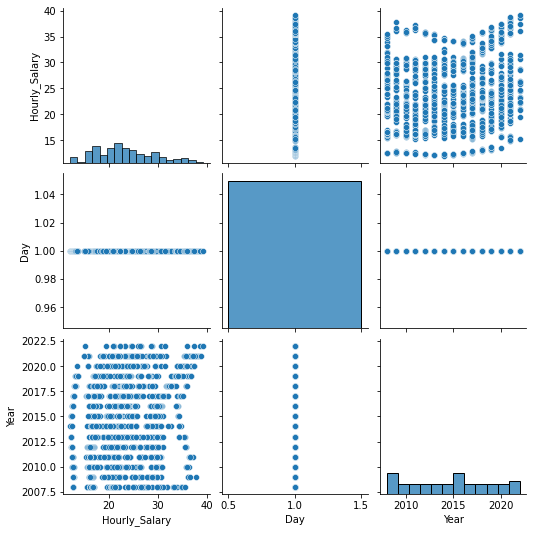

In [47]:
#checking correlation
sns.pairplot(data=Hourly_Earnings);  

In [48]:
def plot_data_count(Hourly_Earnings, col, return_pct_share=True, hue=None, figsize=(12,6)):
    
    plt.figure(figsize=figsize)
    g = sns.countplot(data=Hourly_Earnings, x=col, hue=hue)
    for rect in g.patches:
        h = rect.get_height()
        w = rect.get_width()
        x = rect.get_x()
        y = rect.get_y()
        g.annotate(f"{h}", (x+w/2, h), ha='center', va='bottom', fontsize=12)
    g.spines['top'].set_visible(False)
    g.spines['right'].set_visible(False)
    g.spines['left'].set_visible(False)
    
    plt.show()
    
    if return_pct_share:
        print("\n")
        print("Percent share for each category:")
        print(df[col].value_counts(normalize=True)*100)

We plot the average hourly wages over the month.

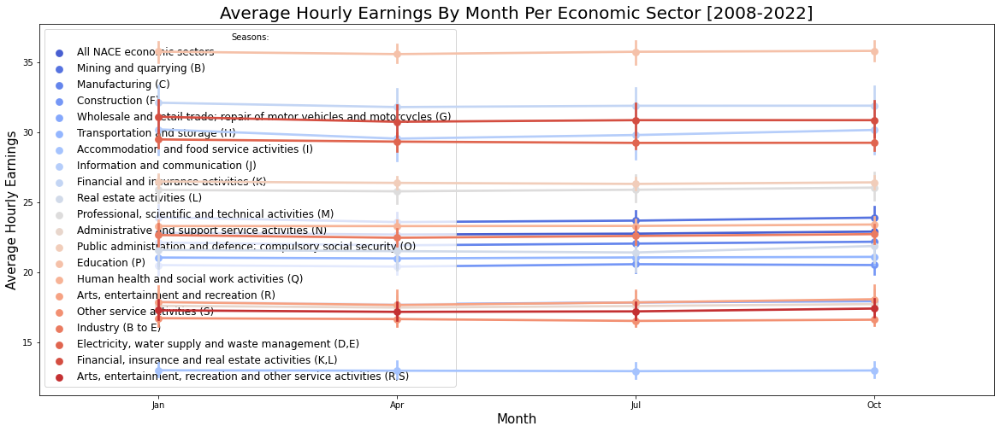

In [49]:
# Graph of the average wages per hour with respect to the month
fig, ax = plt.subplots(figsize=(20, 8))
sns.pointplot(x='Month', y='Hourly_Salary', hue='Economic_Sector', data=Hourly_Earnings, palette='coolwarm')

plt.title('Average Hourly Earnings By Month Per Economic Sector [2008-2022]', fontsize =20)
plt.ylabel("Average Hourly Earnings", fontsize =15)
plt.xlabel('Month', fontsize =15)


plt.legend(title = "Seasons:", loc='upper left', fontsize=12)

plt.savefig('pointplot.png', dpi=300, bbox_inches='tight');

We plot a bar graph to analyze the average hourly wages by economic sector from the year 2008 to the year 2022.

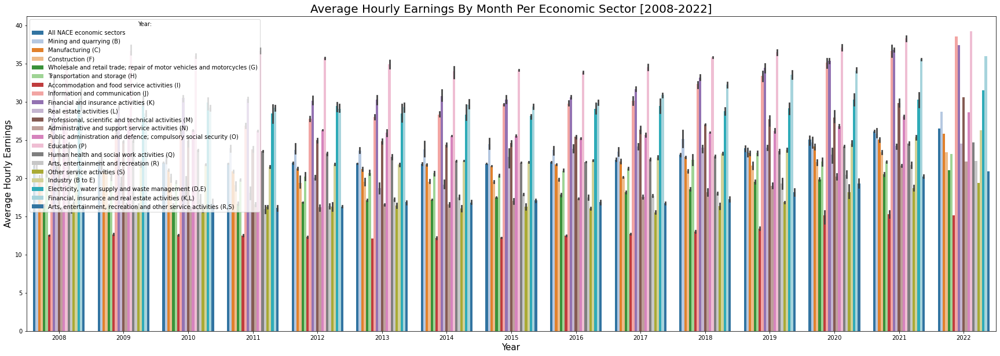

In [50]:
#Bar graph of average hourly wages with respect to the Economic Sector, from 2008 to 2022.
f, ax = plt.subplots(1, 1, figsize=(30, 10))
ax =sns.barplot(x='Year', y='Hourly_Salary', hue='Economic_Sector', data=Hourly_Earnings, palette='tab20')

plt.title('Average Hourly Earnings By Month Per Economic Sector [2008-2022]', fontsize =20)
plt.ylabel("Average Hourly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Year:", loc='upper left', fontsize=10)

plt.savefig('barplot2.png', dpi=300, bbox_inches='tight');

We plot the corresponding time lines for average hourly wages for each Economic Sector from 2008 to 2022.

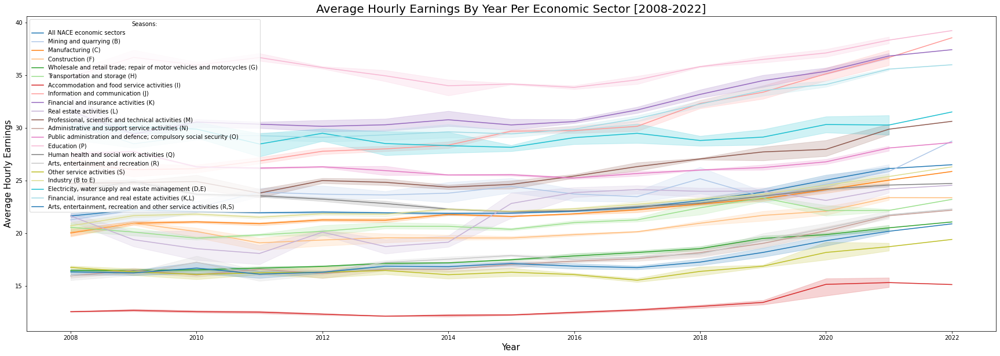

In [51]:
# Time series of the average wage per hour for each Economic Sector from 2008 to 2022

fig, ax = plt.subplots(figsize=(30, 10))
sns.lineplot(x='Year', y='Hourly_Salary', hue='Economic_Sector', data=Hourly_Earnings, palette='tab20')

plt.title('Average Hourly Earnings By Year Per Economic Sector [2008-2022]', fontsize =20)
plt.ylabel("Average Hourly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Seasons:", loc='upper left', fontsize=10)

plt.savefig('pointplot.png', dpi=300, bbox_inches='tight');

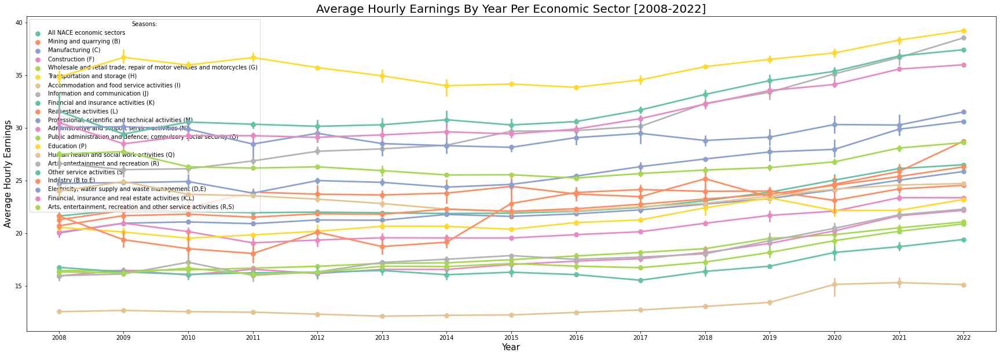

In [52]:
#Time series of the average wage per hour for each Economic Sector from 2008 to 2022

fig, ax = plt.subplots(figsize=(30, 10))
sns.pointplot(x='Year', y='Hourly_Salary', hue='Economic_Sector', data=Hourly_Earnings, palette='Set2')

plt.title('Average Hourly Earnings By Year Per Economic Sector [2008-2022]', fontsize =20)
plt.ylabel("Average Hourly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Seasons:", loc='upper left', fontsize=10)

plt.savefig('pointplot.png', dpi=300, bbox_inches='tight');

We group average hourly wages into years in order to better analyse both wages and sectors by year.

In [53]:
# select a subset of the dataframe with the chosen columns
Sector = Hourly_Earnings.groupby('Economic_Sector')
Education = Sector.get_group('Education (P)')

In [54]:
Education

,Date,Economic_Sector,Type of Employee,Hourly_Salary,Day,Month,Year,Day of the week
47932,2008-01-01,Education (P),All employees,33.92,1,Jan,2008,Tuesday
48016,2008-04-01,Education (P),All employees,34.69,1,Apr,2008,Tuesday
48100,2008-07-01,Education (P),All employees,35.03,1,Jul,2008,Tuesday
48184,2008-10-01,Education (P),All employees,35.57,1,Oct,2008,Wednesday
48268,2009-01-01,Education (P),All employees,36.26,1,Jan,2009,Thursday
48352,2009-04-01,Education (P),All employees,36.13,1,Apr,2009,Wednesday
48436,2009-07-01,Education (P),All employees,37.75,1,Jul,2009,Wednesday
48520,2009-10-01,Education (P),All employees,36.58,1,Oct,2009,Thursday
48604,2010-01-01,Education (P),All employees,35.90,1,Jan,2010,Friday
48688,2010-04-01,Education (P),All employees,35.66,1,Apr,2010,Thursday


In [55]:
Accommodation = Sector.get_group('Accommodation and food service activities (I)')
Accommodation

,Date,Economic_Sector,Type of Employee,Hourly_Salary,Day,Month,Year,Day of the week
47904,2008-01-01,Accommodation and food service activities (I),All employees,12.51,1,Jan,2008,Tuesday
47988,2008-04-01,Accommodation and food service activities (I),All employees,12.55,1,Apr,2008,Tuesday
48072,2008-07-01,Accommodation and food service activities (I),All employees,12.53,1,Jul,2008,Tuesday
48156,2008-10-01,Accommodation and food service activities (I),All employees,12.59,1,Oct,2008,Wednesday
48240,2009-01-01,Accommodation and food service activities (I),All employees,12.87,1,Jan,2009,Thursday
48324,2009-04-01,Accommodation and food service activities (I),All employees,12.58,1,Apr,2009,Wednesday
48408,2009-07-01,Accommodation and food service activities (I),All employees,12.58,1,Jul,2009,Wednesday
48492,2009-10-01,Accommodation and food service activities (I),All employees,12.62,1,Oct,2009,Thursday
48576,2010-01-01,Accommodation and food service activities (I),All employees,12.72,1,Jan,2010,Friday
48660,2010-04-01,Accommodation and food service activities (I),All employees,12.47,1,Apr,2010,Thursday


In [56]:
communication = Sector.get_group('Information and communication (J)')
communication

,Date,Economic_Sector,Type of Employee,Hourly_Salary,Day,Month,Year,Day of the week
47908,2008-01-01,Information and communication (J),All employees,27.24,1,Jan,2008,Tuesday
47992,2008-04-01,Information and communication (J),All employees,26.04,1,Apr,2008,Tuesday
48076,2008-07-01,Information and communication (J),All employees,26.64,1,Jul,2008,Tuesday
48160,2008-10-01,Information and communication (J),All employees,26.56,1,Oct,2008,Wednesday
48244,2009-01-01,Information and communication (J),All employees,26.07,1,Jan,2009,Thursday
48328,2009-04-01,Information and communication (J),All employees,26.25,1,Apr,2009,Wednesday
48412,2009-07-01,Information and communication (J),All employees,25.09,1,Jul,2009,Wednesday
48496,2009-10-01,Information and communication (J),All employees,26.70,1,Oct,2009,Thursday
48580,2010-01-01,Information and communication (J),All employees,25.63,1,Jan,2010,Friday
48664,2010-04-01,Information and communication (J),All employees,25.85,1,Apr,2010,Thursday


In [57]:
Financial = Sector.get_group('Financial and insurance activities (K)')
Financial

,Date,Economic_Sector,Type of Employee,Hourly_Salary,Day,Month,Year,Day of the week
47912,2008-01-01,Financial and insurance activities (K),All employees,33.13,1,Jan,2008,Tuesday
47996,2008-04-01,Financial and insurance activities (K),All employees,33.22,1,Apr,2008,Tuesday
48080,2008-07-01,Financial and insurance activities (K),All employees,31.07,1,Jul,2008,Tuesday
48164,2008-10-01,Financial and insurance activities (K),All employees,28.84,1,Oct,2008,Wednesday
48248,2009-01-01,Financial and insurance activities (K),All employees,29.74,1,Jan,2009,Thursday
48332,2009-04-01,Financial and insurance activities (K),All employees,29.00,1,Apr,2009,Wednesday
48416,2009-07-01,Financial and insurance activities (K),All employees,29.05,1,Jul,2009,Wednesday
48500,2009-10-01,Financial and insurance activities (K),All employees,29.84,1,Oct,2009,Thursday
48584,2010-01-01,Financial and insurance activities (K),All employees,29.85,1,Jan,2010,Friday
48668,2010-04-01,Financial and insurance activities (K),All employees,30.71,1,Apr,2010,Thursday


In [58]:
Insurance = Sector.get_group('Financial, insurance and real estate activities (K,L)')
Insurance

,Date,Economic_Sector,Type of Employee,Hourly_Salary,Day,Month,Year,Day of the week
47956,2008-01-01,"Financial, insurance and real estate activitie...",All employees,31.93,1,Jan,2008,Tuesday
48040,2008-04-01,"Financial, insurance and real estate activitie...",All employees,31.80,1,Apr,2008,Tuesday
48124,2008-07-01,"Financial, insurance and real estate activitie...",All employees,30.28,1,Jul,2008,Tuesday
48208,2008-10-01,"Financial, insurance and real estate activitie...",All employees,27.94,1,Oct,2008,Wednesday
48292,2009-01-01,"Financial, insurance and real estate activitie...",All employees,28.96,1,Jan,2009,Thursday
48376,2009-04-01,"Financial, insurance and real estate activitie...",All employees,28.06,1,Apr,2009,Wednesday
48460,2009-07-01,"Financial, insurance and real estate activitie...",All employees,28.11,1,Jul,2009,Wednesday
48544,2009-10-01,"Financial, insurance and real estate activitie...",All employees,28.78,1,Oct,2009,Thursday
48628,2010-01-01,"Financial, insurance and real estate activitie...",All employees,28.68,1,Jan,2010,Friday
48712,2010-04-01,"Financial, insurance and real estate activitie...",All employees,29.32,1,Apr,2010,Thursday


In [59]:
# Grouping average hourly wages in years
Year_Hourly_Earnings = Hourly_Earnings.groupby(['Year', 'Economic_Sector']).mean()
Year_Hourly_Earnings = pd.DataFrame(Year_Hourly_Earnings)
Year_Hourly_Earnings = Year_Hourly_Earnings.reset_index()
Year_Hourly_Earnings

,Year,Economic_Sector,Hourly_Salary,Day
0,2008,Accommodation and food service activities (I),12.5450,1.0
1,2008,Administrative and support service activities (N),15.9325,1.0
2,2008,All NACE economic sectors,21.6275,1.0
3,2008,"Arts, entertainment and recreation (R)",15.9600,1.0
4,2008,"Arts, entertainment, recreation and other serv...",16.3225,1.0
...,...,...,...,...
310,2022,"Professional, scientific and technical activit...",30.6100,1.0
311,2022,Public administration and defence; compulsory ...,28.5900,1.0
312,2022,Real estate activities (L),24.5400,1.0
313,2022,Transportation and storage (H),23.2000,1.0


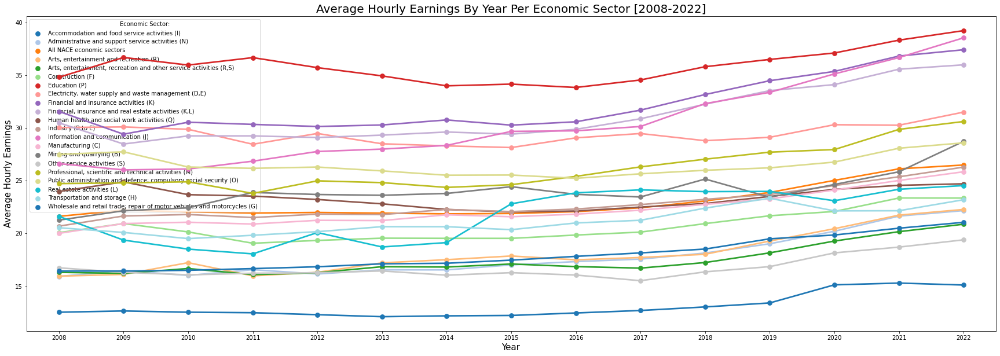

In [60]:
#Time series of the average wage per hour for each Economic Sector from 2008 to 2022
fig, ax = plt.subplots(figsize=(30, 10))
sns.pointplot(x='Year', y='Hourly_Salary', hue='Economic_Sector', data=Year_Hourly_Earnings, palette='tab20')

plt.title('Average Hourly Earnings By Year Per Economic Sector [2008-2022]', fontsize =20)
plt.ylabel("Average Hourly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Economic Sector:", loc='upper left', fontsize=10)

plt.savefig('pointplot.png', dpi=300, bbox_inches='tight');

We check the highest salaries for the year 2022.

In [61]:
#We sort the values from the largest to the smallest

Year_Hourly_Earnings.sort_values(['Year', 'Hourly_Salary'], ascending = False, axis = 0, inplace = True)
Year_Hourly_Earnings.head(20)

,Year,Economic_Sector,Hourly_Salary,Day
300,2022,Education (P),39.22,1.0
306,2022,Information and communication (J),38.54,1.0
302,2022,Financial and insurance activities (K),37.41,1.0
303,2022,"Financial, insurance and real estate activitie...",35.98,1.0
301,2022,"Electricity, water supply and waste management...",31.50,1.0
310,2022,"Professional, scientific and technical activit...",30.61,1.0
308,2022,Mining and quarrying (B),28.73,1.0
311,2022,Public administration and defence; compulsory ...,28.59,1.0
296,2022,All NACE economic sectors,26.49,1.0
305,2022,Industry (B to E),26.29,1.0


For a better visual analysis of our data, we will divide our subset into two parts. From 2008 to 2015 it will be the first part.

In [62]:
#Splitting the data subset from 2008 to 2015
First_Years = Year_Hourly_Earnings[(Year_Hourly_Earnings.Year <= 2015)]
First_Years

,Year,Economic_Sector,Hourly_Salary,Day
153,2015,Education (P),34.1525,1.0
155,2015,Financial and insurance activities (K),30.2675,1.0
159,2015,Information and communication (J),29.6750,1.0
156,2015,"Financial, insurance and real estate activitie...",29.4150,1.0
154,2015,"Electricity, water supply and waste management...",28.1450,1.0
...,...,...,...,...
20,2008,Wholesale and retail trade; repair of motor ve...,16.4450,1.0
4,2008,"Arts, entertainment, recreation and other serv...",16.3225,1.0
3,2008,"Arts, entertainment and recreation (R)",15.9600,1.0
1,2008,Administrative and support service activities (N),15.9325,1.0


Consequently, the second section will cover the years from 2016 to 2022.

In [63]:
#Splitting the data subset from 2016 to 2022
Last_Years = Year_Hourly_Earnings[(Year_Hourly_Earnings.Year >= 2016)]
Last_Years

,Year,Economic_Sector,Hourly_Salary,Day
300,2022,Education (P),39.2200,1.0
306,2022,Information and communication (J),38.5400,1.0
302,2022,Financial and insurance activities (K),37.4100,1.0
303,2022,"Financial, insurance and real estate activitie...",35.9800,1.0
301,2022,"Electricity, water supply and waste management...",31.5000,1.0
...,...,...,...,...
171,2016,"Arts, entertainment and recreation (R)",17.5075,1.0
169,2016,Administrative and support service activities (N),17.3400,1.0
172,2016,"Arts, entertainment, recreation and other serv...",16.8650,1.0
183,2016,Other service activities (S),16.0650,1.0


We make again the bar graphs to compare the average hourly wage by Economic Sector, these bar graphs will cover from 2008 to 2015

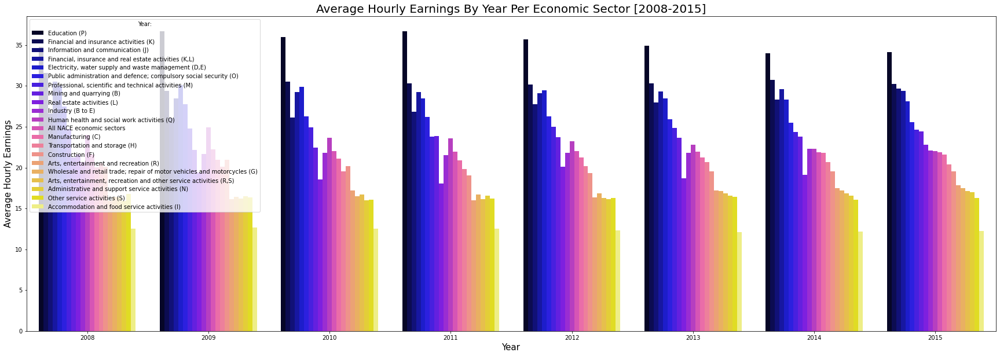

In [64]:
#Bar charts of the average hourly wage by economic sector from 2008 to 2015.
f, ax = plt.subplots(1, 1, figsize=(30, 10))
ax =sns.barplot(x='Year', y='Hourly_Salary', hue='Economic_Sector', data=First_Years, palette='gnuplot2')

plt.title('Average Hourly Earnings By Year Per Economic Sector [2008-2015]', fontsize =20)
plt.ylabel("Average Hourly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Year:", loc='upper left', fontsize=10)

plt.savefig('barplot2.png', dpi=300, bbox_inches='tight');

We graph the average hourly wage for each economic sector from 2016 to 2022.

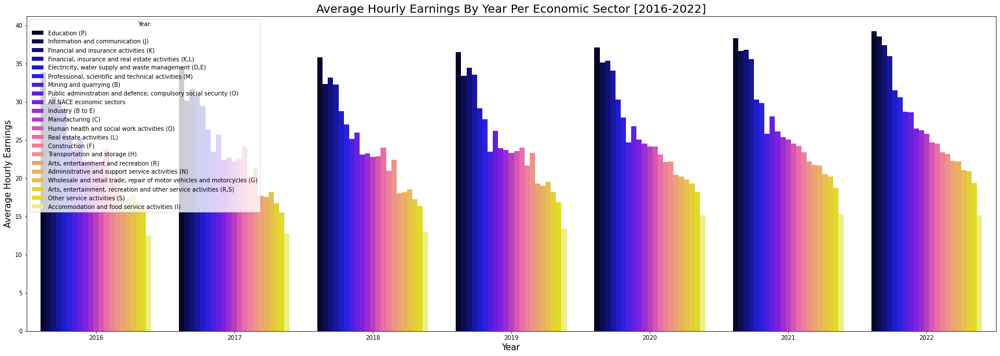

In [65]:
#Bar charts of the average hourly wage by economic sector from 2016 to 2022.
f, ax = plt.subplots(1, 1, figsize=(30, 10))
ax =sns.barplot(x='Year', y='Hourly_Salary', hue='Economic_Sector', data=Last_Years, palette='gnuplot2')

plt.title('Average Hourly Earnings By Year Per Economic Sector [2016-2022]', fontsize =20)
plt.ylabel("Average Hourly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Year:", loc='upper left', fontsize=10)

plt.savefig('barplot2.png', dpi=300, bbox_inches='tight');

Because our graphs still do not show a clear analysis of average hourly wages, we will divide the period of years of analysis into subgroups of 5 years.

The first segment will correspond to the years 2008 to 2012.

In [66]:
# First segment, 2008 to 2012
A = Year_Hourly_Earnings[(Year_Hourly_Earnings.Year <= 2012)]
A

,Year,Economic_Sector,Hourly_Salary,Day
90,2012,Education (P),35.7150,1.0
92,2012,Financial and insurance activities (K),30.1375,1.0
91,2012,"Electricity, water supply and waste management...",29.4775,1.0
93,2012,"Financial, insurance and real estate activitie...",29.0950,1.0
96,2012,Information and communication (J),27.7700,1.0
...,...,...,...,...
20,2008,Wholesale and retail trade; repair of motor ve...,16.4450,1.0
4,2008,"Arts, entertainment, recreation and other serv...",16.3225,1.0
3,2008,"Arts, entertainment and recreation (R)",15.9600,1.0
1,2008,Administrative and support service activities (N),15.9325,1.0


The second segment will correspond to the period from 2013 to 2017.

In [67]:
#  Second segment 2013 to 2017.
B = Year_Hourly_Earnings[(Year_Hourly_Earnings.Year >= 2013) & (Year_Hourly_Earnings.Year <= 2017)]
B

,Year,Economic_Sector,Hourly_Salary,Day
195,2017,Education (P),34.5450,1.0
197,2017,Financial and insurance activities (K),31.6875,1.0
198,2017,"Financial, insurance and real estate activitie...",30.8700,1.0
201,2017,Information and communication (J),30.1375,1.0
196,2017,"Electricity, water supply and waste management...",29.4725,1.0
...,...,...,...,...
125,2013,Wholesale and retail trade; repair of motor ve...,17.1275,1.0
109,2013,"Arts, entertainment, recreation and other serv...",16.8550,1.0
106,2013,Administrative and support service activities (N),16.5600,1.0
120,2013,Other service activities (S),16.4525,1.0


And finally, we will have the segment that will analyze the years 2018 to 2022

In [68]:
# Third segment, 2018-2022
C = Year_Hourly_Earnings[(Year_Hourly_Earnings.Year >= 2018)]
C

,Year,Economic_Sector,Hourly_Salary,Day
300,2022,Education (P),39.2200,1.0
306,2022,Information and communication (J),38.5400,1.0
302,2022,Financial and insurance activities (K),37.4100,1.0
303,2022,"Financial, insurance and real estate activitie...",35.9800,1.0
301,2022,"Electricity, water supply and waste management...",31.5000,1.0
...,...,...,...,...
211,2018,Administrative and support service activities (N),18.1500,1.0
213,2018,"Arts, entertainment and recreation (R)",18.0325,1.0
214,2018,"Arts, entertainment, recreation and other serv...",17.2500,1.0
225,2018,Other service activities (S),16.3675,1.0


We graph the first period.

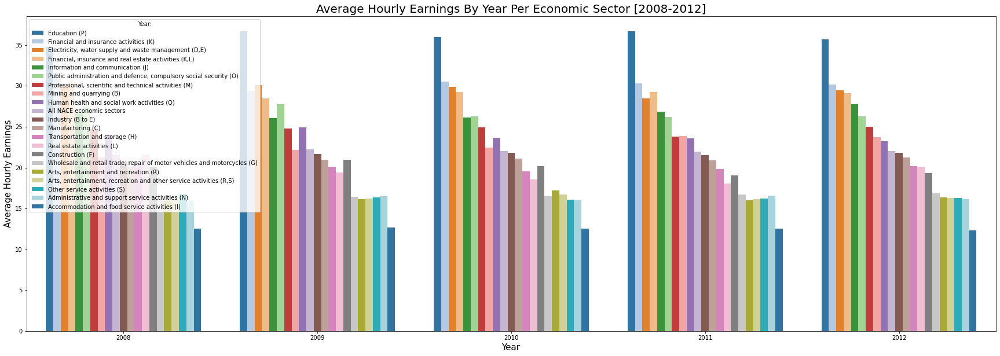

In [69]:
# Bar chart of the average hourly wage by economic sector from 2008 to 2012
f, ax = plt.subplots(1, 1, figsize=(30, 10))
ax =sns.barplot(x='Year', y='Hourly_Salary', hue='Economic_Sector', data=A, palette='tab20')

plt.title('Average Hourly Earnings By Year Per Economic Sector [2008-2012]', fontsize =20)
plt.ylabel("Average Hourly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Year:", loc='upper left', fontsize=10)

plt.savefig('barplot2.png', dpi=300, bbox_inches='tight');

We graph the second period.

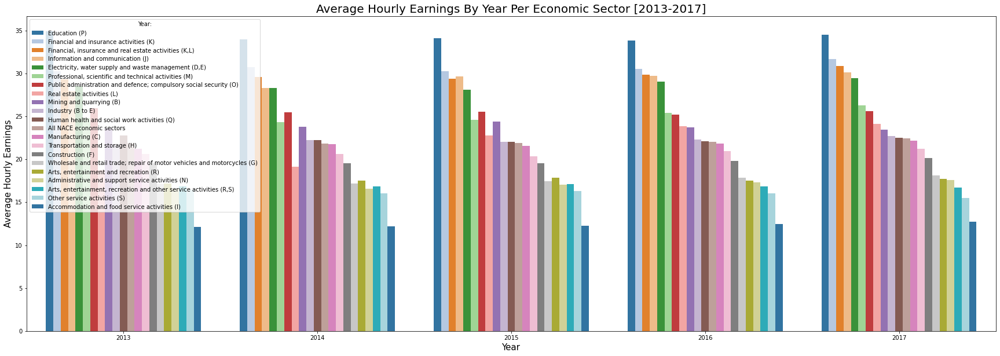

In [70]:
#Bar chart of the average hourly wage by economic sector from 2013 to 2017
f, ax = plt.subplots(1, 1, figsize=(30, 10))
ax =sns.barplot(x='Year', y='Hourly_Salary', hue='Economic_Sector', data=B, palette='tab20')

plt.title('Average Hourly Earnings By Year Per Economic Sector [2013-2017]', fontsize =20)
plt.ylabel("Average Hourly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Year:", loc='upper left', fontsize=10)

plt.savefig('barplot2.png', dpi=300, bbox_inches='tight');

We graph the third period.

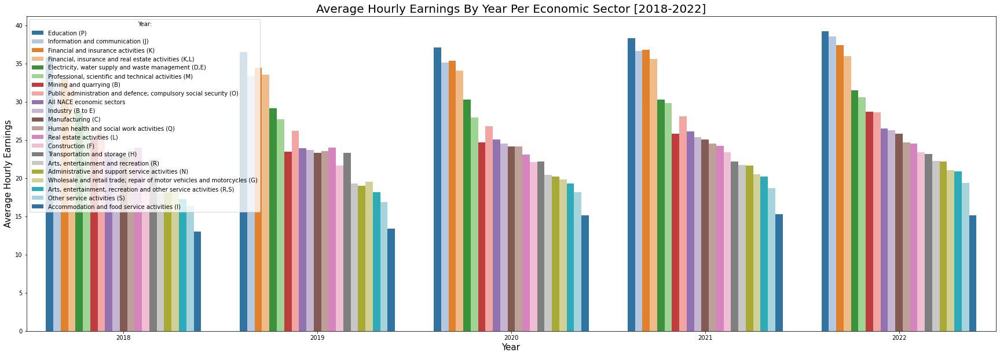

In [71]:
# #Bar chart of the average hourly wage by economic sector from 2018 to 2022
f, ax = plt.subplots(1, 1, figsize=(30, 10))
ax =sns.barplot(x='Year', y='Hourly_Salary', hue='Economic_Sector', data=C, palette='tab20')

plt.title('Average Hourly Earnings By Year Per Economic Sector [2018-2022]', fontsize =20)
plt.ylabel("Average Hourly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Year:", loc='upper left', fontsize=10)

plt.savefig('barplot2.png', dpi=300, bbox_inches='tight');

# B. Average Weekly Earnings (Seasonally Adjusted)

We create a new grouping for the variable Average Weekly Earnings (Seasonally Adjusted).

In [72]:
# select a subset of the dataframe with the chosen columns
print (grouped.get_group('Average Weekly Earnings (Seasonally Adjusted)'))

                                           Statistic    Quarter  \
43092  Average Weekly Earnings (Seasonally Adjusted) 2008-01-01   
43096  Average Weekly Earnings (Seasonally Adjusted) 2008-01-01   
43100  Average Weekly Earnings (Seasonally Adjusted) 2008-01-01   
43104  Average Weekly Earnings (Seasonally Adjusted) 2008-01-01   
43108  Average Weekly Earnings (Seasonally Adjusted) 2008-01-01   
...                                              ...        ...   
47860  Average Weekly Earnings (Seasonally Adjusted) 2022-01-01   
47864  Average Weekly Earnings (Seasonally Adjusted) 2022-01-01   
47868  Average Weekly Earnings (Seasonally Adjusted) 2022-01-01   
47872  Average Weekly Earnings (Seasonally Adjusted) 2022-01-01   
47876  Average Weekly Earnings (Seasonally Adjusted) 2022-01-01   

                              Economic Sector NACE Rev 2 Type of Employee  \
43092                          All NACE economic sectors    All employees   
43096                           Mining an

We name the variable Average Weekly Earnings (Seasonally Adjusted) as Weekly_Earnings and analyze the new subgroup created.

In [73]:
# Subgrouping the variable Average Weekly Earnings (Seasonally Adjusted)
Weekly_Earnings = grouped.get_group('Average Weekly Earnings (Seasonally Adjusted)')
Weekly_Earnings

,Statistic,Quarter,Economic Sector NACE Rev 2,Type of Employee,UNIT,VALUE,Day,Month,Year,Day of the week
43092,Average Weekly Earnings (Seasonally Adjusted),2008-01-01,All NACE economic sectors,All employees,Euro,708.59,1,Jan,2008,Tuesday
43096,Average Weekly Earnings (Seasonally Adjusted),2008-01-01,Mining and quarrying (B),All employees,Euro,970.42,1,Jan,2008,Tuesday
43100,Average Weekly Earnings (Seasonally Adjusted),2008-01-01,Manufacturing (C),All employees,Euro,757.54,1,Jan,2008,Tuesday
43104,Average Weekly Earnings (Seasonally Adjusted),2008-01-01,Construction (F),All employees,Euro,746.83,1,Jan,2008,Tuesday
43108,Average Weekly Earnings (Seasonally Adjusted),2008-01-01,Wholesale and retail trade; repair of motor ve...,All employees,Euro,515.95,1,Jan,2008,Tuesday
...,...,...,...,...,...,...,...,...,...,...
47860,Average Weekly Earnings (Seasonally Adjusted),2022-01-01,Other service activities (S),All employees,Euro,542.44,1,Jan,2022,Saturday
47864,Average Weekly Earnings (Seasonally Adjusted),2022-01-01,Industry (B to E),All employees,Euro,987.96,1,Jan,2022,Saturday
47868,Average Weekly Earnings (Seasonally Adjusted),2022-01-01,"Electricity, water supply and waste management...",All employees,Euro,1129.46,1,Jan,2022,Saturday
47872,Average Weekly Earnings (Seasonally Adjusted),2022-01-01,"Financial, insurance and real estate activitie...",All employees,Euro,1245.83,1,Jan,2022,Saturday


We rename the columns: Quarter to Date, Economic Sector NACE Rev 2 to Economic_Sector and VALUE to Weekly_Salary.

In [74]:
#Renaming columns
Weekly_Earnings.rename(columns={'Quarter': 'Date', 'Economic Sector NACE Rev 2': 'Economic_Sector', 'VALUE': 'Weekly_Salary' }, inplace=True)
Weekly_Earnings.head(1)

,Statistic,Date,Economic_Sector,Type of Employee,UNIT,Weekly_Salary,Day,Month,Year,Day of the week
43092,Average Weekly Earnings (Seasonally Adjusted),2008-01-01,All NACE economic sectors,All employees,Euro,708.59,1,Jan,2008,Tuesday


We remove the Statistic and UNIT column.

In [75]:
#Dropping unnecesary columns
Weekly_Earnings.drop(['Statistic','UNIT'], axis=1, inplace=True)
Weekly_Earnings.head(0)

,Date,Economic_Sector,Type of Employee,Weekly_Salary,Day,Month,Year,Day of the week


We analyze the frequency by unique values of Employee Type

In [76]:
#Analyzing the frequency by unique values of Type of Employee
Weekly_Earnings['Type of Employee'].value_counts()

All employees    1197
Name: Type of Employee, dtype: int64

We analyze the frequency by unique values of Economic Sector

In [77]:
#Analyzing the frequency by unique values of Economic_Sector
Weekly_Earnings['Economic_Sector'].value_counts()

All NACE economic sectors                                                   57
Administrative and support service activities (N)                           57
Financial, insurance and real estate activities (K,L)                       57
Electricity, water supply and waste management (D,E)                        57
Industry (B to E)                                                           57
Other service activities (S)                                                57
Arts, entertainment and recreation (R)                                      57
Human health and social work activities (Q)                                 57
Education (P)                                                               57
Public administration and defence; compulsory social security (O)           57
Professional, scientific and technical activities (M)                       57
Mining and quarrying (B)                                                    57
Real estate activities (L)                          

We change the data type inside our variable Weekly_Salary to type float.

In [78]:
#Changing the data type
Weekly_Earnings['Weekly_Salary'] = Weekly_Earnings['Weekly_Salary'].astype(float)
Weekly_Earnings['Weekly_Salary'].dtype

dtype('float64')

We plot the corresponding time lines for average weekly wages for each Economic Sector from 2008 to 2022.

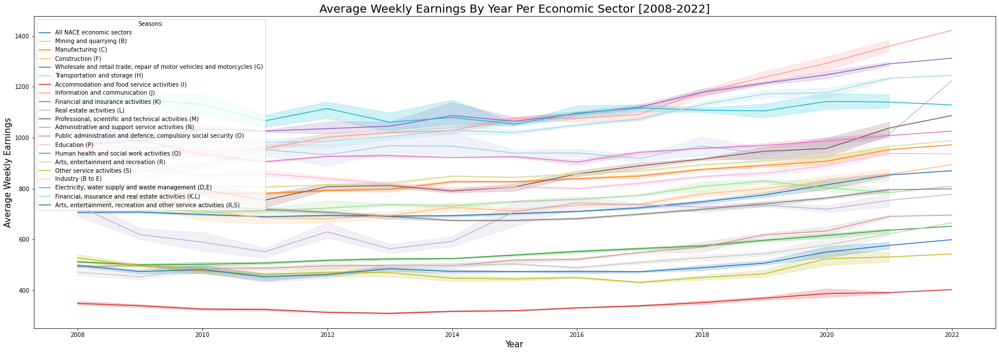

In [79]:
# Time series of the average weekly wages for each Economic Sector from 2008 to 2022
fig, ax = plt.subplots(figsize=(30, 10))
sns.lineplot(x='Year', y='Weekly_Salary', hue='Economic_Sector', data=Weekly_Earnings, palette='tab20')

plt.title('Average Weekly Earnings By Year Per Economic Sector [2008-2022]', fontsize =20)
plt.ylabel("Average Weekly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Seasons:", loc='upper left', fontsize=10)

plt.savefig('pointplot.png', dpi=300, bbox_inches='tight');

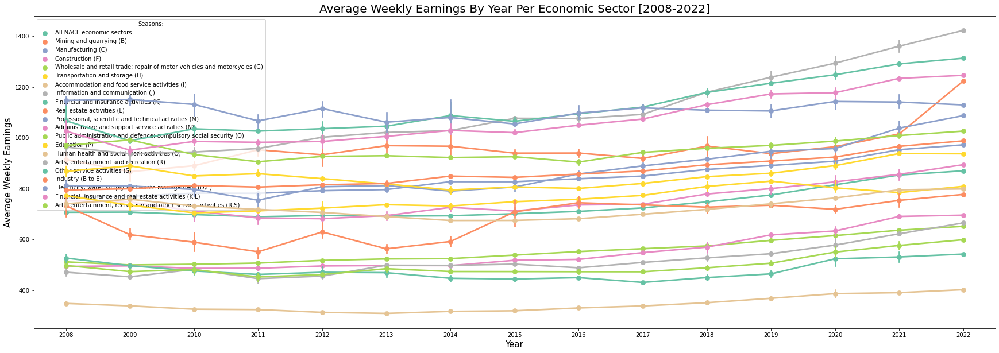

In [80]:
# Time series of the average weekly wages for each Economic Sector from 2008 to 2022
fig, ax = plt.subplots(figsize=(30, 10))
sns.pointplot(x='Year', y='Weekly_Salary', hue='Economic_Sector', data=Weekly_Earnings, palette='Set2')

plt.title('Average Weekly Earnings By Year Per Economic Sector [2008-2022]', fontsize =20)
plt.ylabel("Average Weekly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Seasons:", loc='upper left', fontsize=10)

plt.savefig('pointplot.png', dpi=300, bbox_inches='tight');

We group average weekly wages into years in order to better analyse both wages and sectors by year.

In [81]:
# Grouping average weekly wages in years
Year_Weekly_Earnings = Weekly_Earnings.groupby(['Year', 'Economic_Sector']).mean()
Year_Weekly_Earnings = pd.DataFrame(Year_Weekly_Earnings)
Year_Weekly_Earnings = Year_Weekly_Earnings.reset_index()
Year_Weekly_Earnings

,Year,Economic_Sector,Weekly_Salary,Day
0,2008,Accommodation and food service activities (I),348.1825,1.0
1,2008,Administrative and support service activities (N),493.8225,1.0
2,2008,All NACE economic sectors,706.9125,1.0
3,2008,"Arts, entertainment and recreation (R)",470.9975,1.0
4,2008,"Arts, entertainment, recreation and other serv...",497.4650,1.0
...,...,...,...,...
310,2022,"Professional, scientific and technical activit...",1087.3300,1.0
311,2022,Public administration and defence; compulsory ...,1026.3700,1.0
312,2022,Real estate activities (L),777.2300,1.0
313,2022,Transportation and storage (H),808.9800,1.0


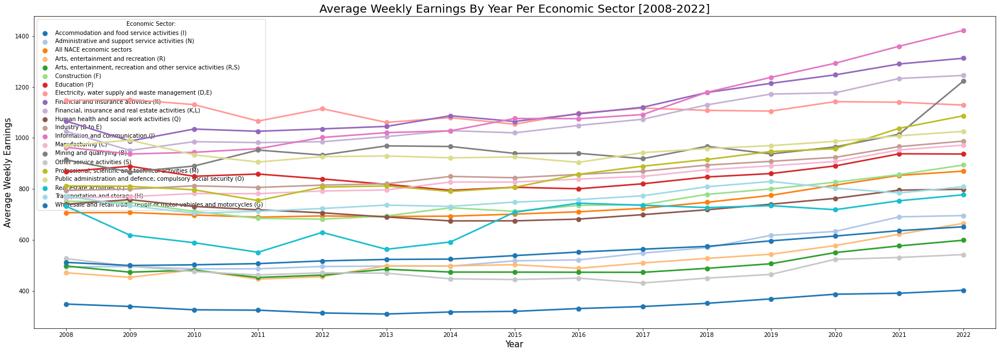

In [82]:
# Time series of the average weekly wages for each Economic Sector from 2008 to 2022
fig, ax = plt.subplots(figsize=(30, 10))
sns.pointplot(x='Year', y='Weekly_Salary', hue='Economic_Sector', data=Year_Weekly_Earnings, palette='tab20')

plt.title('Average Weekly Earnings By Year Per Economic Sector [2008-2022]', fontsize =20)
plt.ylabel("Average Weekly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Economic Sector:", loc='upper left', fontsize=10)

plt.savefig('pointplot.png', dpi=300, bbox_inches='tight');

In [83]:
# select a subset of the dataframe with the chosen columns
Sector2 = Weekly_Earnings.groupby('Economic_Sector')
Communication2 = Sector2.get_group('Information and communication (J)')
Communication2

,Date,Economic_Sector,Type of Employee,Weekly_Salary,Day,Month,Year,Day of the week
43120,2008-01-01,Information and communication (J),All employees,998.29,1,Jan,2008,Tuesday
43204,2008-04-01,Information and communication (J),All employees,946.97,1,Apr,2008,Tuesday
43288,2008-07-01,Information and communication (J),All employees,950.53,1,Jul,2008,Tuesday
43372,2008-10-01,Information and communication (J),All employees,958.91,1,Oct,2008,Wednesday
43456,2009-01-01,Information and communication (J),All employees,946.61,1,Jan,2009,Thursday
43540,2009-04-01,Information and communication (J),All employees,941.45,1,Apr,2009,Wednesday
43624,2009-07-01,Information and communication (J),All employees,892.28,1,Jul,2009,Wednesday
43708,2009-10-01,Information and communication (J),All employees,968.91,1,Oct,2009,Thursday
43792,2010-01-01,Information and communication (J),All employees,915.88,1,Jan,2010,Friday
43876,2010-04-01,Information and communication (J),All employees,934.86,1,Apr,2010,Thursday


In [84]:
Accommodation2 = Sector2.get_group('Accommodation and food service activities (I)')
Accommodation2

,Date,Economic_Sector,Type of Employee,Weekly_Salary,Day,Month,Year,Day of the week
43116,2008-01-01,Accommodation and food service activities (I),All employees,361.98,1,Jan,2008,Tuesday
43200,2008-04-01,Accommodation and food service activities (I),All employees,345.08,1,Apr,2008,Tuesday
43284,2008-07-01,Accommodation and food service activities (I),All employees,341.93,1,Jul,2008,Tuesday
43368,2008-10-01,Accommodation and food service activities (I),All employees,343.74,1,Oct,2008,Wednesday
43452,2009-01-01,Accommodation and food service activities (I),All employees,347.47,1,Jan,2009,Thursday
43536,2009-04-01,Accommodation and food service activities (I),All employees,341.69,1,Apr,2009,Wednesday
43620,2009-07-01,Accommodation and food service activities (I),All employees,331.39,1,Jul,2009,Wednesday
43704,2009-10-01,Accommodation and food service activities (I),All employees,334.21,1,Oct,2009,Thursday
43788,2010-01-01,Accommodation and food service activities (I),All employees,331.05,1,Jan,2010,Friday
43872,2010-04-01,Accommodation and food service activities (I),All employees,327.98,1,Apr,2010,Thursday


In [85]:
Financial2 = Sector2.get_group('Financial and insurance activities (K)')
Financial2

,Date,Economic_Sector,Type of Employee,Weekly_Salary,Day,Month,Year,Day of the week
43124,2008-01-01,Financial and insurance activities (K),All employees,1125.88,1,Jan,2008,Tuesday
43208,2008-04-01,Financial and insurance activities (K),All employees,1129.50,1,Apr,2008,Tuesday
43292,2008-07-01,Financial and insurance activities (K),All employees,1004.44,1,Jul,2008,Tuesday
43376,2008-10-01,Financial and insurance activities (K),All employees,1008.97,1,Oct,2008,Wednesday
43460,2009-01-01,Financial and insurance activities (K),All employees,984.74,1,Jan,2009,Thursday
43544,2009-04-01,Financial and insurance activities (K),All employees,979.64,1,Apr,2009,Wednesday
43628,2009-07-01,Financial and insurance activities (K),All employees,980.57,1,Jul,2009,Wednesday
43712,2009-10-01,Financial and insurance activities (K),All employees,1008.23,1,Oct,2009,Thursday
43796,2010-01-01,Financial and insurance activities (K),All employees,1000.57,1,Jan,2010,Friday
43880,2010-04-01,Financial and insurance activities (K),All employees,1042.78,1,Apr,2010,Thursday


In [86]:
Insurance2 = Sector2.get_group('Financial, insurance and real estate activities (K,L)')
Insurance2

,Date,Economic_Sector,Type of Employee,Weekly_Salary,Day,Month,Year,Day of the week
43168,2008-01-01,"Financial, insurance and real estate activitie...",All employees,1052.60,1,Jan,2008,Tuesday
43252,2008-04-01,"Financial, insurance and real estate activitie...",All employees,1082.08,1,Apr,2008,Tuesday
43336,2008-07-01,"Financial, insurance and real estate activitie...",All employees,1008.63,1,Jul,2008,Tuesday
43420,2008-10-01,"Financial, insurance and real estate activitie...",All employees,963.06,1,Oct,2008,Wednesday
43504,2009-01-01,"Financial, insurance and real estate activitie...",All employees,967.21,1,Jan,2009,Thursday
43588,2009-04-01,"Financial, insurance and real estate activitie...",All employees,938.25,1,Apr,2009,Wednesday
43672,2009-07-01,"Financial, insurance and real estate activitie...",All employees,936.84,1,Jul,2009,Wednesday
43756,2009-10-01,"Financial, insurance and real estate activitie...",All employees,962.82,1,Oct,2009,Thursday
43840,2010-01-01,"Financial, insurance and real estate activitie...",All employees,962.71,1,Jan,2010,Friday
43924,2010-04-01,"Financial, insurance and real estate activitie...",All employees,986.93,1,Apr,2010,Thursday


We rank the average weekly wages in descending order.

In [87]:
#We sort the values from the largest to the smallest

Year_Weekly_Earnings.sort_values(['Weekly_Salary', 'Year'], ascending = False, axis = 0, inplace = True)
Year_Weekly_Earnings.head(20)

,Year,Economic_Sector,Weekly_Salary,Day
306,2022,Information and communication (J),1422.7500,1.0
285,2021,Information and communication (J),1360.5250,1.0
302,2022,Financial and insurance activities (K),1313.2700,1.0
264,2020,Information and communication (J),1293.6025,1.0
281,2021,Financial and insurance activities (K),1290.8450,1.0
260,2020,Financial and insurance activities (K),1247.9725,1.0
303,2022,"Financial, insurance and real estate activitie...",1245.8300,1.0
243,2019,Information and communication (J),1238.3025,1.0
282,2021,"Financial, insurance and real estate activitie...",1233.8900,1.0
308,2022,Mining and quarrying (B),1223.6400,1.0


We rank the average weekly wages in ascending order

In [88]:
#We sort the values from the largest to the smallest

Year_Weekly_Earnings.sort_values(['Year', 'Weekly_Salary'], ascending = True, axis = 0, inplace = True)
Year_Weekly_Earnings.head(20)

,Year,Economic_Sector,Weekly_Salary,Day
0,2008,Accommodation and food service activities (I),348.1825,1.0
3,2008,"Arts, entertainment and recreation (R)",470.9975,1.0
1,2008,Administrative and support service activities (N),493.8225,1.0
4,2008,"Arts, entertainment, recreation and other serv...",497.4650,1.0
20,2008,Wholesale and retail trade; repair of motor ve...,511.8050,1.0
15,2008,Other service activities (S),526.7400,1.0
2,2008,All NACE economic sectors,706.9125,1.0
18,2008,Real estate activities (L),733.0325,1.0
10,2008,Human health and social work activities (Q),740.2300,1.0
5,2008,Construction (F),751.9275,1.0


We rank the average weekly wages in ascending order

In [89]:
#We sort the values from the largest to the smallest

Year_Weekly_Earnings.sort_values(['Weekly_Salary', 'Year'], ascending = True, axis = 0, inplace = True)
Year_Weekly_Earnings.head(20)

,Year,Economic_Sector,Weekly_Salary,Day
105,2013,Accommodation and food service activities (I),308.9750,1.0
84,2012,Accommodation and food service activities (I),313.1550,1.0
126,2014,Accommodation and food service activities (I),316.9800,1.0
147,2015,Accommodation and food service activities (I),319.3975,1.0
63,2011,Accommodation and food service activities (I),324.0825,1.0
42,2010,Accommodation and food service activities (I),325.5925,1.0
168,2016,Accommodation and food service activities (I),330.5100,1.0
189,2017,Accommodation and food service activities (I),338.3850,1.0
21,2009,Accommodation and food service activities (I),338.6900,1.0
0,2008,Accommodation and food service activities (I),348.1825,1.0


We rank the average weekly wages in descending order taking into account the year.

In [90]:
#We sort the values from the largest to the smallest

Year_Weekly_Earnings.sort_values(['Year', 'Weekly_Salary'], ascending = False, axis = 0, inplace = True)
Year_Weekly_Earnings.head(20)

,Year,Economic_Sector,Weekly_Salary,Day
306,2022,Information and communication (J),1422.75,1.0
302,2022,Financial and insurance activities (K),1313.27,1.0
303,2022,"Financial, insurance and real estate activitie...",1245.83,1.0
308,2022,Mining and quarrying (B),1223.64,1.0
301,2022,"Electricity, water supply and waste management...",1129.46,1.0
310,2022,"Professional, scientific and technical activit...",1087.33,1.0
311,2022,Public administration and defence; compulsory ...,1026.37,1.0
305,2022,Industry (B to E),987.96,1.0
307,2022,Manufacturing (C),972.30,1.0
300,2022,Education (P),937.27,1.0


We will divide the period of years of analysis into subgroups of 5 years for a later and appropriate graphing.

In [91]:
# First section 2008-2012
D = Year_Weekly_Earnings[(Year_Weekly_Earnings.Year <= 2012)]
D

,Year,Economic_Sector,Weekly_Salary,Day
91,2012,"Electricity, water supply and waste management...",1115.0675,1.0
92,2012,Financial and insurance activities (K),1035.9375,1.0
96,2012,Information and communication (J),1002.2300,1.0
93,2012,"Financial, insurance and real estate activitie...",985.5575,1.0
98,2012,Mining and quarrying (B),933.2300,1.0
...,...,...,...,...
20,2008,Wholesale and retail trade; repair of motor ve...,511.8050,1.0
4,2008,"Arts, entertainment, recreation and other serv...",497.4650,1.0
1,2008,Administrative and support service activities (N),493.8225,1.0
3,2008,"Arts, entertainment and recreation (R)",470.9975,1.0


In [92]:
# Second section 2013-2017
E = Year_Weekly_Earnings[(Year_Weekly_Earnings.Year >= 2013) & (Year_Weekly_Earnings.Year <= 2017)]
E

,Year,Economic_Sector,Weekly_Salary,Day
197,2017,Financial and insurance activities (K),1120.8425,1.0
196,2017,"Electricity, water supply and waste management...",1117.6575,1.0
201,2017,Information and communication (J),1092.2250,1.0
198,2017,"Financial, insurance and real estate activitie...",1073.8075,1.0
206,2017,Public administration and defence; compulsory ...,942.6725,1.0
...,...,...,...,...
108,2013,"Arts, entertainment and recreation (R)",498.2925,1.0
106,2013,Administrative and support service activities (N),497.2775,1.0
109,2013,"Arts, entertainment, recreation and other serv...",484.8825,1.0
120,2013,Other service activities (S),469.3175,1.0


In [93]:
# Third section 2018-2022
F = Year_Weekly_Earnings[(Year_Weekly_Earnings.Year >= 2018)]
F

,Year,Economic_Sector,Weekly_Salary,Day
306,2022,Information and communication (J),1422.7500,1.0
302,2022,Financial and insurance activities (K),1313.2700,1.0
303,2022,"Financial, insurance and real estate activitie...",1245.8300,1.0
308,2022,Mining and quarrying (B),1223.6400,1.0
301,2022,"Electricity, water supply and waste management...",1129.4600,1.0
...,...,...,...,...
211,2018,Administrative and support service activities (N),569.6825,1.0
213,2018,"Arts, entertainment and recreation (R)",527.3900,1.0
214,2018,"Arts, entertainment, recreation and other serv...",488.3425,1.0
225,2018,Other service activities (S),449.9800,1.0


We create our bar graphs to analyze the average weekly salary by economic sector for analysis periods.

Our first bar graph shows the study period from 2008 to 2012.

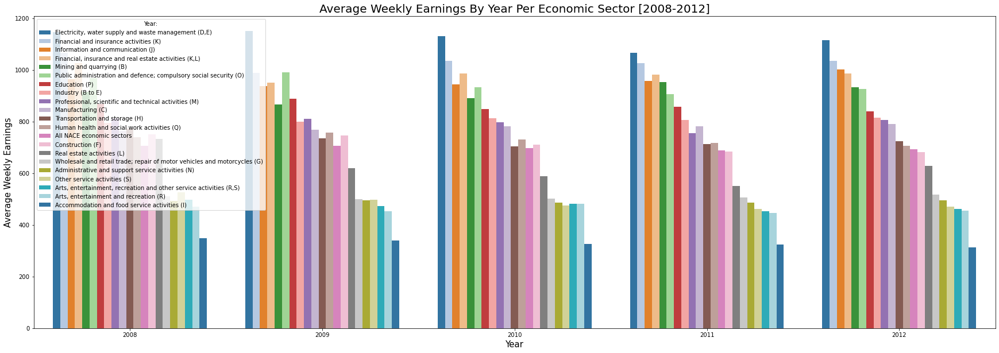

In [94]:
# Bar chart of the average weekly wage by economic sector from 2008 to 2012
f, ax = plt.subplots(1, 1, figsize=(30, 10))
ax =sns.barplot(x='Year', y='Weekly_Salary', hue='Economic_Sector', data=D, palette='tab20')

plt.title('Average Weekly Earnings By Year Per Economic Sector [2008-2012]', fontsize =20)
plt.ylabel("Average Weekly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Year:", loc='upper left', fontsize=10)

plt.savefig('barplot2.png', dpi=300, bbox_inches='tight');

The second bar graph shows the period that includes the years from 2013 to 2017

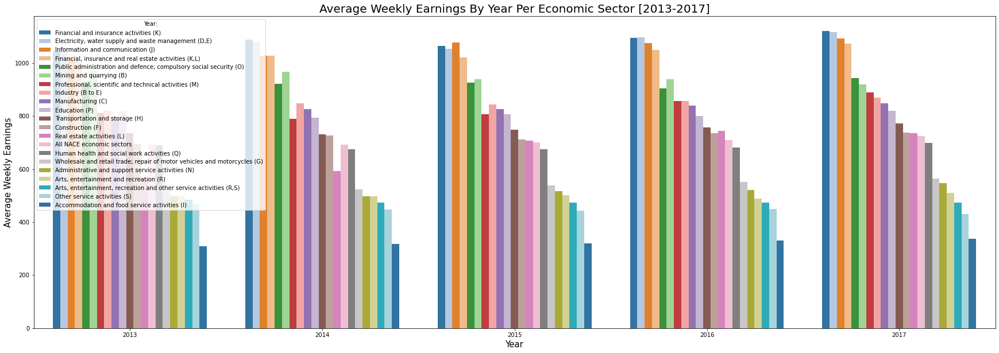

In [95]:
# Bar chart of the average weekly wage by economic sector from 2013 to 2017
f, ax = plt.subplots(1, 1, figsize=(30, 10))
ax =sns.barplot(x='Year', y='Weekly_Salary', hue='Economic_Sector', data=E, palette='tab20')

plt.title('Average Weekly Earnings By Year Per Economic Sector [2013-2017]', fontsize =20)
plt.ylabel("Average Weekly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Year:", loc='upper left', fontsize=10)

plt.savefig('barplot2.png', dpi=300, bbox_inches='tight');

And finally we make a bar graph that includes the years from 2018 to 2022.

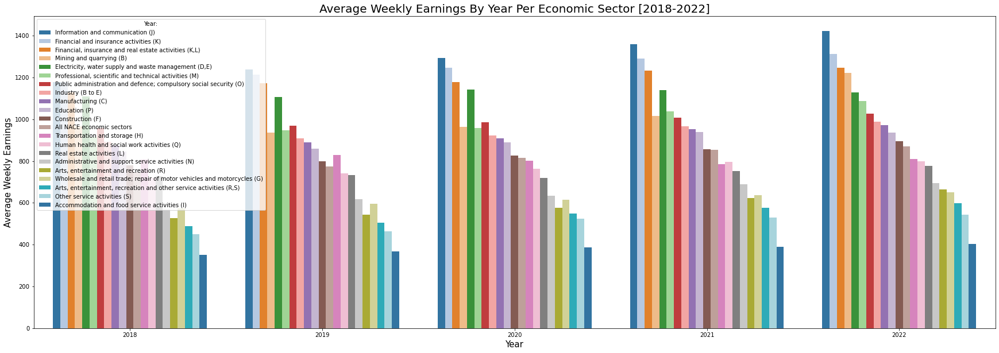

In [96]:
# Bar chart of the average weekly wage by economic sector from 2018 to 2022
f, ax = plt.subplots(1, 1, figsize=(30, 10))
ax =sns.barplot(x='Year', y='Weekly_Salary', hue='Economic_Sector', data=F, palette='tab20')

plt.title('Average Weekly Earnings By Year Per Economic Sector [2018-2022]', fontsize =20)
plt.ylabel("Average Weekly Earnings", fontsize =15)
plt.xlabel('Year', fontsize =15)


plt.legend(title = "Year:", loc='upper left', fontsize=10)

plt.savefig('barplot2.png', dpi=300, bbox_inches='tight');

# C. Employment

We create a new grouping for the `Employment` variable.

In [97]:
# select a subset of the dataframe with the chosen variable
print (grouped.get_group('Employment'))

       Statistic    Quarter  \
0     Employment 2008-01-01   
1     Employment 2008-01-01   
2     Employment 2008-01-01   
3     Employment 2008-01-01   
4     Employment 2008-01-01   
...          ...        ...   
4768  Employment 2022-01-01   
4772  Employment 2022-01-01   
4776  Employment 2022-01-01   
4780  Employment 2022-01-01   
4784  Employment 2022-01-01   

                             Economic Sector NACE Rev 2  \
0                             All NACE economic sectors   
1                             All NACE economic sectors   
2                             All NACE economic sectors   
3                             All NACE economic sectors   
4                              Mining and quarrying (B)   
...                                                 ...   
4768                       Other service activities (S)   
4772                                  Industry (B to E)   
4776  Electricity, water supply and waste management...   
4780  Financial, insurance and real e

We rename our new created group keeping the name of the variable to analyze: `Employment` and analyze the new subgroup created.

In [98]:
#Reviewing the Employment Subgroup
Employment = grouped.get_group('Employment')
Employment

,Statistic,Quarter,Economic Sector NACE Rev 2,Type of Employee,UNIT,VALUE,Day,Month,Year,Day of the week
0,Employment,2008-01-01,All NACE economic sectors,All employees,Number,1767200,1,Jan,2008,Tuesday
1,Employment,2008-01-01,All NACE economic sectors,"Managers, professionals and associated profess...",Number,549400,1,Jan,2008,Tuesday
2,Employment,2008-01-01,All NACE economic sectors,"Clerical, sales and service employees",Number,685300,1,Jan,2008,Tuesday
3,Employment,2008-01-01,All NACE economic sectors,"Production, transport, craft and other manual ...",Number,532600,1,Jan,2008,Tuesday
4,Employment,2008-01-01,Mining and quarrying (B),All employees,Number,7100,1,Jan,2008,Tuesday
...,...,...,...,...,...,...,...,...,...,...
4768,Employment,2022-01-01,Other service activities (S),All employees,Number,22300,1,Jan,2022,Saturday
4772,Employment,2022-01-01,Industry (B to E),All employees,Number,255100,1,Jan,2022,Saturday
4776,Employment,2022-01-01,"Electricity, water supply and waste management...",All employees,Number,18600,1,Jan,2022,Saturday
4780,Employment,2022-01-01,"Financial, insurance and real estate activitie...",All employees,Number,117700,1,Jan,2022,Saturday


We again create a new subset that groups only `All employees`.

In [99]:
# select a subset of the dataframe with the chosen columns
Employment = Employment.groupby('Type of Employee')
print (Employment.get_group('All employees'))

       Statistic    Quarter  \
0     Employment 2008-01-01   
4     Employment 2008-01-01   
8     Employment 2008-01-01   
12    Employment 2008-01-01   
16    Employment 2008-01-01   
...          ...        ...   
4768  Employment 2022-01-01   
4772  Employment 2022-01-01   
4776  Employment 2022-01-01   
4780  Employment 2022-01-01   
4784  Employment 2022-01-01   

                             Economic Sector NACE Rev 2 Type of Employee  \
0                             All NACE economic sectors    All employees   
4                              Mining and quarrying (B)    All employees   
8                                     Manufacturing (C)    All employees   
12                                     Construction (F)    All employees   
16    Wholesale and retail trade; repair of motor ve...    All employees   
...                                                 ...              ...   
4768                       Other service activities (S)    All employees   
4772               

We rename the subset as Employment and we will keep this database for our later analysis.

In [100]:
Employment = Employment.get_group('All employees')
Employment

,Statistic,Quarter,Economic Sector NACE Rev 2,Type of Employee,UNIT,VALUE,Day,Month,Year,Day of the week
0,Employment,2008-01-01,All NACE economic sectors,All employees,Number,1767200,1,Jan,2008,Tuesday
4,Employment,2008-01-01,Mining and quarrying (B),All employees,Number,7100,1,Jan,2008,Tuesday
8,Employment,2008-01-01,Manufacturing (C),All employees,Number,212900,1,Jan,2008,Tuesday
12,Employment,2008-01-01,Construction (F),All employees,Number,146700,1,Jan,2008,Tuesday
16,Employment,2008-01-01,Wholesale and retail trade; repair of motor ve...,All employees,Number,319000,1,Jan,2008,Tuesday
...,...,...,...,...,...,...,...,...,...,...
4768,Employment,2022-01-01,Other service activities (S),All employees,Number,22300,1,Jan,2022,Saturday
4772,Employment,2022-01-01,Industry (B to E),All employees,Number,255100,1,Jan,2022,Saturday
4776,Employment,2022-01-01,"Electricity, water supply and waste management...",All employees,Number,18600,1,Jan,2022,Saturday
4780,Employment,2022-01-01,"Financial, insurance and real estate activitie...",All employees,Number,117700,1,Jan,2022,Saturday


We rename the columns: `Quarter to Date`, `Economic Sector NACE Rev 2 to Economic_Sector` and `VALUE to Employees`.

In [101]:
#Renaming columns
Employment.rename(columns={'Quarter': 'Date', 'Economic Sector NACE Rev 2': 'Economic_Sector', 'VALUE': 'Employees' }, inplace=True)
Employment

,Statistic,Date,Economic_Sector,Type of Employee,UNIT,Employees,Day,Month,Year,Day of the week
0,Employment,2008-01-01,All NACE economic sectors,All employees,Number,1767200,1,Jan,2008,Tuesday
4,Employment,2008-01-01,Mining and quarrying (B),All employees,Number,7100,1,Jan,2008,Tuesday
8,Employment,2008-01-01,Manufacturing (C),All employees,Number,212900,1,Jan,2008,Tuesday
12,Employment,2008-01-01,Construction (F),All employees,Number,146700,1,Jan,2008,Tuesday
16,Employment,2008-01-01,Wholesale and retail trade; repair of motor ve...,All employees,Number,319000,1,Jan,2008,Tuesday
...,...,...,...,...,...,...,...,...,...,...
4768,Employment,2022-01-01,Other service activities (S),All employees,Number,22300,1,Jan,2022,Saturday
4772,Employment,2022-01-01,Industry (B to E),All employees,Number,255100,1,Jan,2022,Saturday
4776,Employment,2022-01-01,"Electricity, water supply and waste management...",All employees,Number,18600,1,Jan,2022,Saturday
4780,Employment,2022-01-01,"Financial, insurance and real estate activitie...",All employees,Number,117700,1,Jan,2022,Saturday


We remove unnecessary columns.

In [102]:
#Dropping unnecesary columns
Employment.drop(['Statistic','UNIT', 'Type of Employee'], axis=1, inplace=True)
Employment.head(0)

,Date,Economic_Sector,Employees,Day,Month,Year,Day of the week


# D. Average Weekly Paid Hours (Seasonally Adjusted)

We create a new grouping for the variable Average Weekly Paid Hours (Seasonally Adjusted).

And we rename our subset as `Paid_Hours`.

In [103]:
# select a subset of the dataframe with the chosen variable
Paid_Hours = grouped.get_group('Average Weekly Paid Hours (Seasonally Adjusted)')
Paid_Hours

,Statistic,Quarter,Economic Sector NACE Rev 2,Type of Employee,UNIT,VALUE,Day,Month,Year,Day of the week
57456,Average Weekly Paid Hours (Seasonally Adjusted),2008-01-01,All NACE economic sectors,All employees,Hours,32.9,1,Jan,2008,Tuesday
57460,Average Weekly Paid Hours (Seasonally Adjusted),2008-01-01,Mining and quarrying (B),All employees,Hours,44.1,1,Jan,2008,Tuesday
57464,Average Weekly Paid Hours (Seasonally Adjusted),2008-01-01,Manufacturing (C),All employees,Hours,38.3,1,Jan,2008,Tuesday
57468,Average Weekly Paid Hours (Seasonally Adjusted),2008-01-01,Construction (F),All employees,Hours,37.6,1,Jan,2008,Tuesday
57472,Average Weekly Paid Hours (Seasonally Adjusted),2008-01-01,Wholesale and retail trade; repair of motor ve...,All employees,Hours,31.4,1,Jan,2008,Tuesday
...,...,...,...,...,...,...,...,...,...,...
62224,Average Weekly Paid Hours (Seasonally Adjusted),2022-01-01,Other service activities (S),All employees,Hours,28.3,1,Jan,2022,Saturday
62228,Average Weekly Paid Hours (Seasonally Adjusted),2022-01-01,Industry (B to E),All employees,Hours,38.1,1,Jan,2022,Saturday
62232,Average Weekly Paid Hours (Seasonally Adjusted),2022-01-01,"Electricity, water supply and waste management...",All employees,Hours,36.7,1,Jan,2022,Saturday
62236,Average Weekly Paid Hours (Seasonally Adjusted),2022-01-01,"Financial, insurance and real estate activitie...",All employees,Hours,34.5,1,Jan,2022,Saturday


We rename the columns: `Quarter to Date`, `Economic Sector NACE Rev 2 to Economic_Sector` and `VALUE to Paid_Hours`.

In [104]:
#Renaming columns
Paid_Hours.rename(columns={'Quarter': 'Date', 'Economic Sector NACE Rev 2': 'Economic_Sector', 'VALUE': 'Paid_Hours' }, inplace=True)
Paid_Hours

,Statistic,Date,Economic_Sector,Type of Employee,UNIT,Paid_Hours,Day,Month,Year,Day of the week
57456,Average Weekly Paid Hours (Seasonally Adjusted),2008-01-01,All NACE economic sectors,All employees,Hours,32.9,1,Jan,2008,Tuesday
57460,Average Weekly Paid Hours (Seasonally Adjusted),2008-01-01,Mining and quarrying (B),All employees,Hours,44.1,1,Jan,2008,Tuesday
57464,Average Weekly Paid Hours (Seasonally Adjusted),2008-01-01,Manufacturing (C),All employees,Hours,38.3,1,Jan,2008,Tuesday
57468,Average Weekly Paid Hours (Seasonally Adjusted),2008-01-01,Construction (F),All employees,Hours,37.6,1,Jan,2008,Tuesday
57472,Average Weekly Paid Hours (Seasonally Adjusted),2008-01-01,Wholesale and retail trade; repair of motor ve...,All employees,Hours,31.4,1,Jan,2008,Tuesday
...,...,...,...,...,...,...,...,...,...,...
62224,Average Weekly Paid Hours (Seasonally Adjusted),2022-01-01,Other service activities (S),All employees,Hours,28.3,1,Jan,2022,Saturday
62228,Average Weekly Paid Hours (Seasonally Adjusted),2022-01-01,Industry (B to E),All employees,Hours,38.1,1,Jan,2022,Saturday
62232,Average Weekly Paid Hours (Seasonally Adjusted),2022-01-01,"Electricity, water supply and waste management...",All employees,Hours,36.7,1,Jan,2022,Saturday
62236,Average Weekly Paid Hours (Seasonally Adjusted),2022-01-01,"Financial, insurance and real estate activitie...",All employees,Hours,34.5,1,Jan,2022,Saturday


In [105]:
#Analysing the total frequency by Type of Employee
Paid_Hours['Type of Employee'].value_counts()

All employees    1197
Name: Type of Employee, dtype: int64

We remove unnecessary columns.

In [106]:
#Dropping unnecesary columns
Paid_Hours.drop(['Statistic','UNIT', 'Type of Employee'], axis=1, inplace=True)
Paid_Hours.head(0)

,Date,Economic_Sector,Paid_Hours,Day,Month,Year,Day of the week


# 4.2 Merging the subsets in a new database

In this section we will merge the previously created data subsets to create a new database

We will first merge the subsets of Weekly_Earnings, and Hourly_Earnings and name the new database `New_df`.

In [107]:
# Merging Weekly_Earnings and Hourly_Earnings
New_df = pd.merge(Weekly_Earnings, Hourly_Earnings)
New_df

,Date,Economic_Sector,Type of Employee,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary
0,2008-01-01,All NACE economic sectors,All employees,708.59,1,Jan,2008,Tuesday,21.36
1,2008-01-01,Mining and quarrying (B),All employees,970.42,1,Jan,2008,Tuesday,21.91
2,2008-01-01,Manufacturing (C),All employees,757.54,1,Jan,2008,Tuesday,19.71
3,2008-01-01,Construction (F),All employees,746.83,1,Jan,2008,Tuesday,19.66
4,2008-01-01,Wholesale and retail trade; repair of motor ve...,All employees,515.95,1,Jan,2008,Tuesday,16.29
...,...,...,...,...,...,...,...,...,...
1192,2022-01-01,Other service activities (S),All employees,542.44,1,Jan,2022,Saturday,19.40
1193,2022-01-01,Industry (B to E),All employees,987.96,1,Jan,2022,Saturday,26.29
1194,2022-01-01,"Electricity, water supply and waste management...",All employees,1129.46,1,Jan,2022,Saturday,31.50
1195,2022-01-01,"Financial, insurance and real estate activitie...",All employees,1245.83,1,Jan,2022,Saturday,35.98


As a second step we will merge our new database `(New_df)` with our `Employment` subset.

In [108]:
# Merging New_df and Employment
New_df = pd.merge(New_df, Employment)
New_df

,Date,Economic_Sector,Type of Employee,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees
0,2008-01-01,All NACE economic sectors,All employees,708.59,1,Jan,2008,Tuesday,21.36,1767200
1,2008-01-01,Mining and quarrying (B),All employees,970.42,1,Jan,2008,Tuesday,21.91,7100
2,2008-01-01,Manufacturing (C),All employees,757.54,1,Jan,2008,Tuesday,19.71,212900
3,2008-01-01,Construction (F),All employees,746.83,1,Jan,2008,Tuesday,19.66,146700
4,2008-01-01,Wholesale and retail trade; repair of motor ve...,All employees,515.95,1,Jan,2008,Tuesday,16.29,319000
...,...,...,...,...,...,...,...,...,...,...
1192,2022-01-01,Other service activities (S),All employees,542.44,1,Jan,2022,Saturday,19.40,22300
1193,2022-01-01,Industry (B to E),All employees,987.96,1,Jan,2022,Saturday,26.29,255100
1194,2022-01-01,"Electricity, water supply and waste management...",All employees,1129.46,1,Jan,2022,Saturday,31.50,18600
1195,2022-01-01,"Financial, insurance and real estate activitie...",All employees,1245.83,1,Jan,2022,Saturday,35.98,117700


Once we have merged our first three data subsets we will merge our last subset, `Paid Hours`, with our new database `(New_df)`.

In [109]:
# Merging New_df and Paid_Hours
New_df = pd.merge(New_df, Paid_Hours)
New_df

,Date,Economic_Sector,Type of Employee,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours
0,2008-01-01,All NACE economic sectors,All employees,708.59,1,Jan,2008,Tuesday,21.36,1767200,32.9
1,2008-01-01,Mining and quarrying (B),All employees,970.42,1,Jan,2008,Tuesday,21.91,7100,44.1
2,2008-01-01,Manufacturing (C),All employees,757.54,1,Jan,2008,Tuesday,19.71,212900,38.3
3,2008-01-01,Construction (F),All employees,746.83,1,Jan,2008,Tuesday,19.66,146700,37.6
4,2008-01-01,Wholesale and retail trade; repair of motor ve...,All employees,515.95,1,Jan,2008,Tuesday,16.29,319000,31.4
...,...,...,...,...,...,...,...,...,...,...,...
1192,2022-01-01,Other service activities (S),All employees,542.44,1,Jan,2022,Saturday,19.40,22300,28.3
1193,2022-01-01,Industry (B to E),All employees,987.96,1,Jan,2022,Saturday,26.29,255100,38.1
1194,2022-01-01,"Electricity, water supply and waste management...",All employees,1129.46,1,Jan,2022,Saturday,31.50,18600,36.7
1195,2022-01-01,"Financial, insurance and real estate activitie...",All employees,1245.83,1,Jan,2022,Saturday,35.98,117700,34.5


We removed our `Type of Employee` column.

In [110]:
#Dropping unnecesary columns
New_df.drop(['Type of Employee'], axis=1, inplace=True)
New_df.head(0)

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours


# 4.3 New Database Preparation

# A. Characterization of the New Dataset

We review the information in our new database.

In [111]:
#General report of our New Database
ProfileReport(New_df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [112]:
#Gettig some information about the New dataset
New_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1197 entries, 0 to 1196
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   Date             1197 non-null   datetime64[ns]
 1   Economic_Sector  1197 non-null   object        
 2   Weekly_Salary    1197 non-null   float64       
 3   Day              1197 non-null   int64         
 4   Month            1197 non-null   object        
 5   Year             1197 non-null   int64         
 6   Day of the week  1197 non-null   category      
 7   Hourly_Salary    1197 non-null   float64       
 8   Employees        1197 non-null   object        
 9   Paid_Hours       1197 non-null   object        
dtypes: category(1), datetime64[ns](1), float64(2), int64(2), object(4)
memory usage: 95.0+ KB


We can see that some of our columns show the wrong data type, so we will proceed to transform those columns into a new data type.

We transform the `Paid_Hours` column into a `numeric` variable.

In [113]:
#Transforming the column 'Paid_Hours' into a numerical variable
New_df['Paid_Hours'] = New_df['Paid_Hours'].astype(float)
New_df['Paid_Hours'].dtype 

dtype('float64')

We transform the `Employees` column into a numeric variable, to `integers` respectively.

In [114]:
#Transforming the column 'Employees' into a numerical variable
New_df['Employees'] = New_df['Employees'].astype(int)
New_df['Employees'].dtype  

dtype('int32')

We check if there is any missing data

In [115]:
#Checking missing values
New_df.isnull().values.any()

False

<AxesSubplot:>

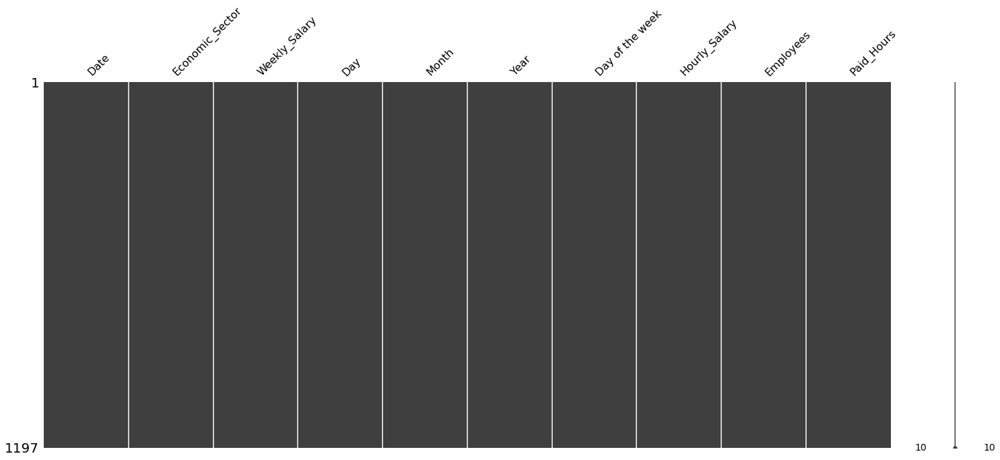

In [116]:
#Graphical visualisation of missing values through missingno
import missingno as msno
msno.matrix(New_df)

Analysing the missingno plot and we observe that our bars show a homogeneous distribution with no empty data.

Next we will analyze the presence of outliers, for this we will create a list with our numerical variables: `Weekly_Salary, Hourly_Salary, Employees and Paid_Hours`.

In [117]:
# Create a list for numerical columns that are to be visualized
Column_List = ['Weekly_Salary', 'Hourly_Salary', 'Employees', 'Paid_Hours']

We plot our box plot.

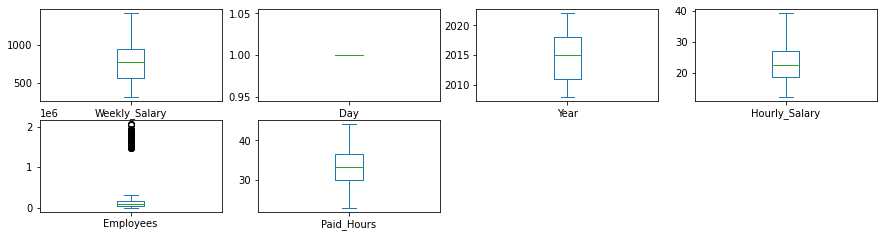

In [118]:
#Box plots dataset data set
New_df.plot(kind="box", subplots=True, figsize=(15,20), layout=(10,4))
plt.show()

Since the graph is a bit deficient to be able to visualize the presence of outliers more clearly, we will create a new graph of whisker plots

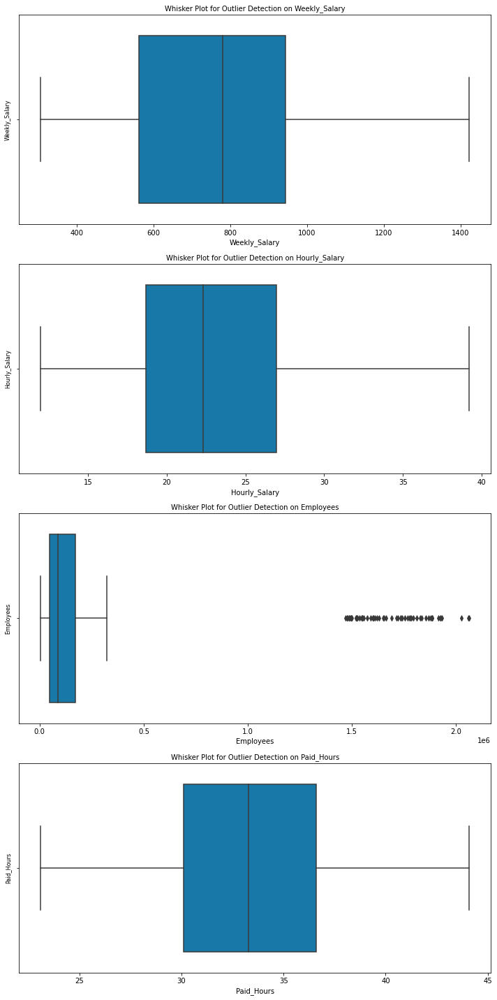

In [119]:
# Generate whisker plots to detect the presence of any outliers

fig, ax = plt.subplots (len(Column_List), figsize = (10, 20))

for i, col_list in enumerate(Column_List):
    sns.boxplot(New_df[col_list], ax = ax[i], palette = "winter", orient = 'h')
    ax[i].set_title("Whisker Plot for Outlier Detection on" + " " + col_list, fontsize = 10)
    ax[i].set_ylabel(col_list, fontsize = 8)
    fig.tight_layout(pad = 1.1);

We can see that our employee variable has a high number of outliers. However, since it is important to properly analyze each of our variables, we will keep our column with its outliers.

# B. Feature Encoding

In [120]:
# Feature Selection and Encoding libraries
from sklearn.svm import SVR
from sklearn.preprocessing import LabelEncoder, normalize
from sklearn.model_selection import train_test_split #training and testing data split

For this step, we select the categorical variables `Date`, `Economic_Sector`, `Day`, `Month`,`Year` and `Day of the week` for further encoding using `One-Hot encoding` applying the method of . `get_dummies()`. This strategy aims to convert each category value to a new column and assign a value of 1 or 0 to the column (Pathak, 2020); so it will help us not to weight a value incorrectly for future processing.

We rename our base with our encoded data as `Prediction`.

In [121]:
#Encoding our Database
Prediction = pd.get_dummies(New_df, columns=['Date','Economic_Sector', 'Day', 'Month', 'Year', 'Day of the week'], prefix = ['Date','Economic_Sector', 'Day', 'Month', 'Year', 'Day of the week'])
#Renaming our Database
Prediction.head()

,Weekly_Salary,Hourly_Salary,Employees,Paid_Hours,Date_2008-01-01 00:00:00,Date_2008-04-01 00:00:00,Date_2008-07-01 00:00:00,Date_2008-10-01 00:00:00,Date_2009-01-01 00:00:00,Date_2009-04-01 00:00:00,...,Year_2020,Year_2021,Year_2022,Day of the week_Monday,Day of the week_Tuesday,Day of the week_Wednesday,Day of the week_Thursday,Day of the week_Friday,Day of the week_Saturday,Day of the week_Sunday
0,708.59,21.36,1767200,32.9,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,970.42,21.91,7100,44.1,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
2,757.54,19.71,212900,38.3,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,746.83,19.66,146700,37.6,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4,515.95,16.29,319000,31.4,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0


# C. Data Transformation

In [122]:
#Showing the first rows of the DataFrame
Prediction.head()

,Weekly_Salary,Hourly_Salary,Employees,Paid_Hours,Date_2008-01-01 00:00:00,Date_2008-04-01 00:00:00,Date_2008-07-01 00:00:00,Date_2008-10-01 00:00:00,Date_2009-01-01 00:00:00,Date_2009-04-01 00:00:00,...,Year_2020,Year_2021,Year_2022,Day of the week_Monday,Day of the week_Tuesday,Day of the week_Wednesday,Day of the week_Thursday,Day of the week_Friday,Day of the week_Saturday,Day of the week_Sunday
0,708.59,21.36,1767200,32.9,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,970.42,21.91,7100,44.1,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
2,757.54,19.71,212900,38.3,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,746.83,19.66,146700,37.6,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4,515.95,16.29,319000,31.4,1,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0


Next we will build two new databases for further analysis, where we will only include average hourly wages with the rest of our variables, discarding our average weekly wages variable for our first base. In the second base we will focus on analyzing the average weekly wages, where we will discard only the average hourly wages.

We create our first database focusing on the analysis of `Average Hourly Wages` and we name it `Clustering_Hourly`.

In [123]:
#Building a base with a focus on Average Hourly Wages
Clustering_Hourly = Prediction.drop('Weekly_Salary', axis=1)
Clustering_Hourly.head()

,Hourly_Salary,Employees,Paid_Hours,Date_2008-01-01 00:00:00,Date_2008-04-01 00:00:00,Date_2008-07-01 00:00:00,Date_2008-10-01 00:00:00,Date_2009-01-01 00:00:00,Date_2009-04-01 00:00:00,Date_2009-07-01 00:00:00,...,Year_2020,Year_2021,Year_2022,Day of the week_Monday,Day of the week_Tuesday,Day of the week_Wednesday,Day of the week_Thursday,Day of the week_Friday,Day of the week_Saturday,Day of the week_Sunday
0,21.36,1767200,32.9,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,21.91,7100,44.1,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
2,19.71,212900,38.3,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,19.66,146700,37.6,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4,16.29,319000,31.4,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0


We create our database with a focus on `Average Weekly Wages` by discarding average hourly wages and name our new database as `Clustering_Weekly`.

In [124]:
#Building a base with a focus on Average Weekly Wages
Clustering_Weekly = Prediction.drop('Hourly_Salary', axis=1)
Clustering_Weekly.head()

,Weekly_Salary,Employees,Paid_Hours,Date_2008-01-01 00:00:00,Date_2008-04-01 00:00:00,Date_2008-07-01 00:00:00,Date_2008-10-01 00:00:00,Date_2009-01-01 00:00:00,Date_2009-04-01 00:00:00,Date_2009-07-01 00:00:00,...,Year_2020,Year_2021,Year_2022,Day of the week_Monday,Day of the week_Tuesday,Day of the week_Wednesday,Day of the week_Thursday,Day of the week_Friday,Day of the week_Saturday,Day of the week_Sunday
0,708.59,1767200,32.9,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,970.42,7100,44.1,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
2,757.54,212900,38.3,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,746.83,146700,37.6,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4,515.95,319000,31.4,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0


# D. Features Scaling

We will proceed to scale our data for further processing.

In [125]:
#Importing the scaling libraries
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, Normalizer
sc = StandardScaler()
mx = MinMaxScaler()
rs = RobustScaler()
nr = Normalizer()

During the scaling process, 4 different scaling methods were implemented, however, the `MinMaxScaler()` method was considered the most appropriate method for this analysis. This technique scales all data features in the range [0, 1] or in the range [-1, 1] if there are negative values in the data set. This scale compresses all internal values in the narrow range [0, 0.005].

We scale our base `Clustering Hourly`.

In [126]:
# Scaling our base Clustering_Hourly using MinMaxScaler
X = Clustering_Hourly
Clustering_Hourly = mx.fit_transform(Clustering_Hourly)
Clustering_Hourly = pd.DataFrame(Clustering_Hourly,columns=X.columns).set_index(X.index)

And likewise to our `Clustering Weekly` base.

In [127]:
# Scaling our base Clustering_Weekly using MinMaxScaler
X2 = Clustering_Weekly
Clustering_Weekly = mx.fit_transform(Clustering_Weekly)
Clustering_Weekly = pd.DataFrame(Clustering_Weekly,columns=X2.columns).set_index(X2.index)

# E. Data Reduction

Later we will implement the PCA method, so we need to see if it is possible to discard some variables necessary for our analysis.

We implement a correlation graph using Pearson's method in our Clustering_Hourly database.

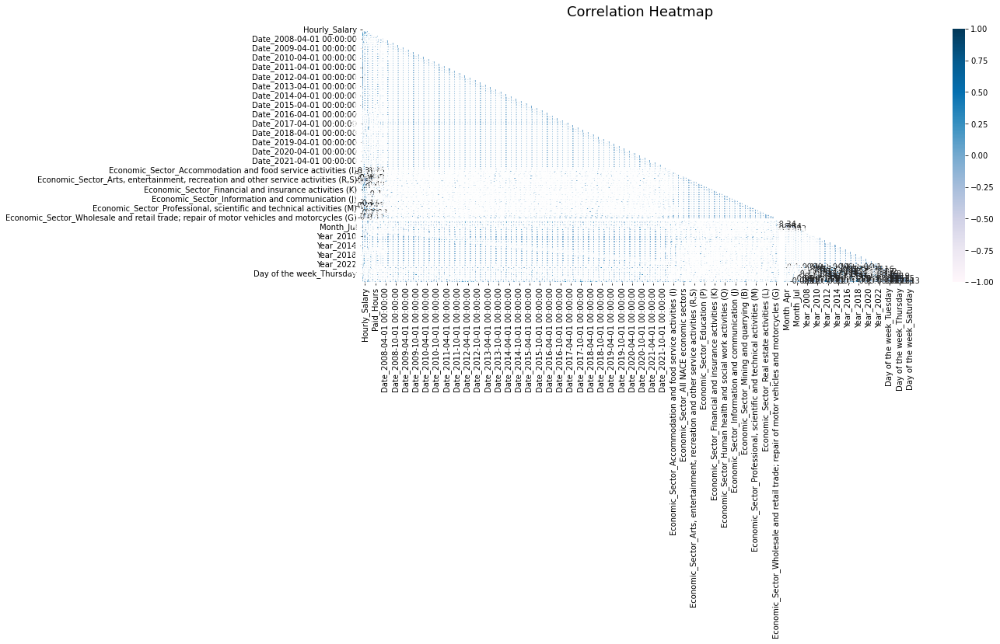

In [128]:
# Triangle Correlation Heatmap Clustering_Hourly
plt.figure(figsize=(16, 6))

mask = np.triu(np.ones_like(Clustering_Hourly.corr(method = "pearson"), dtype=np.bool))
heatmap = sns.heatmap(Clustering_Hourly.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='PuBu')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=16);
plt.savefig('correlationplot.png', dpi=300, bbox_inches='tight');

We check our correlation plot with Pearson's method for our Clustering Weekly database.

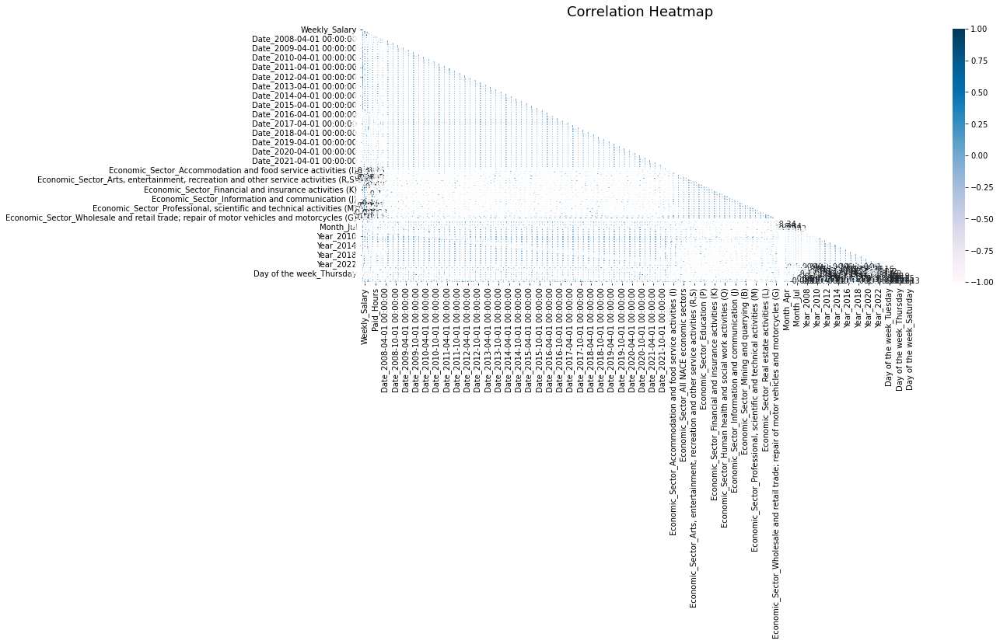

In [129]:
# Triangle Correlation Heatmap Clustering_Weekly
plt.figure(figsize=(16, 6))

mask = np.triu(np.ones_like(Clustering_Weekly.corr(method = "pearson"), dtype=np.bool))
heatmap = sns.heatmap(Clustering_Weekly.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='PuBu')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=16);
plt.savefig('correlationplot.png', dpi=300, bbox_inches='tight');

Given that the number of elements prevents us from carrying out a pertinent analysis, we will continue with the realization of our PCA keeping each one of the variables contained in our database.

# F. Principal Component Analysis (PCA)

Once we have transformed and prepared our database, we will proceed to implement the `PCA` method. This dimensionality reduction technique that can be used to reduce a large set of variables to a smaller set, thus retaining the largest percentage of the variance in the resulting set.

# a. Hourly Salary (PCA)

For the implementation of our PCA technique we will use a total of 2 components in each of our bases.

We apply `PCA` on our `Clustering Hourly` base and rename it as `projected_Hourly`.

In [130]:
# Define transform
pca = PCA(n_components=2)

#Apply transform to dataset Clustering Hourly
projected_Hourly = pca.fit_transform(Clustering_Hourly)

We reviewed the size of our new projected base.

In [131]:
#Reviewing the size of PCA with two components
projected_Hourly.shape

(1197, 2)

In order to transform it back to a data frame we will proceed to create a new data set that is equal to our projected data set, and we will rename the components with a new name, in this case `PCA_Feature_1` and `PCA_Feature_2` (Müller and Guido, 2017; McQuaid, 2021b).

In [132]:
#Renaming the new components
pca_Hourly = pd.DataFrame(projected_Hourly, columns =['PCA_Feature_1', 'PCA_Feature_2'])

We use the `.head` function and we can see the content of the new features created based on our `PCA` algorithm.

In [133]:
#Displaying the first 5 rows of new features
pca_Hourly.head()

,PCA_Feature_1,PCA_Feature_2
0,0.952430,-0.223705
1,0.953939,-0.224870
2,0.953160,-0.225352
3,0.953054,-0.225480
4,0.952086,-0.226382


In [134]:
# Display an array of only two columns
Hourly_array = pca_Hourly.values
print(Hourly_array)

[[ 0.95243037 -0.22370526]
 [ 0.95393861 -0.22487006]
 [ 0.95315964 -0.22535177]
 ...
 [ 0.97771426 -0.05224306]
 [ 0.9776805  -0.05048378]
 [ 0.97602334 -0.05619155]]


# b. Weekly Salary (PCA)

In the same way as in the previous implementation, we will keep 2 analysis components for our PCA applied in our base of average weekly wages.

In [135]:
# define transform
pca = PCA(n_components=2)

# apply transform to dataset Clustering Weekly
projected_Weekly = pca.fit_transform(Clustering_Weekly)

In [136]:
#Reviewing the size of PCA with two components
projected_Weekly.shape

(1197, 2)

We rename the new components and create a new dataframe.

In [137]:
#Renaming the new components
pca_Weekly = pd.DataFrame(projected_Weekly, columns =['PCA_Feature_1', 'PCA_Feature_2'])

We unfold our first rows of our newly created features.

In [138]:
#Displaying the first 5 rows of new features
pca_Weekly.head()

,PCA_Feature_1,PCA_Feature_2
0,0.952317,-0.223646
1,0.954641,-0.222447
2,0.953386,-0.223821
3,0.953220,-0.224013
4,0.951749,-0.225618


In [139]:
# Display an array of only two columns
Weekly_array = pca_Weekly.values
print(Weekly_array)

[[ 0.95231684 -0.22364594]
 [ 0.95464052 -0.22244681]
 [ 0.9533861  -0.22382123]
 ...
 [ 0.97825661 -0.052636  ]
 [ 0.97816128 -0.05185101]
 [ 0.97563992 -0.0567938 ]]


# 5. Clustering Models

part of the objectives of this analysis is the appropriate segmentation of `wages per hour` and `wages per week` with respect to economic sectors; Therefore, for the analysis of our database, the unsupervised clustering models of `K-Means`, `Agglomerative Hierarchical Clustering` and `Fuzzy C-Means` will be implemented, which are ideal for working with unlabeled data.

# 5.1 Clustering Hourly Analysis

Next we will proceed to implement our 3 clustering models for our analysis of `average hourly wages`.

# A1. K-Means

As a first clustering model we will implement the `K-Means` model.

To determine the correct value of k we will implement the `Elbow`, `Calinski-Harabasz Index` and `Davies-Bouldin Index` methods.

In [140]:
# Defining Elbow Curve

def find_clusters(data, start=1, end=11):
    """
    data: array like
    """
    inertias = []

    for i in range(start,end):
        kmeans = KMeans(n_clusters=i)
        kmeans.fit(X)
        inertias.append(kmeans.inertia_)

    plt.figure(figsize=(20,10))
    plt.plot(np.arange(start,end), np.array(inertias), color='orange', marker='o')
    plt.xlabel('No. of clusters')
    plt.ylabel('Inertia')
    plt.title("Elbow Curve", fontsize=16)
    plt.show()

We plot our `Elbow method` and make sure what is the optimal number for k.

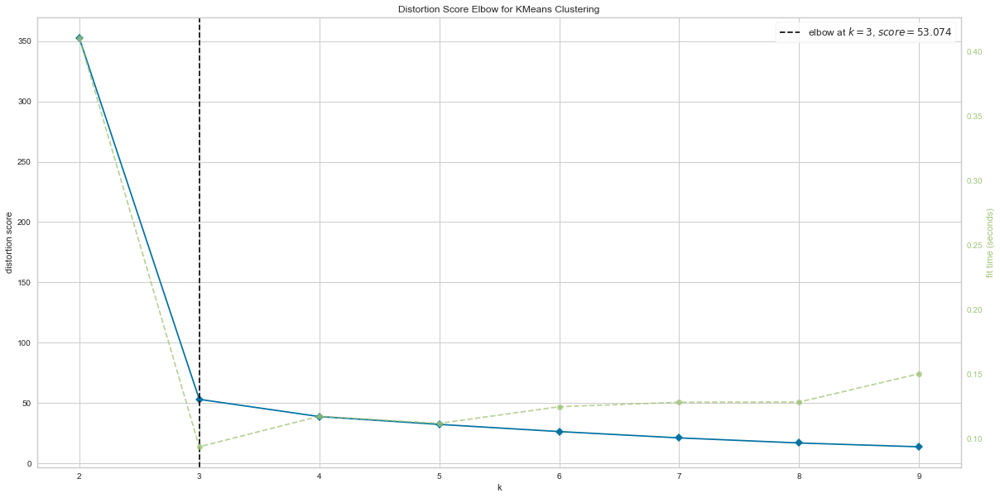

In [141]:
# Plotting Elbow method
from yellowbrick.cluster import KElbowVisualizer
#
X = Hourly_array
# Instantiate the clustering model and visualizer
#
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,10))
plt.figure(figsize=(20,10)) 
visualizer.fit(X)        # Fit the data to the visualizer
plt.savefig('Elbow_Hourly.png', dpi=300, bbox_inches='tight')
visualizer.show();        # Finalize and render the figure

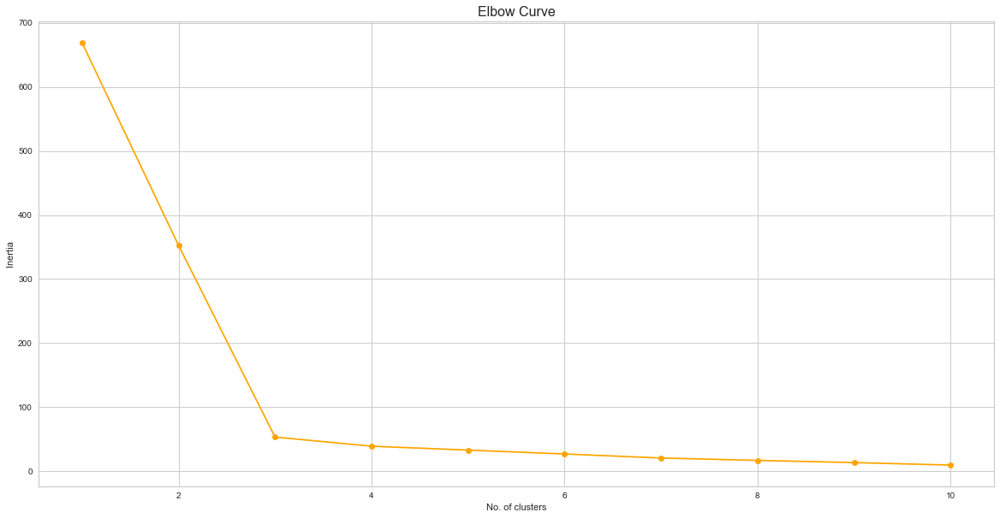

In [142]:
#Fitting Elbow Curve
X = Hourly_array

find_clusters(X)

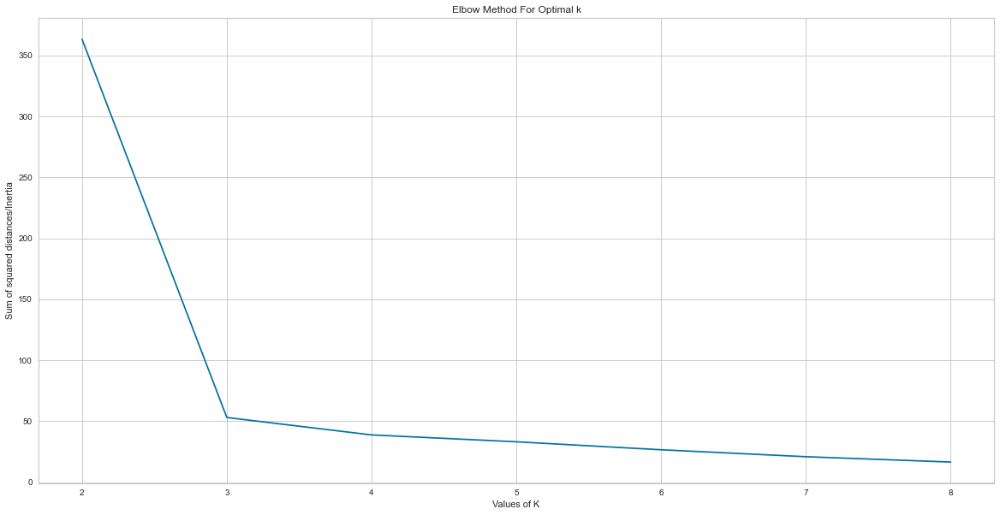

In [143]:
# Plotting Elbow method
Sum_of_squared_distances = []
K = range(2,9)
for num_clusters in K :
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(Hourly_array)
    Sum_of_squared_distances.append(kmeans.inertia_)

plt.figure(figsize=(20,10))
plt.plot(K,Sum_of_squared_distances,'x-')
plt.xlabel('Values of K')
plt.ylabel('Sum of squared distances/Inertia')
plt.title('Elbow Method For Optimal k')
plt.show()

We obtain as a result an optimal value of `3`.

In [144]:
# Defining the K-Means model
def draw_optimal_clusters(data, n_clusters=3, xlabel=None, ylabel=None, title=None):
    
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(data)
    
    y_means = kmeans.predict(X)
    centers = kmeans.cluster_centers_
   
    plt.figure(figsize=(20,10))
    plt.scatter(X[y_means==0, 0], X[y_means==0, 1], color='lightblue', label='Cluster 0')
    plt.scatter(X[y_means==1, 0], X[y_means==1, 1], color='orange', label='Cluster 1')
    plt.scatter(X[y_means==2, 0], X[y_means==2, 1], color='turquoise', label='Cluster 2')
    #plt.scatter(X[y_means==3, 0], X[y_means==3, 1], color='lightcoral', label='Cluster 3')
    #plt.scatter(X[y_means==4, 0], X[y_means==4, 1], color='orchid', label='Cluster 4')
     
    plt.scatter(centers[:,0], centers[:,1], s=100, label='Centers')

    
    plt.legend()
   
    plt.title(title, fontsize = 20)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

We graph `Silhouette score`.

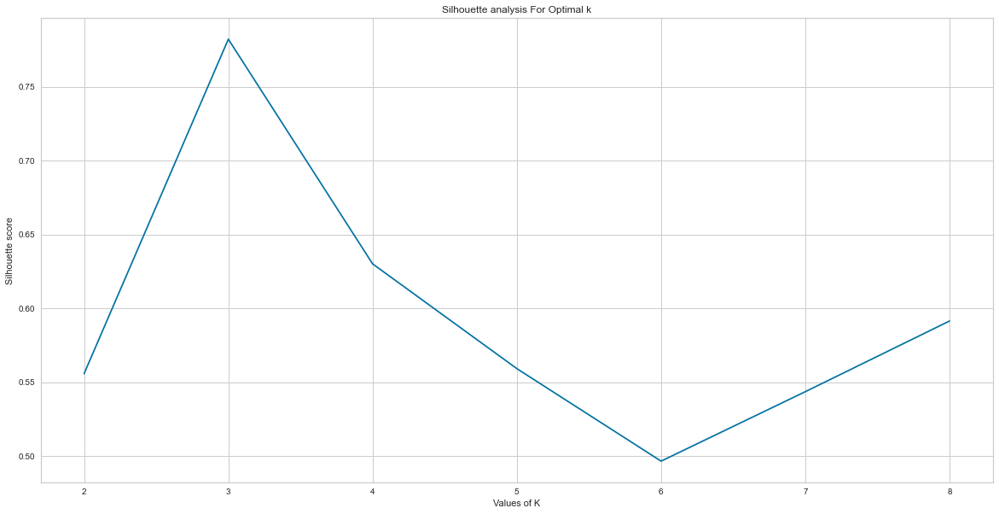

In [145]:
# Graphing Silhouette score

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
silhouette_avg = []
for num_clusters in range_n_clusters:
    # initialise kmeans
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(Hourly_array)
    cluster_labels = kmeans.labels_
    # silhouette score
    silhouette_avg.append(silhouette_score(Hourly_array, cluster_labels))

plt.figure(figsize=(20,10))
plt.plot(range_n_clusters,silhouette_avg,'x-')
plt.xlabel('Values of K')
plt.ylabel('Silhouette score')
plt.title('Silhouette analysis For Optimal k')
plt.show()

We obtain as optimal value `3`.

We plot the Calinski-Harabasz index and check the corresponding optimal value.

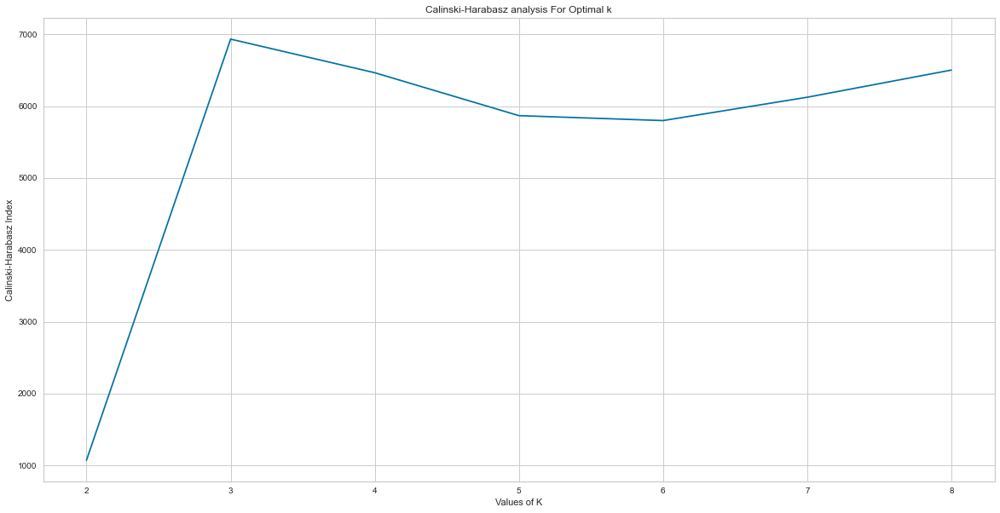

In [146]:
# Defining the graph of Calinski-Harabasz Index
range_n_clusters = range(2,9)
calinski_harabasz_avg = []
for num_clusters in range_n_clusters:
    # initialise kmeans
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(Hourly_array)
    cluster_labels = kmeans.labels_
    # silhouette score
    calinski_harabasz_avg.append(calinski_harabasz_score(Hourly_array, cluster_labels))

plt.figure(figsize=(20,10))
plt.plot(range_n_clusters,calinski_harabasz_avg,'x-')
plt.xlabel('Values of K')
plt.ylabel('Calinski-Harabasz Index')
plt.title('Calinski-Harabasz analysis For Optimal k')
plt.show()

And we get again a value of `3`.

We implement the Davies-Bouldin index and corroborate the result.

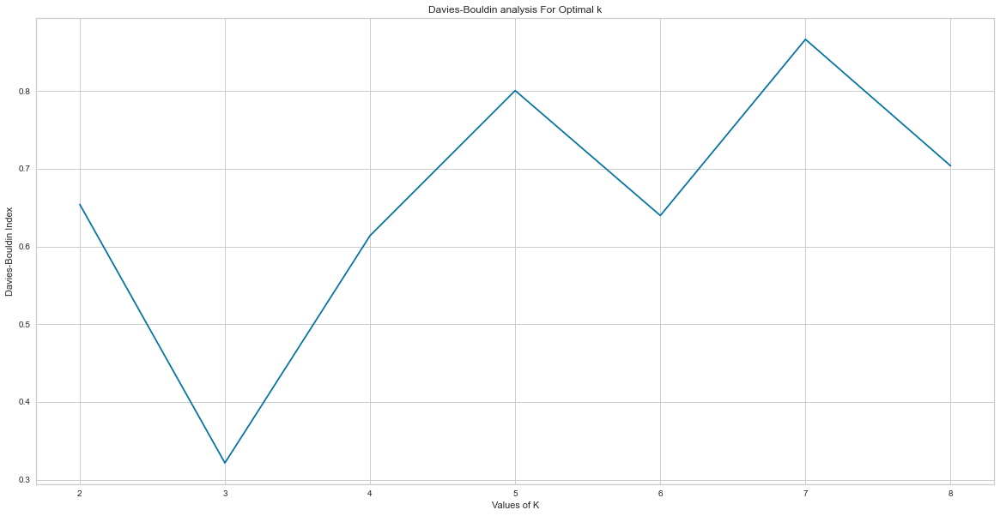

In [147]:
# Defining Davies-Bouldin Index Plot
range_n_clusters = range(2,9)
avies_bouldin_avg = []
for num_clusters in range_n_clusters:
    # initialise kmeans
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(Hourly_array)
    cluster_labels = kmeans.labels_
    # silhouette score
    avies_bouldin_avg.append(davies_bouldin_score(Hourly_array, cluster_labels))

plt.figure(figsize=(20,10))
plt.plot(range_n_clusters,avies_bouldin_avg,'x-')
plt.xlabel('Values of K')
plt.ylabel('Davies-Bouldin Index')
plt.title('Davies-Bouldin analysis For Optimal k')
plt.show()

When analyzing all our methods to define our optimal value of `k`, we can agree that the ideal value to segment our data corresponds to `3`.

Next we will go on to implement our K-Means model for a total of 3 clusters.

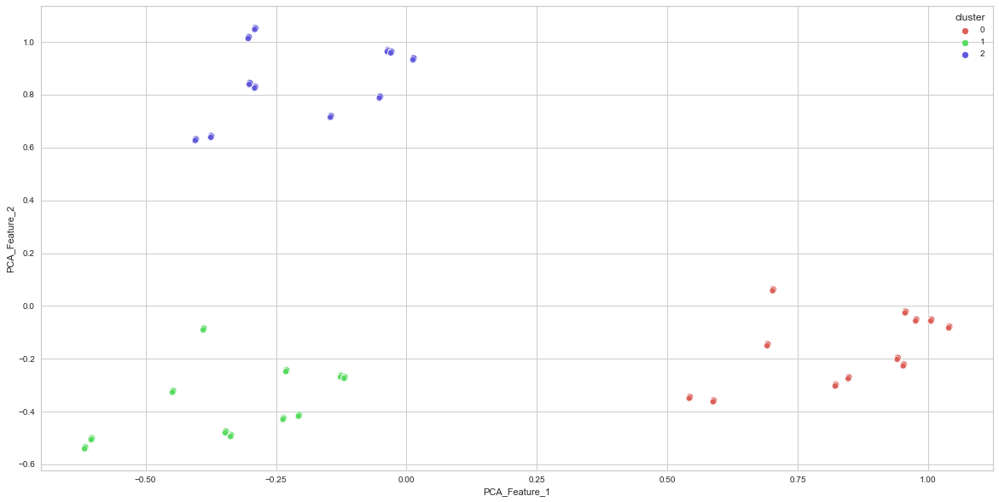

In [148]:
# Implementing K-Means with 3 clusters
clusters=3 #from above analysis for optimal value of k
kmeans = KMeans(n_clusters=clusters, init='k-means++')
kmeans.fit(Hourly_array)
pred = kmeans.predict(Hourly_array)
data = pd.DataFrame(Hourly_array, columns = ['PCA_Feature_1','PCA_Feature_2']) # features selected by using PCA
data['cluster'] = pred

# Plot Showing Clusters using features [2] selected from PCA
plt.figure(figsize=(20,10))
sns.scatterplot(data=data, x=data.PCA_Feature_1, y=data.PCA_Feature_2, hue='cluster', palette=sns.color_palette("hls",clusters), legend="full")
plt.show()

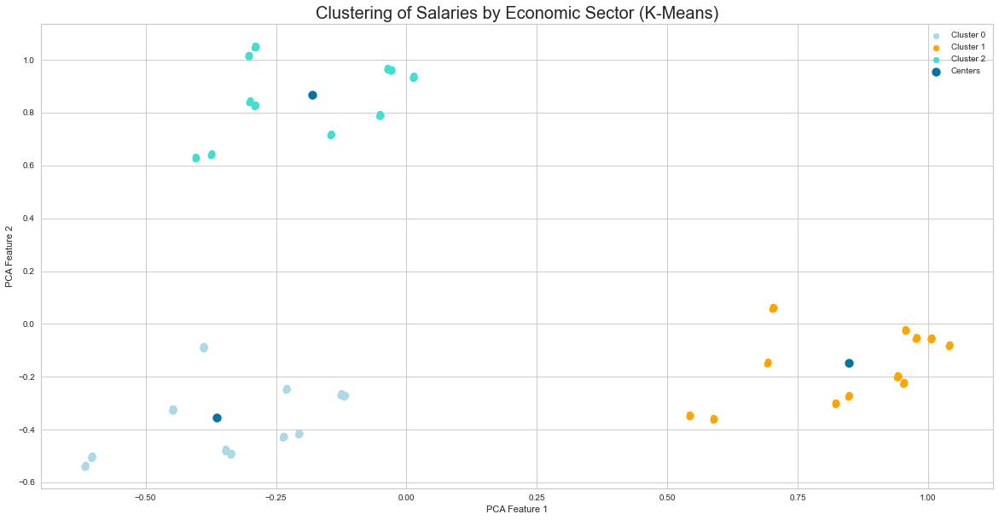

In [149]:
# Implementing K-Means with 3 clusters
draw_optimal_clusters(X,n_clusters=3, xlabel="PCA Feature 1", 
                      ylabel="PCA Feature 2", 
                      title="Clustering of Salaries by Economic Sector (K-Means)")

We can observe a good definition of our groupings.

We add a new column to our database that contains all of our analysis variables. Our new column will correspond to our segmentation result of hourly wages with respect to the K-Means model.

In [150]:
#Adding a new column with the result of the segmentation of hourly wages with respect to K-Means
New_df['KMeans_Hourly'] = pred
Kmeans = New_df.sort_values(by = 'KMeans_Hourly', ignore_index=True)
Kmeans.head()

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly
0,2008-01-01,All NACE economic sectors,708.59,1,Jan,2008,Tuesday,21.36,1767200,32.9,0
1,2015-01-01,Information and communication (J),1069.67,1,Jan,2015,Thursday,29.53,61300,36.3,0
2,2015-01-01,Accommodation and food service activities (I),319.72,1,Jan,2015,Thursday,12.26,143100,26.0,0
3,2015-01-01,Transportation and storage (H),747.20,1,Jan,2015,Thursday,20.46,63400,36.5,0
4,2015-01-01,Wholesale and retail trade; repair of motor ve...,536.22,1,Jan,2015,Thursday,17.58,281400,30.5,0


We check the corresponding Silhouette score and obtain a value close to 1.

In [151]:
# Analyzing the Silhouette Score for 3 clusters
X = Hourly_array
kmeans = KMeans(n_clusters=3)
kmeans.fit(X)
y_means = kmeans.predict(X)
    
score_kmeans = silhouette_score(X, y_means)
score_kmeans

0.7822342909989097

Next, we will analyze different segmentations, from 2 clusters to 6. In the same way, we will be able to observe their corresponding values with respect to the Silhouette Score.

For n_clusters = 2 The average silhouette_score is : 0.5559254658249427
For n_clusters = 3 The average silhouette_score is : 0.7822342909989097
For n_clusters = 4 The average silhouette_score is : 0.6302485435474878
For n_clusters = 5 The average silhouette_score is : 0.5612432277990987
For n_clusters = 6 The average silhouette_score is : 0.6273882447016971


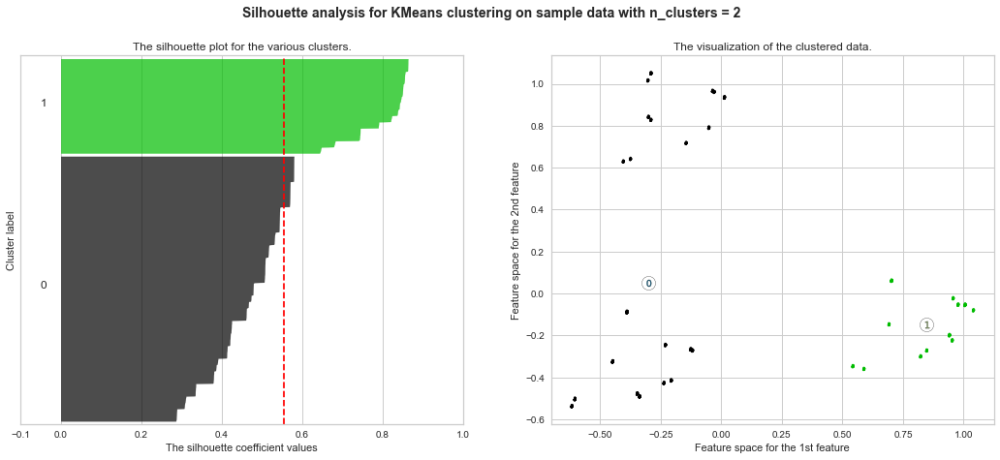

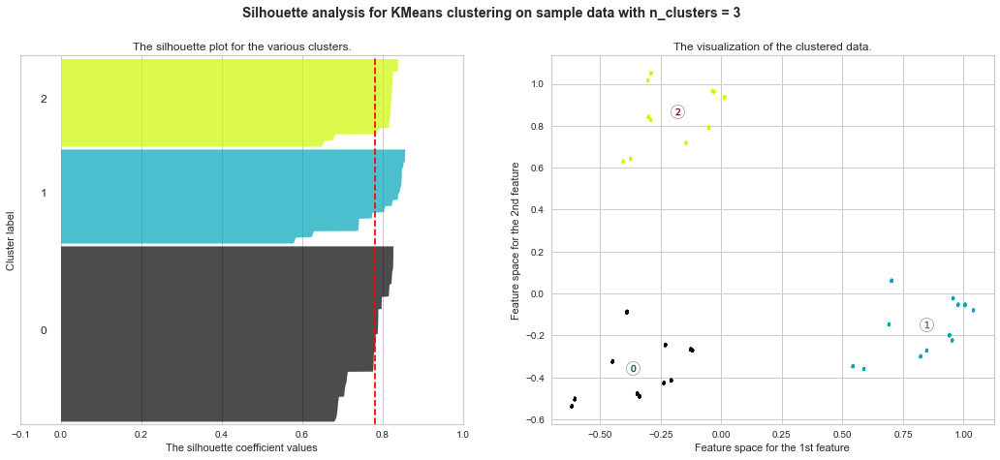

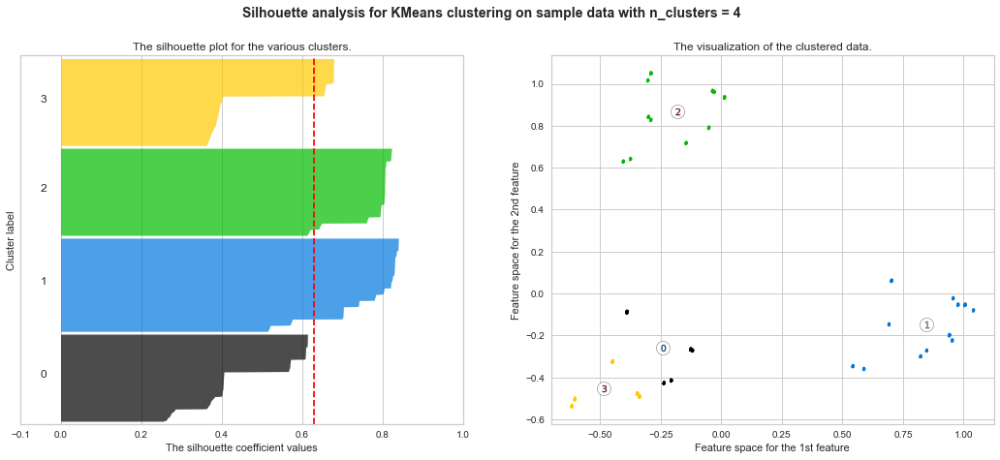

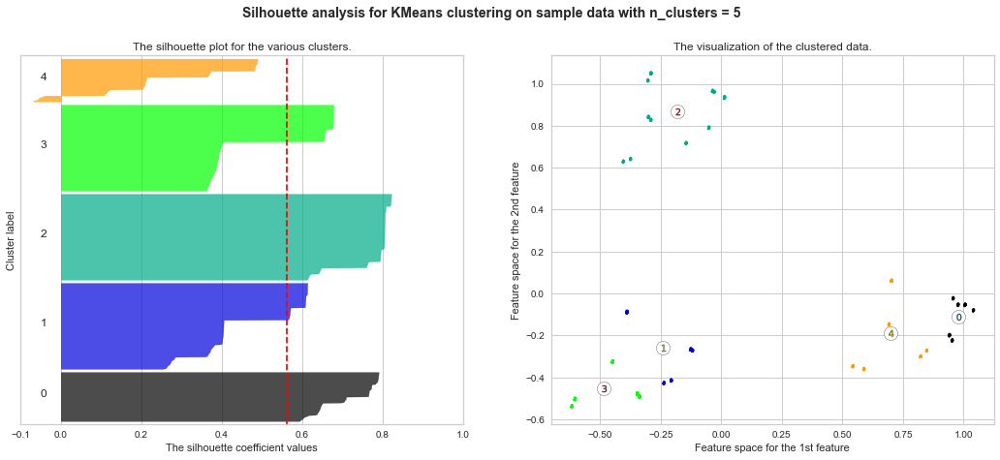

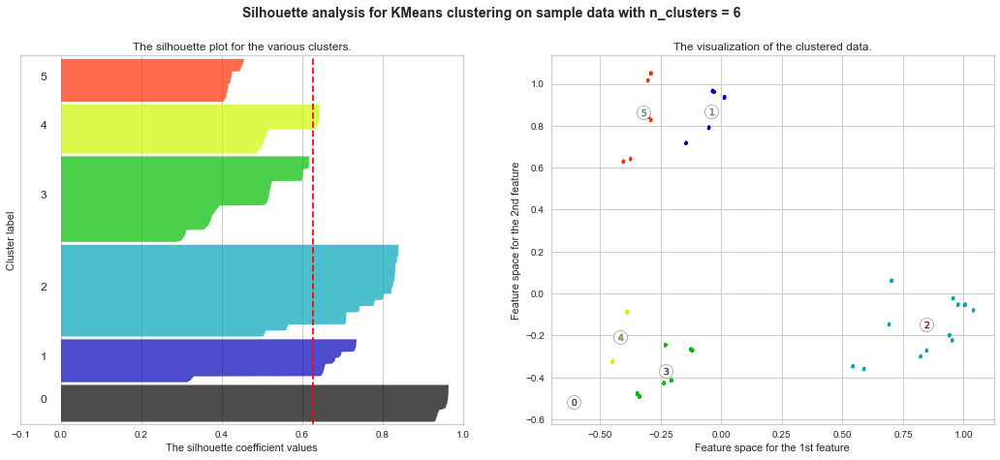

In [152]:
X = Hourly_array

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )
plt.savefig('silhouette_Hourly.png', dpi=300, bbox_inches='tight')
plt.show()


With the previous results we can verify that the best segmentation corresponds to a total of 3 clusters for the K-Means model.

# B1. Agglomerative Hierarchical Clustering

Next, we will analyze Agglomerative Hierarchical Clusterin model.

In [153]:
# Defining the Agglomerative Hierarchical Clustering model
def draw_optimal_agglo(data, n_clusters=3, affinity = 'euclidean', linkage = 'ward', xlabel=None, ylabel=None, title=None):

    agglo_c = AgglomerativeClustering(n_clusters=n_clusters,
                                       affinity='euclidean',
                                       linkage='ward')
    

    y_agglo = agglo_c.fit_predict(X)
    
#Defining the centers based on the k-means model
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(data)
    y_means = kmeans.predict(X)
    centers = kmeans.cluster_centers_
   
    plt.figure(figsize=(20,10))
    plt.scatter(X[y_agglo==0, 0], X[y_agglo==0, 1], color='lightblue', label='Cluster 0')
    plt.scatter(X[y_agglo==1, 0], X[y_agglo==1, 1], color='orange', label='Cluster 1')
    plt.scatter(X[y_agglo==2, 0], X[y_agglo==2, 1], color='turquoise', label='Cluster 2')
    #plt.scatter(X[y_agglo==3, 0], X[y_agglo==3, 1], color='lightcoral', label='Cluster 3')
    #plt.scatter(X[y_agglo==4, 0], X[y_agglo==4, 1], color='orchid', label='Cluster 4')
    
 
    plt.scatter(centers[:,0], centers[:,1], s=100, label='Centers')
 

    plt.legend()

    plt.title(title, fontsize = 20)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

In [154]:
# 1 means Informational Duration and 2 means Bounce Rate
X = Hourly_array

# Display an array of only two columns
print(X)

[[ 0.95243037 -0.22370526]
 [ 0.95393861 -0.22487006]
 [ 0.95315964 -0.22535177]
 ...
 [ 0.97771426 -0.05224306]
 [ 0.9776805  -0.05048378]
 [ 0.97602334 -0.05619155]]


We implement a dendrogram plot using the Ward method to analyze the possible number of clusters.

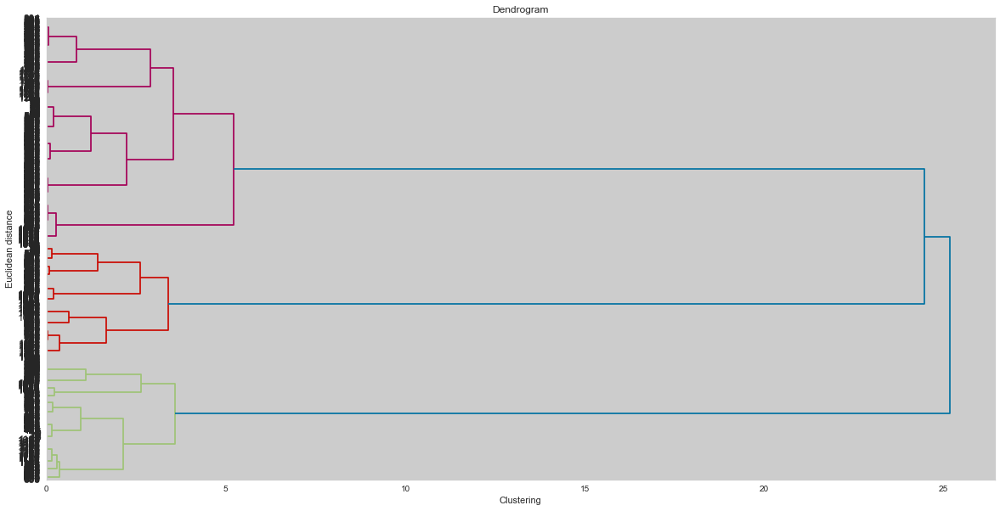

In [155]:
#Size of the figure
plt.figure(figsize = (20, 10))

#Call the method dendrogram by using an object sch
dendrogrm = sch.dendrogram(sch.linkage(X, method = 'ward'), leaf_rotation=0, leaf_font_size=12, orientation='right')

plt.title('Dendrogram')
plt.xlabel('Clustering')
plt.ylabel('Euclidean distance')
plt.savefig('Dendogram_Hourly.png', dpi=300, bbox_inches='tight')
plt.show()


We define the Elbow method to select the optimal value of clusters to apply.

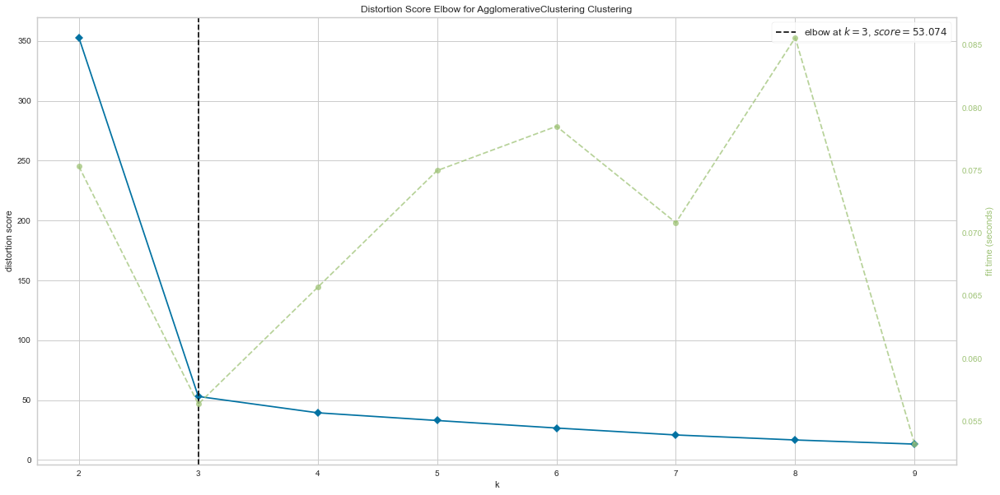

In [156]:
# Defining Elbow method
X = Hourly_array
# Instantiate the clustering model and visualizer
#
AC = AgglomerativeClustering(n_clusters= clusters, affinity='euclidean', linkage='ward')
visualizer = KElbowVisualizer(AC, k=(2,10))
plt.figure(figsize=(20,10)) 
visualizer.fit(X)        # Fit the data to the visualizer
plt.savefig('Elbow_Hourly.png', dpi=300, bbox_inches='tight')
visualizer.show();        # Finalize and render the figure

We define 3 as the optimal value of k.

We implement a segmentation of 3 clusters for the present algorithm

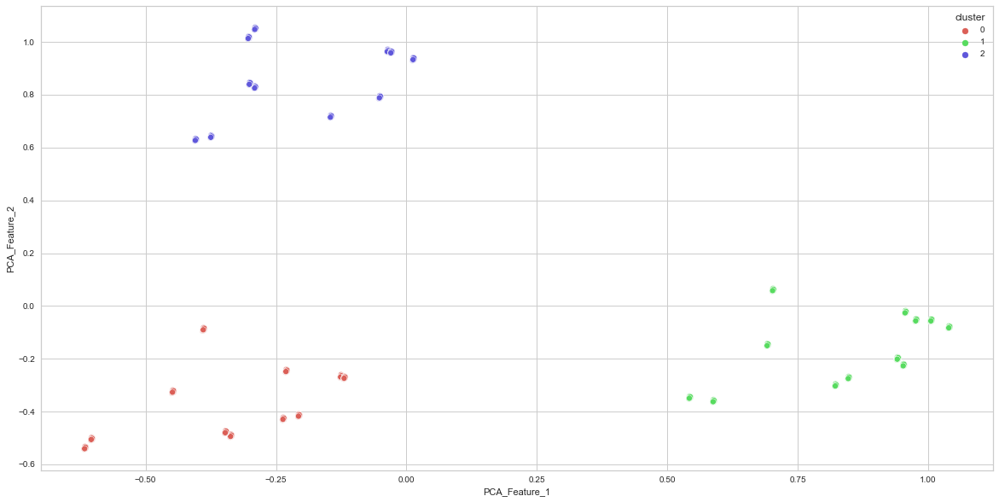

In [157]:
# Implementing Agglomerative Hierarchical Clustering with 3 clusters
clusters=3 #from above analysis for optimal value of k
agglo_c = AgglomerativeClustering(n_clusters=clusters, affinity='euclidean', linkage='ward')
agglo_c.fit(Hourly_array)
pred = agglo_c.fit_predict(Hourly_array)

data = pd.DataFrame(Hourly_array, columns = ['PCA_Feature_1','PCA_Feature_2']) # features selected by using PCA
data['cluster'] = pred

# Plot Showing Clusters using features [2] selected from PCA
plt.figure(figsize=(20,10))
sns.scatterplot(data=data, x=data.PCA_Feature_1, y=data.PCA_Feature_2, hue='cluster', palette=sns.color_palette("hls",clusters), legend="full")
plt.show()

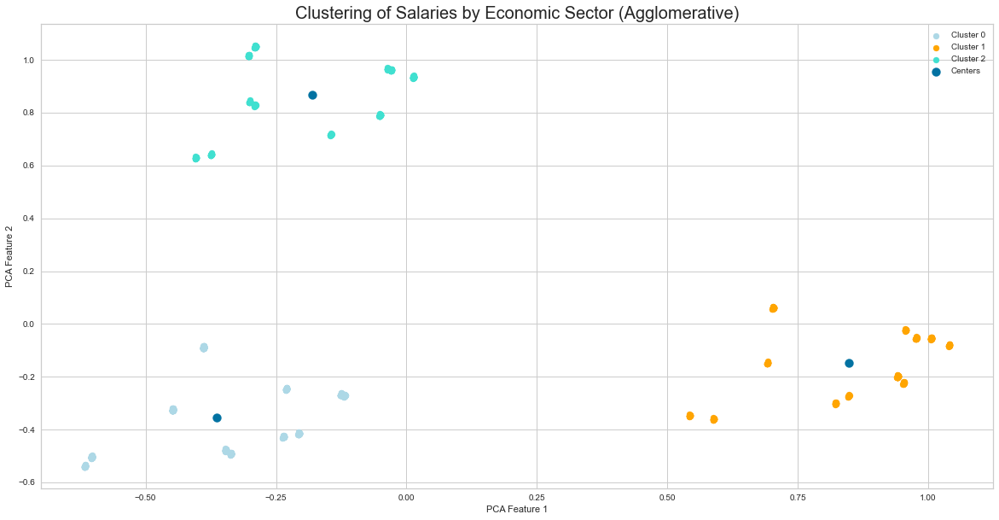

In [158]:
# Implementing Agglomerative Hierarchical Clustering with 3 clusters
X = Hourly_array
draw_optimal_agglo(X, n_clusters=3, xlabel="PCA Feature 1", 
                      ylabel="PCA Feature 2", 
                      title="Clustering of Salaries by Economic Sector (Agglomerative)")

And we get a perfect segmentation of our data

We create a new column with our segmented data and create a new database.

In [159]:
#Adding a new column with the result of the segmentation of hourly wages with respect to Agglomerative
Kmeans['HAC_Hourly'] = pred
Agglomerative = Kmeans.sort_values(by = 'HAC_Hourly', ignore_index=True)
Agglomerative.head()

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly
0,2014-04-01,Transportation and storage (H),742.93,1,Apr,2014,Tuesday,21.04,62300,35.3,1,0
1,2008-07-01,Education (P),847.19,1,Jul,2008,Tuesday,35.03,128900,24.6,1,0
2,2008-07-01,Human health and social work activities (Q),727.95,1,Jul,2008,Tuesday,23.84,208100,30.6,1,0
3,2008-07-01,"Arts, entertainment and recreation (R)",482.42,1,Jul,2008,Tuesday,16.18,29100,30.0,1,0
4,2008-07-01,Other service activities (S),531.36,1,Jul,2008,Tuesday,16.97,24100,31.3,1,0


We analyze the silhouette score. And we get a high value, close to 1.

In [160]:
# Analyzing the Silhouette Score for 3 clusters
X = Hourly_array
agglo_c = AgglomerativeClustering(n_clusters=3,
                                       affinity='euclidean',
                                       linkage='ward')
    

y_agglo = agglo_c.fit_predict(X)
    
score_Agglo = silhouette_score(X, y_agglo)
score_Agglo

0.7822342909989097

We analyze different segmentations with their respective evaluations.

For n_clusters = 2 The average silhouette_score is : 0.5559254658249427
For n_clusters = 3 The average silhouette_score is : 0.7822342909989097
For n_clusters = 4 The average silhouette_score is : 0.6560387479365101
For n_clusters = 5 The average silhouette_score is : 0.5950135249146987
For n_clusters = 6 The average silhouette_score is : 0.6113196303504528


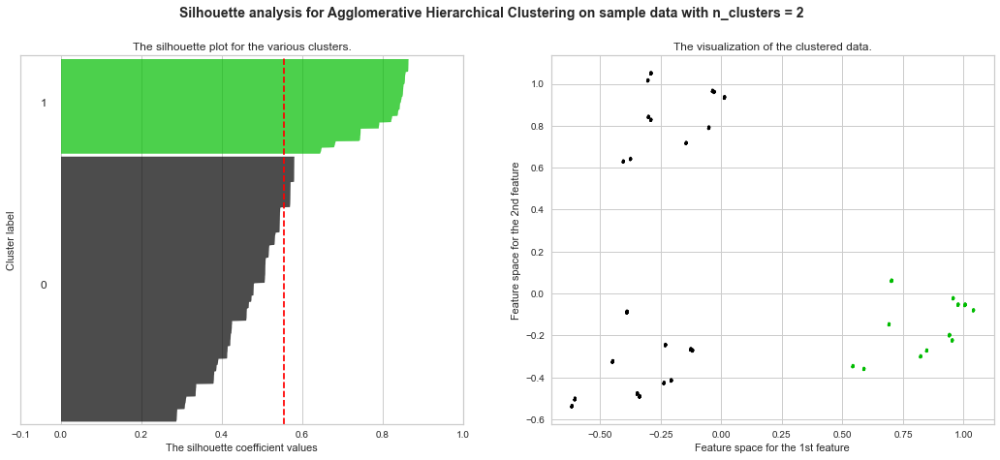

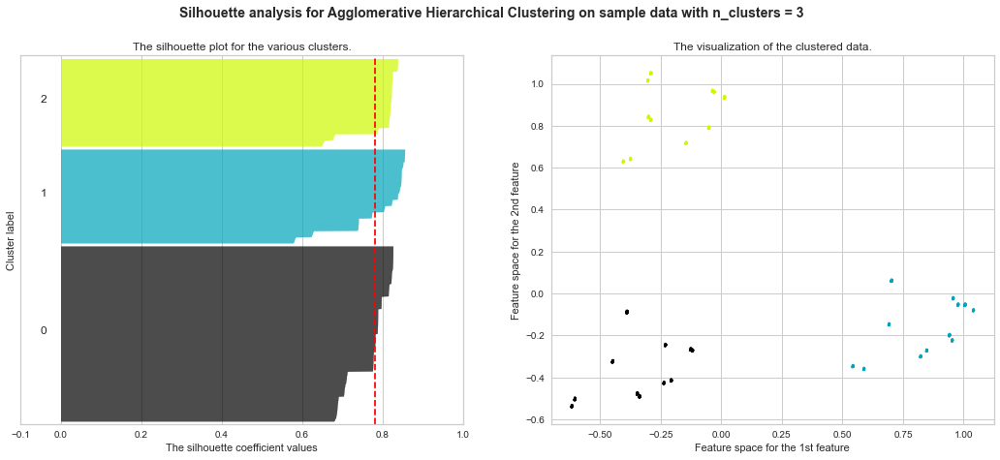

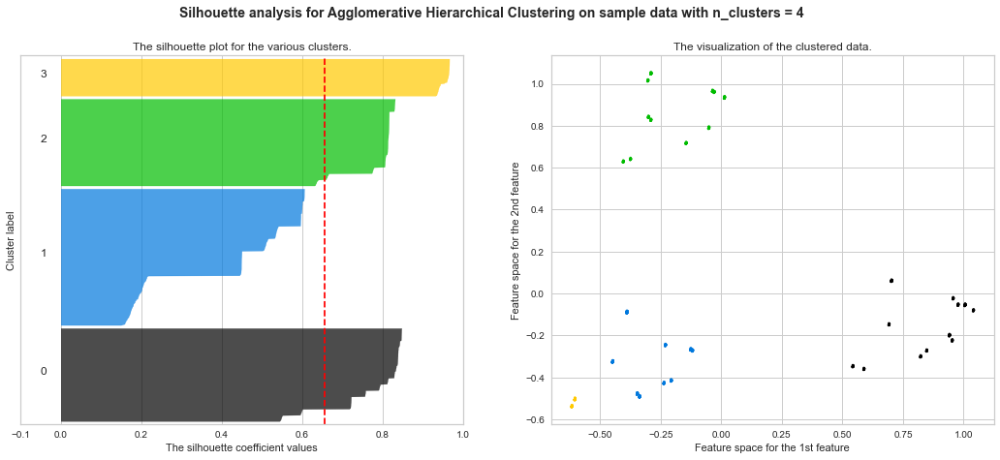

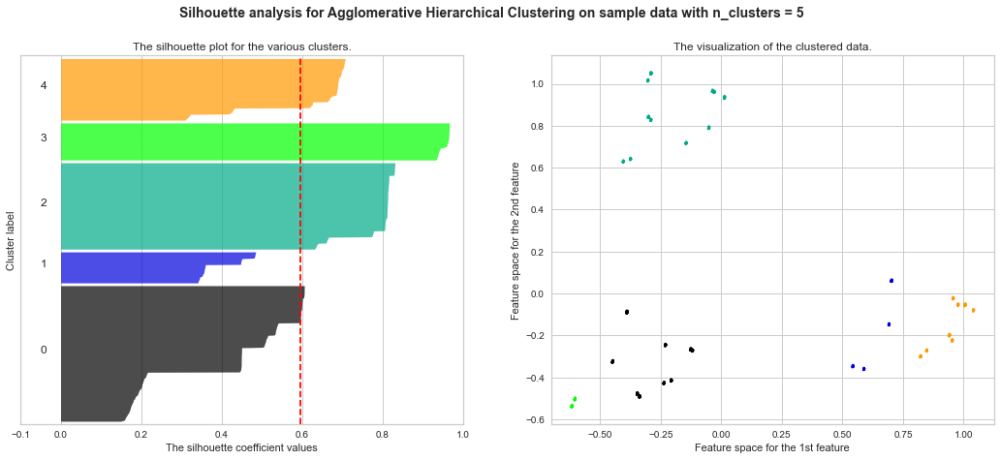

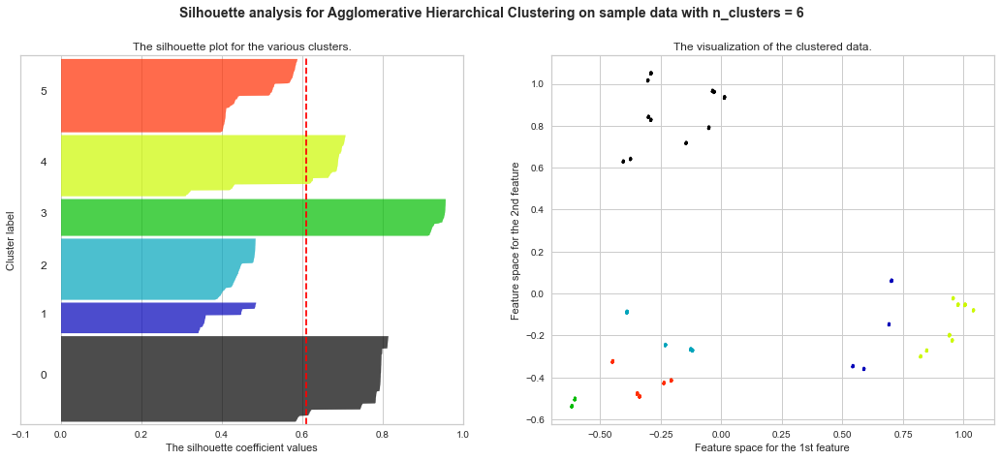

In [161]:
X = Hourly_array

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='ward')
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
   # centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
   # ax2.scatter(
   #     centers[:, 0],
   #     centers[:, 1],
   #     marker="o",
   #     c="white",
   #     alpha=1,
   #     s=200,
   #     edgecolor="k",
   # )

   # for i, c in enumerate(centers):
   #     ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for Agglomerative Hierarchical Clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )
plt.savefig('Silhouette_weekly.png', dpi=300, bbox_inches='tight')
plt.show()


As a result we obtain an optimal segmentation with 3 clusters.

# C1. Fuzzy C-Means Clustering Model

We define the `Fuzzy C-Means` model.

In [162]:
# Defining the Fuzzy C-Means model
def draw_optimal_Fuzzy(data, n_clusters=3, xlabel=None, ylabel=None, title=None):
    
    fcm = FCM(n_clusters=n_clusters)
    fcm.fit(data)
    
    y_fcm = fcm.predict(X)
   # outputs are stored fcm_centers and fcm_labels
    fcm_centers = fcm.centers

    plt.figure(figsize=(20,10))
    plt.scatter(X[y_fcm==0, 0], X[y_fcm==0, 1], cmap='salmon', label='Cluster 0')
    plt.scatter(X[y_fcm==1, 0], X[y_fcm==1, 1], cmap='orchid', label='Cluster 1')
    plt.scatter(X[y_fcm==2, 0], X[y_fcm==2, 1], cmap='salmon', label='Cluster 2')
    plt.scatter(X[y_fcm==3, 0], X[y_fcm==3, 1], cmap='orchid', label='Cluster 3')
    #plt.scatter(X[y_fcm==4, 0], X[y_fcm==4, 1], cmap='salmon', label='Cluster 4')
    #plt.scatter(X[y_fcm==5, 0], X[y_fcm==5, 1], cmap='salmon', label='Cluster 5')
    
    plt.scatter(fcm_centers[:,0], fcm_centers[:,1], s=100, label='Centers')

    plt.legend()

    plt.title(title, fontsize = 20)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

And we implement a total of `3` clusters for further analysis.

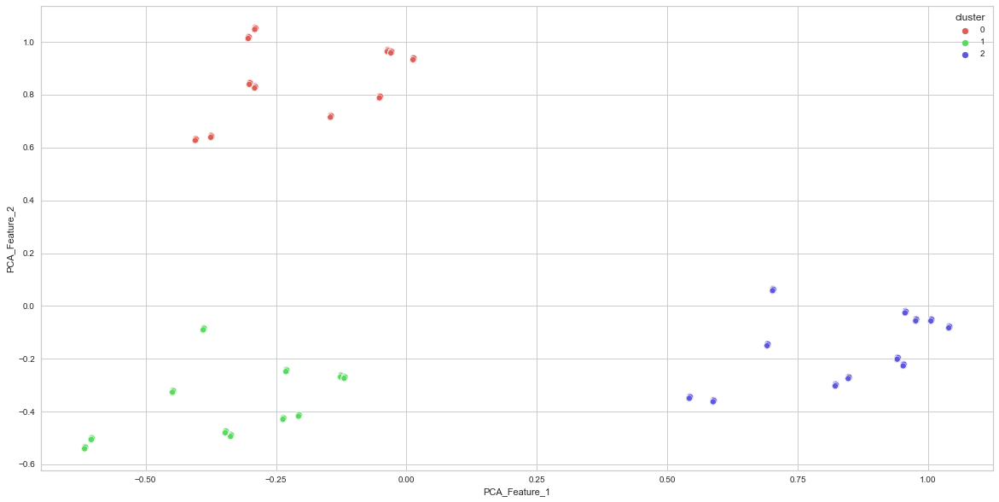

In [163]:
# Implementing Fuzzy C-Means Clustering with 3 clusters
clusters=3 #from above analysis for optimal value of k
fcm = FCM(n_clusters=clusters)
fcm.fit(Hourly_array)
y_fcm = fcm.predict(Hourly_array)

data = pd.DataFrame(Hourly_array, columns = ['PCA_Feature_1','PCA_Feature_2']) # features selected by using PCA
data['cluster'] = y_fcm

# Plot Showing Clusters using features [2] selected from PCA
plt.figure(figsize=(20,10))
sns.scatterplot(data=data, x=data.PCA_Feature_1, y=data.PCA_Feature_2, hue='cluster', palette=sns.color_palette("hls",clusters), legend="full")
plt.show()

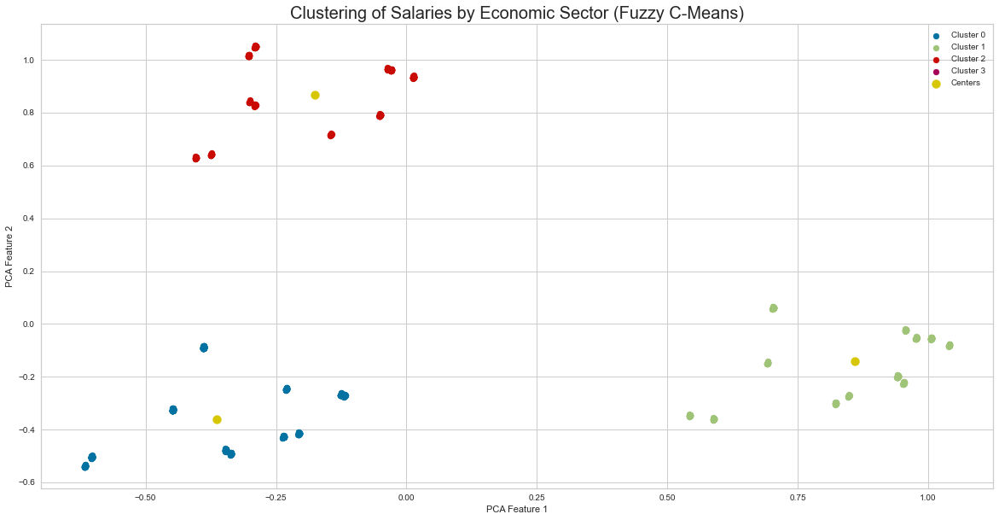

In [164]:
# Implementing Fuzzy C-Means Clustering with 3 clusters
X = Hourly_array
draw_optimal_Fuzzy(X,n_clusters=3, xlabel="PCA Feature 1", 
                      ylabel="PCA Feature 2", 
                      title="Clustering of Salaries by Economic Sector (Fuzzy C-Means)")

By implementing 3 clusters we obtain a good segmentation of our data.

We create a new column with the result of our algorithm

In [165]:
#Adding a new column with the result of the segmentation of hourly wages with respect to Fuzzy C-Means
Agglomerative['FCM_Hourly'] = pred
FCM1 = Agglomerative.sort_values(by = 'FCM_Hourly', ignore_index=True)
FCM1.head()

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly
0,2010-10-01,"Professional, scientific and technical activit...",754.50,1,Oct,2010,Friday,23.79,67400,31.7,2,1,0
1,2018-10-01,Financial and insurance activities (K),1195.41,1,Oct,2018,Monday,33.73,80000,35.6,2,1,0
2,2008-10-01,Transportation and storage (H),773.82,1,Oct,2008,Wednesday,21.10,68800,36.8,2,1,0
3,2018-10-01,Information and communication (J),1190.23,1,Oct,2018,Monday,32.70,71900,36.7,2,1,0
4,2018-10-01,Accommodation and food service activities (I),352.18,1,Oct,2018,Monday,13.07,177700,27.1,2,1,0


In [166]:
# Analyzing the Silhouette Score for 3 clusters
X = Hourly_array
fcm = FCM(n_clusters=3)
fcm.fit(X)
y_fcm = fcm.predict(X)
  
    
score_fcm = silhouette_score(X, y_fcm)
score_fcm

0.7822342909989097

As in the previous analyses, we obtain a good value for the Silhouette Score.

And we analyze various segmentations with their respective evaluations.

For n_clusters = 2 The average silhouette_score is : 0.49924435286531765
For n_clusters = 3 The average silhouette_score is : 0.7822342909989097
For n_clusters = 4 The average silhouette_score is : 0.6302485435474878
For n_clusters = 5 The average silhouette_score is : 0.6102551653446121
For n_clusters = 6 The average silhouette_score is : 0.6056130387339098


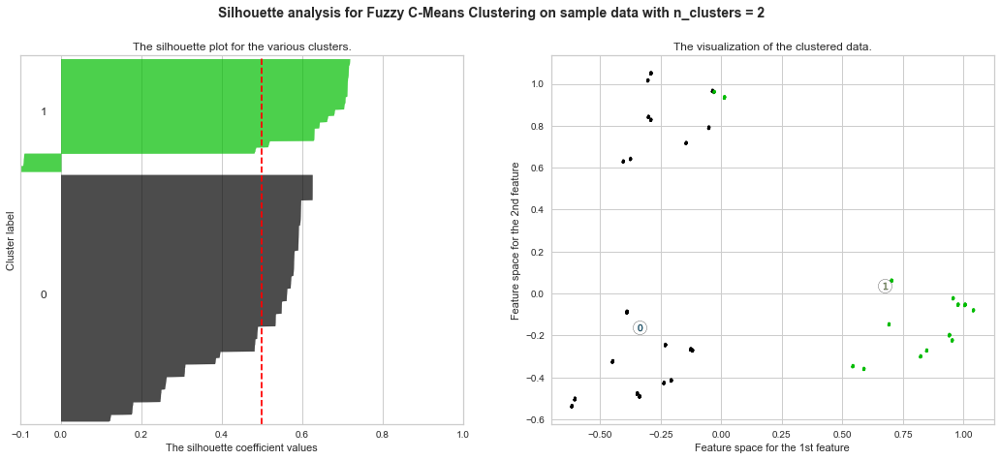

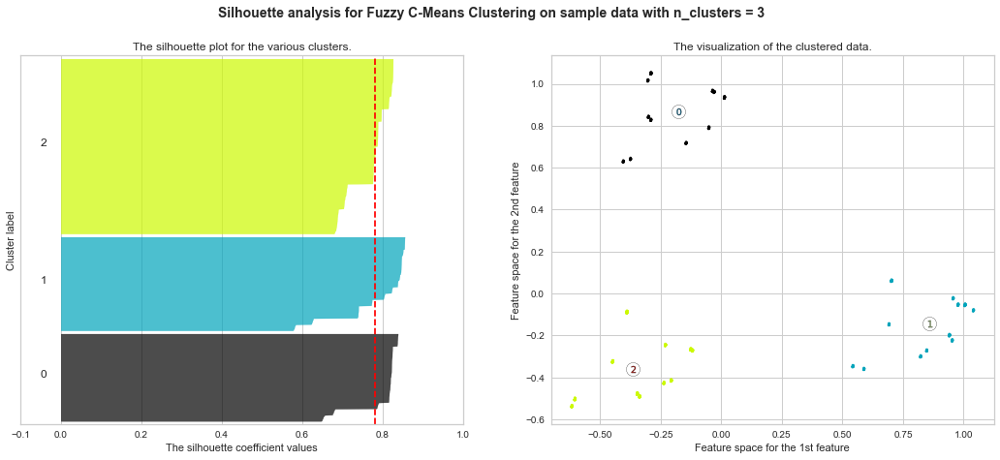

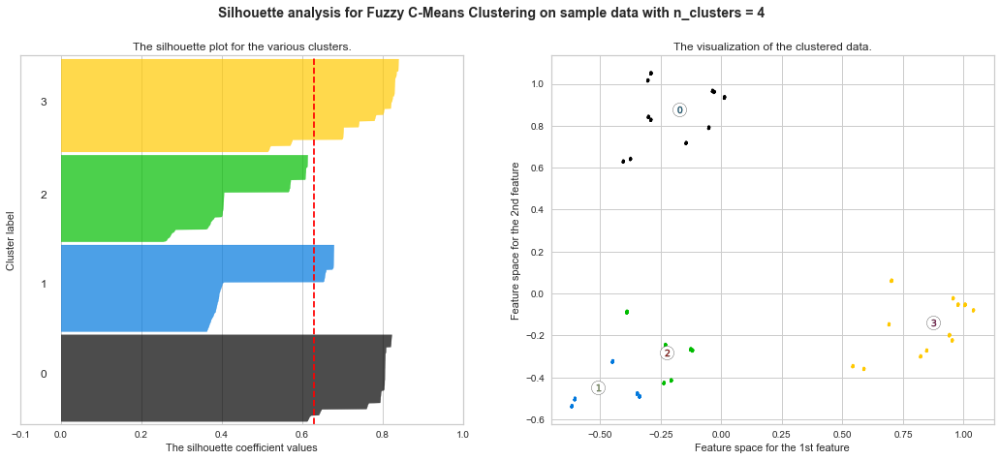

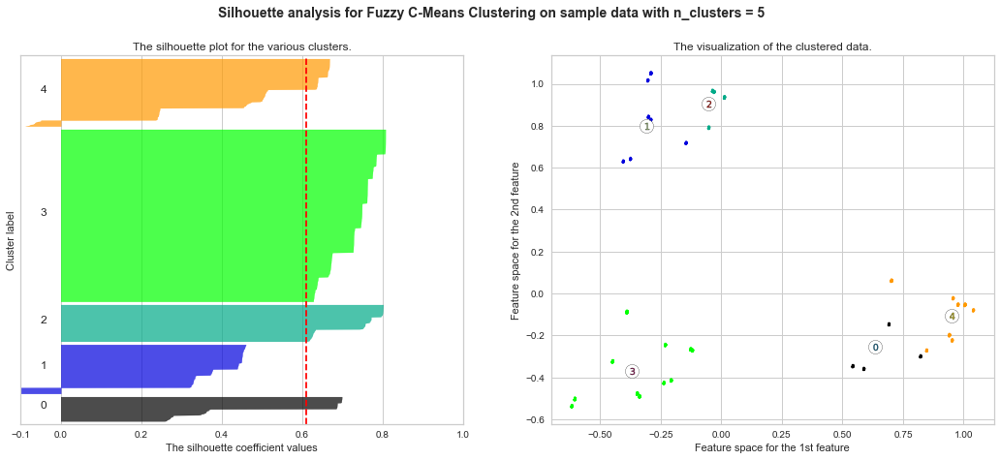

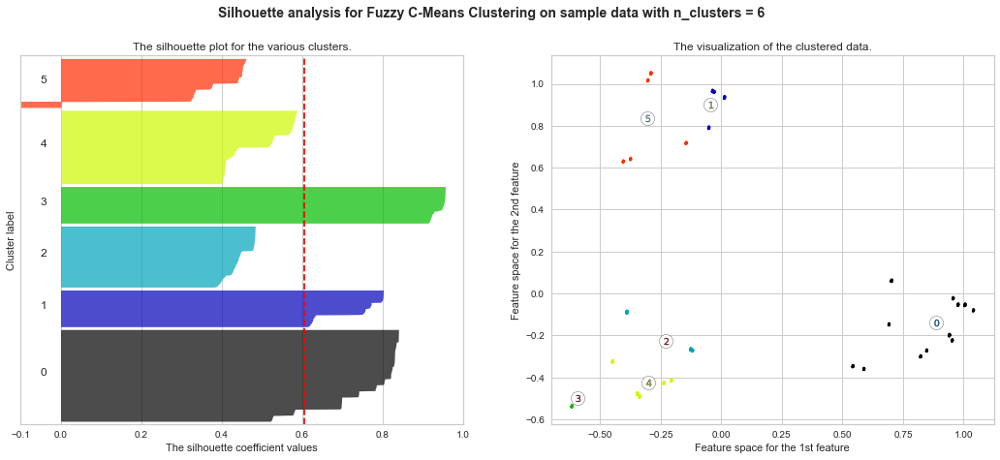

In [167]:
X = Hourly_array

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = FCM(n_clusters=n_clusters, random_state=10)
    clusterer.fit(X)
    cluster_labels = clusterer.predict(X)
    

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    #centers = clusterer.cluster_centers_  
    centers = clusterer.centers
    #fcm_labels = model.predict(X)
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for Fuzzy C-Means Clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )
plt.savefig('Silhouette_weekly.png', dpi=300, bbox_inches='tight')
plt.show()


A value of 3 clusters presents the best evaluation in contrast to the rest of the segmentations.

# D1. K-Means vs. Hierarchical vs. C-Means Clustering

We plot our data prior to its segmentation and contrast the different models by applying a 3-cluster segmentation.

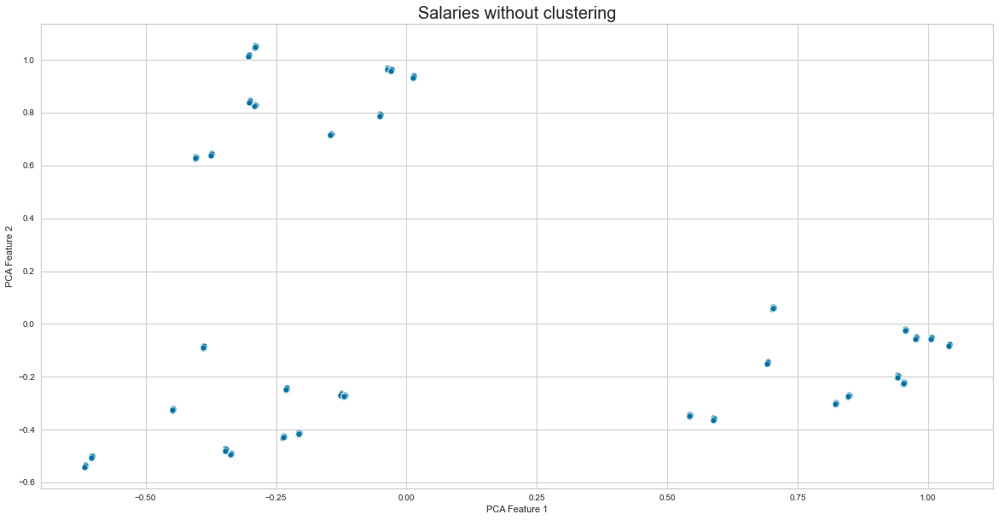

In [168]:
### K-Means vs. Hierarchical vs. C-Means Clustering

Hourly_c = pd.DataFrame(Hourly_array, columns = ['PCA_Feature_1','PCA_Feature_2']) # features selected by using PCA

# Plot Showing Clusters using features [2] selected from PCA
plt.figure(figsize=(20,10))
sns.scatterplot(data=Hourly_c, x=Hourly_c.PCA_Feature_1, y=Hourly_c.PCA_Feature_2) 
plt.title("Salaries without clustering", fontsize = 20)
plt.xlabel("PCA Feature 1")
plt.ylabel("PCA Feature 2")
plt.savefig('normal_Hourly.png', dpi=300, bbox_inches='tight')
plt.show()

In [169]:
# Generate clusters from K-Means
X = Hourly_array
km = KMeans(3)
km_clusters = km.fit_predict(X) 
# Generate clusters from Agglomerative Hierarchical Clustering
ac = AgglomerativeClustering(3, linkage='ward')
ac_clusters = ac.fit_predict(X)  

We graph the results of the segmentations.

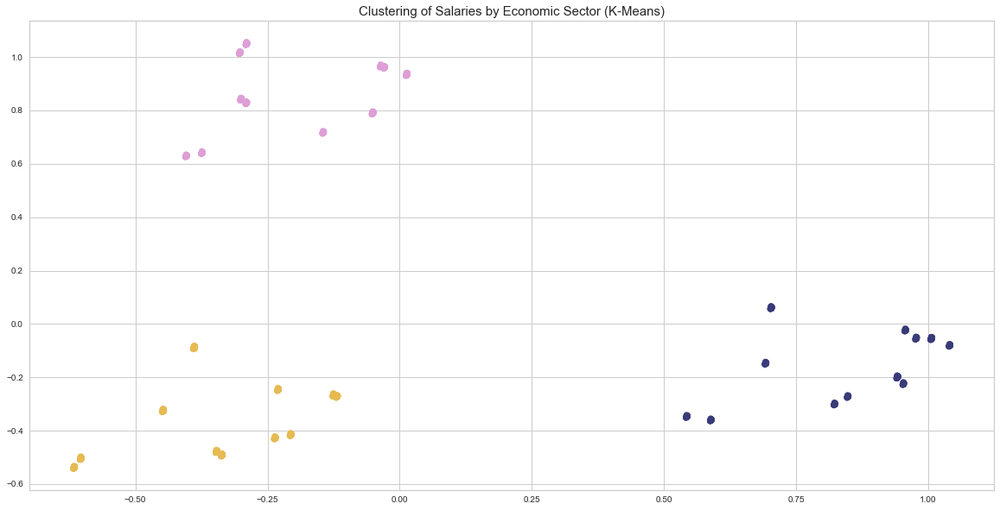

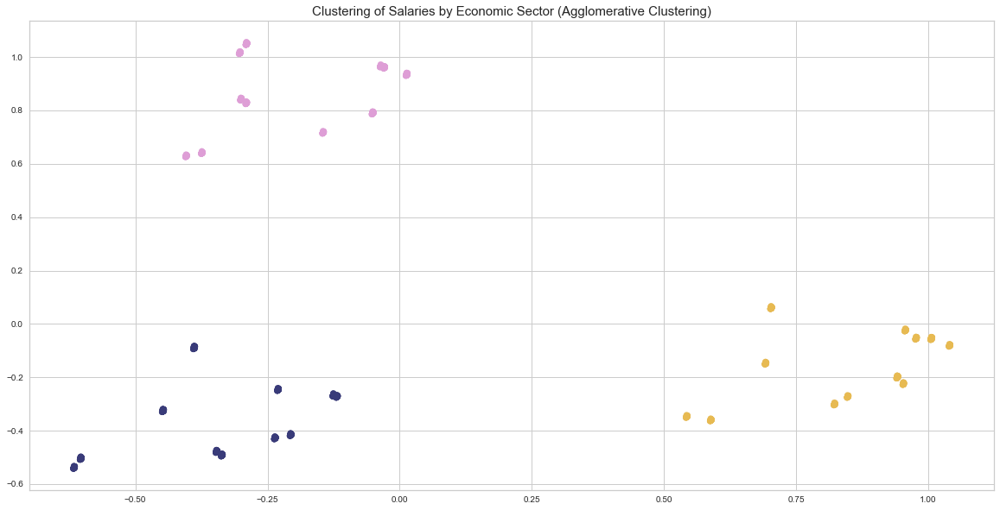

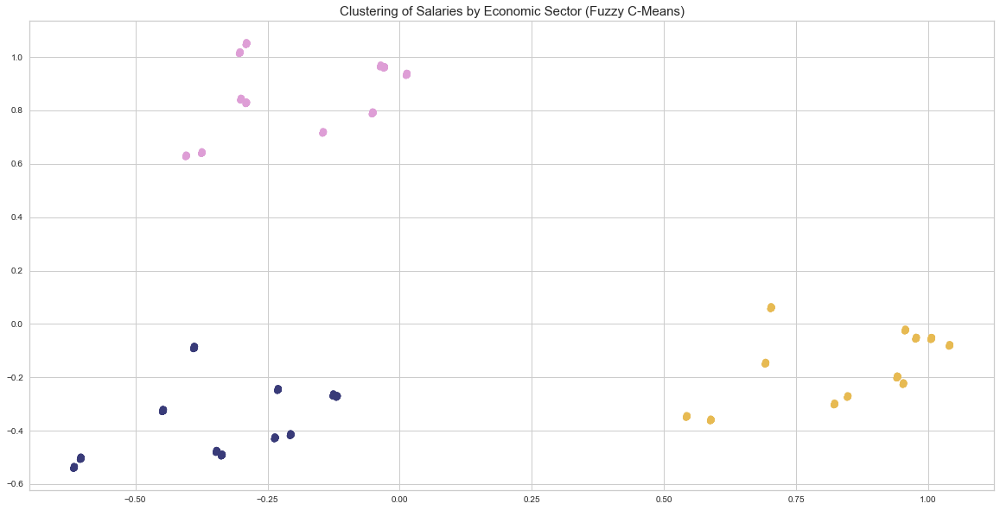

In [170]:
# Plotting the results for the 3 different models
plt.figure(figsize=(20,10))
plt.title("Clustering of Salaries by Economic Sector (K-Means)", fontsize = 15)
plt.scatter(Hourly_c.PCA_Feature_1, Hourly_c.PCA_Feature_2, c=km_clusters,s=50, cmap='tab20b')
plt.show()

plt.figure(figsize=(20,10))
plt.title("Clustering of Salaries by Economic Sector (Agglomerative Clustering)", fontsize = 15)
plt.scatter(Hourly_c.PCA_Feature_1, Hourly_c.PCA_Feature_2, c=ac_clusters,s=50, cmap='tab20b')
plt.show()

plt.figure(figsize=(20,10))
plt.title("Clustering of Salaries by Economic Sector (Fuzzy C-Means)", fontsize = 15)
plt.scatter(Hourly_c.PCA_Feature_1, Hourly_c.PCA_Feature_2, c=y_fcm,s=50, cmap='tab20b')
plt.savefig('Resoluts_Hourly.png', dpi=300, bbox_inches='tight')
plt.show()


We calculate their respective evaluations of Silhouette Scores.

In [171]:
# Calculate Silhouette Scores
print("Silhouette Scores for PCA Salaries Clusters:\n")
print("K-Means Clustering: ", silhouette_score(pca_Hourly.values, km_clusters))
print("Agg Clustering: ", silhouette_score(pca_Hourly.values, ac_clusters))
print("Fuzzy C-Means Clustering: ", silhouette_score(pca_Hourly.values, y_fcm))
#print("DBSCAN Clustering: ", silhouette_score(salary_pca.values, db_clusters))

Silhouette Scores for PCA Salaries Clusters:

K-Means Clustering:  0.7822342909989097
Agg Clustering:  0.7822342909989097
Fuzzy C-Means Clustering:  0.7822342909989097


As a result we get a segmentation match for our implemented algorithms. Therefore, the ideal grouping for our average hourly wages corresponds to 3.

____________________________________________________________________________________________________________________________

# 5.2 Clustering Weekly Analysis

The implementation of our three clustering models for our examination of the `Average Weekly` wage will come next.

# A2. K-Means

Next we will analyze the `Average Weekly Wages` using the `K-Means` model.

We will use the `Elbow`, `Calinski-Harabasz Index`, and `Davies-Bouldin Index` methods to determine the proper value of k.

As a first instance we implement the `Elbow method` to define the number of clusters to implement.

In [172]:
# Defining Elbow Curve

def find_clusters(data, start=1, end=11):
    """
    data: array like
    """
    inertias = []

    for i in range(start,end):
        kmeans = KMeans(n_clusters=i)
        kmeans.fit(X)
        inertias.append(kmeans.inertia_)

    plt.figure(figsize=(20,10))
    plt.plot(np.arange(start,end), np.array(inertias), color='orange', marker='o')
    plt.xlabel('No. of clusters')
    plt.ylabel('Inertia')
    plt.title("Elbow Curve", fontsize=16)
    plt.show()

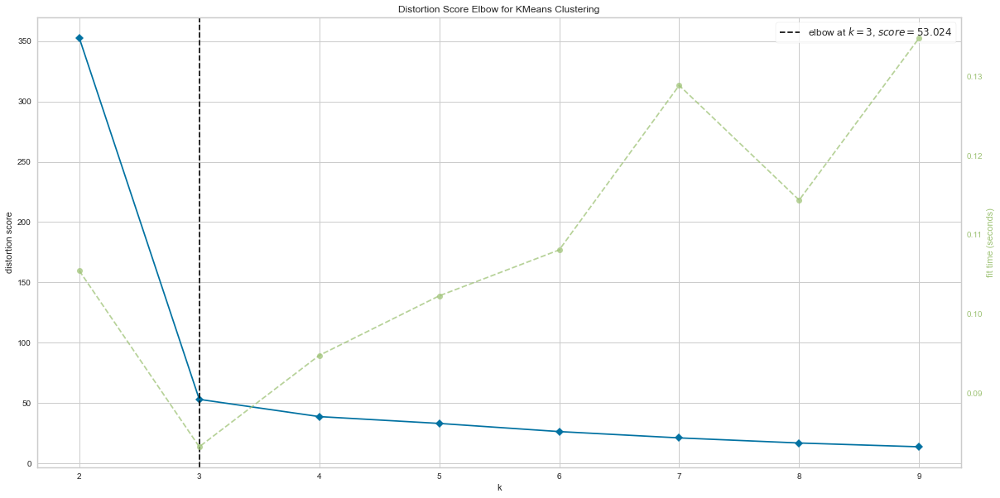

In [173]:
# Plotting Elbow method
X = Weekly_array
# Instantiate the clustering model and visualizer
#
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,10))
plt.figure(figsize=(20,10)) 
visualizer.fit(X)        # Fit the data to the visualizer
plt.savefig('Elbow_Weekly.png', dpi=300, bbox_inches='tight')
visualizer.show();        # Finalize and render the figure


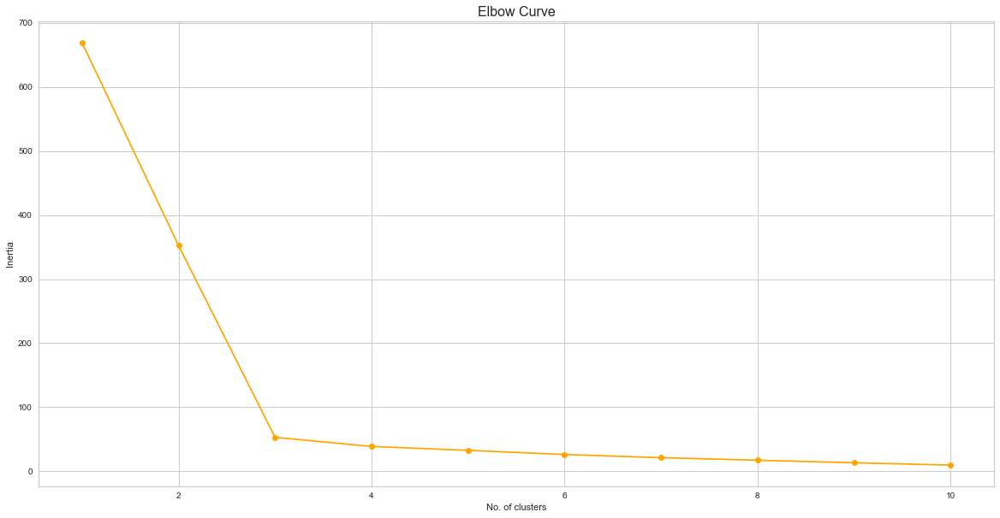

In [174]:
# Plotting Elbow method
X = Weekly_array

find_clusters(X)

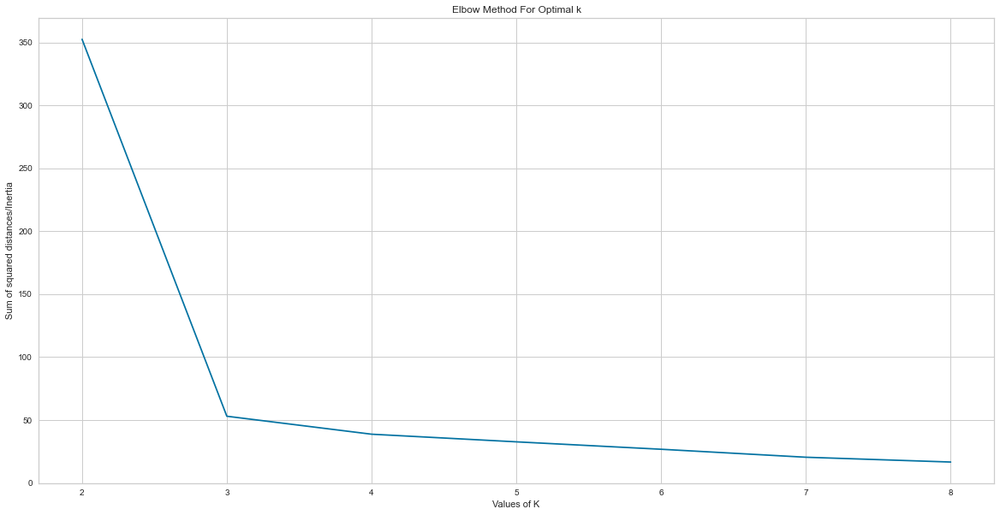

In [175]:
# Plotting Elbow method
Sum_of_squared_distances = []
K = range(2,9)
for num_clusters in K :
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(Weekly_array)
    Sum_of_squared_distances.append(kmeans.inertia_)

plt.figure(figsize=(20,10))
plt.plot(K,Sum_of_squared_distances,'x-')
plt.xlabel('Values of K')
plt.ylabel('Sum of squared distances/Inertia')
plt.title('Elbow Method For Optimal k')
plt.show()

Elbow method gives us as a result an optimal value of 3.

We review the Silhouette plot to define the optimal value of k

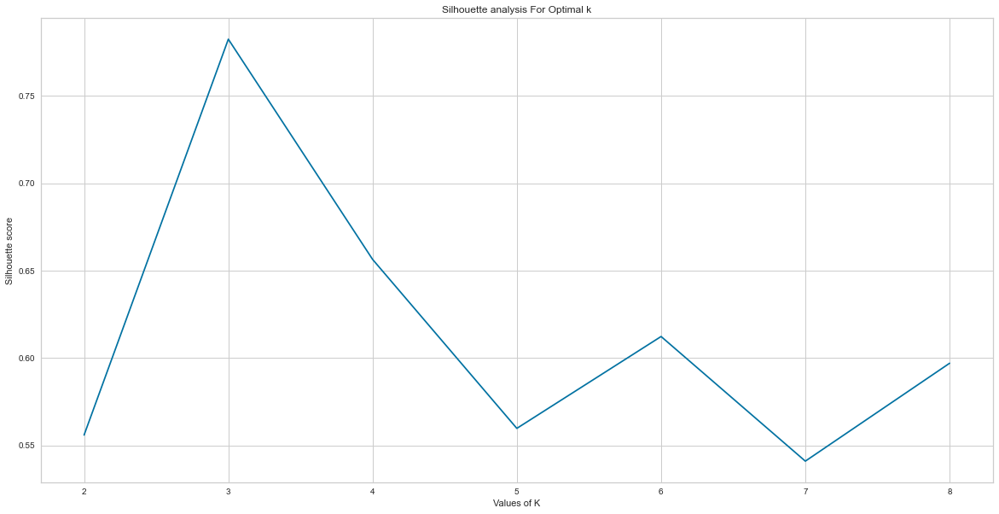

In [176]:
# Plotting Silhouette score method
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
silhouette_avg = []
for num_clusters in range_n_clusters:
    # initialise kmeans
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(Weekly_array)
    cluster_labels = kmeans.labels_
    # silhouette score
    silhouette_avg.append(silhouette_score(Weekly_array, cluster_labels))

plt.figure(figsize=(20,10))
plt.plot(range_n_clusters,silhouette_avg,'x-')
plt.xlabel('Values of K')
plt.ylabel('Silhouette score')
plt.title('Silhouette analysis For Optimal k')
plt.show()

We review the graph of the `Calinski-Harabasz Index`.

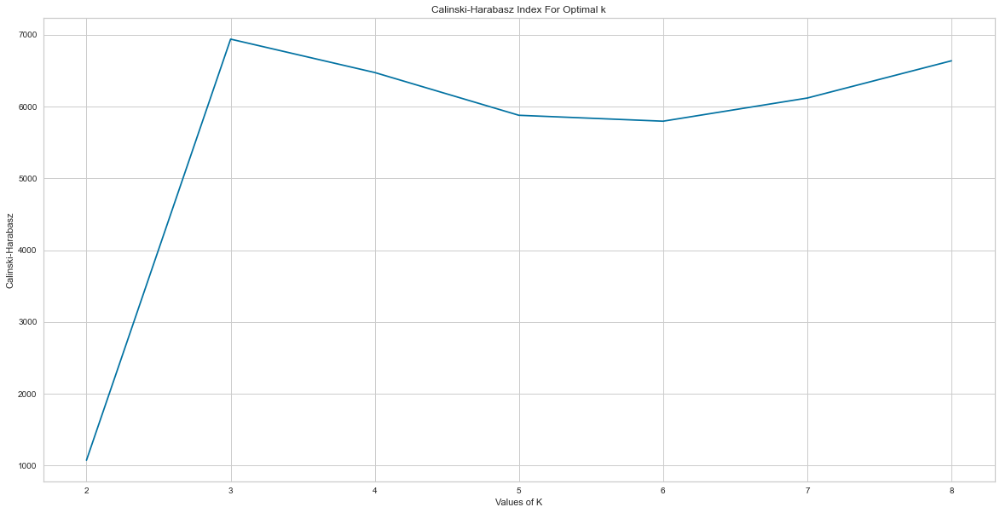

In [177]:
# Plotting Calinski-Harabasz Index
range_n_clusters = range(2,9)
calinski_harabasz_avg = []
for num_clusters in range_n_clusters:
    # initialise kmeans
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(Weekly_array)
    cluster_labels = kmeans.labels_
    # Calinski-Harabasz
    calinski_harabasz_avg.append(calinski_harabasz_score(Weekly_array, cluster_labels))

plt.figure(figsize=(20,10))
plt.plot(range_n_clusters,calinski_harabasz_avg,'x-')
plt.xlabel('Values of K')
plt.ylabel('Calinski-Harabasz')
plt.title('Calinski-Harabasz Index For Optimal k')
plt.show()

And finally we analyze the graph of `Davies-Bouldin Index`.

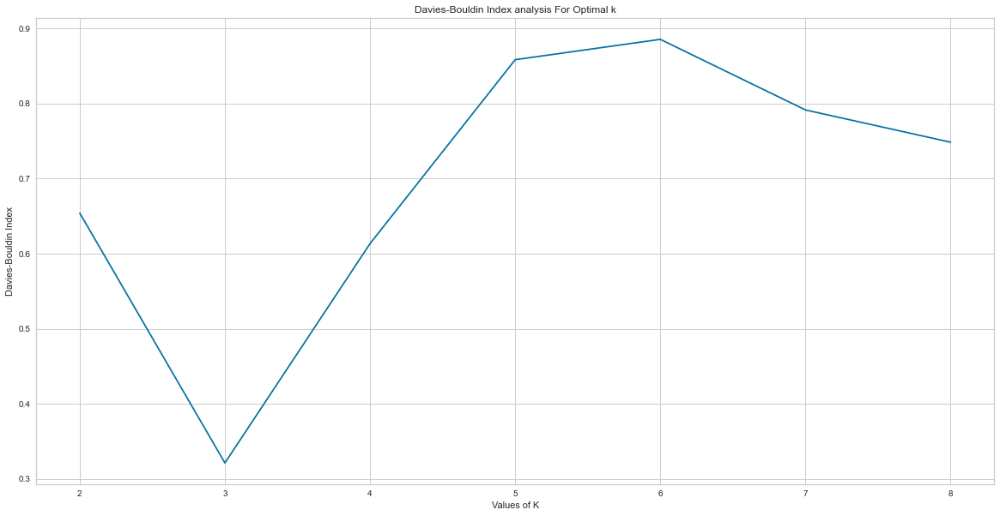

In [178]:
# Plotting Davies-Bouldin Index
range_n_clusters = range(2,9)
avies_bouldin_avg = []
for num_clusters in range_n_clusters:
    # initialise kmeans
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(Weekly_array)
    cluster_labels = kmeans.labels_
    # Davies-Bouldin Index
    avies_bouldin_avg.append(davies_bouldin_score(Weekly_array, cluster_labels))

plt.figure(figsize=(20,10))
plt.plot(range_n_clusters,avies_bouldin_avg,'x-')
plt.xlabel('Values of K')
plt.ylabel('Davies-Bouldin Index')
plt.title('Davies-Bouldin Index analysis For Optimal k')
plt.show()

We compare the results obtained and it coincides in a single result of 3 for all the implemented methods.

We apply a segmentation of 3 clusters for our analysis variable.

In [179]:
# Defining the K-Means model
def draw_optimal_clusters(data, n_clusters=3, xlabel=None, ylabel=None, title=None):
    
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(data)
    
    y_means = kmeans.predict(X)
    centers = kmeans.cluster_centers_
   
    plt.figure(figsize=(20,10))
    plt.scatter(X[y_means==0, 0], X[y_means==0, 1], color='lightblue', label='Cluster 0')
    plt.scatter(X[y_means==1, 0], X[y_means==1, 1], color='orange', label='Cluster 1')
    plt.scatter(X[y_means==2, 0], X[y_means==2, 1], color='turquoise', label='Cluster 2')
    #plt.scatter(X[y_means==3, 0], X[y_means==3, 1], color='lightcoral', label='Cluster 3')
    #plt.scatter(X[y_means==4, 0], X[y_means==4, 1], color='orchid', label='Cluster 4')
     
    plt.scatter(centers[:,0], centers[:,1], s=100, label='Centers')

    
    plt.legend()
   
    plt.title(title, fontsize = 20)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

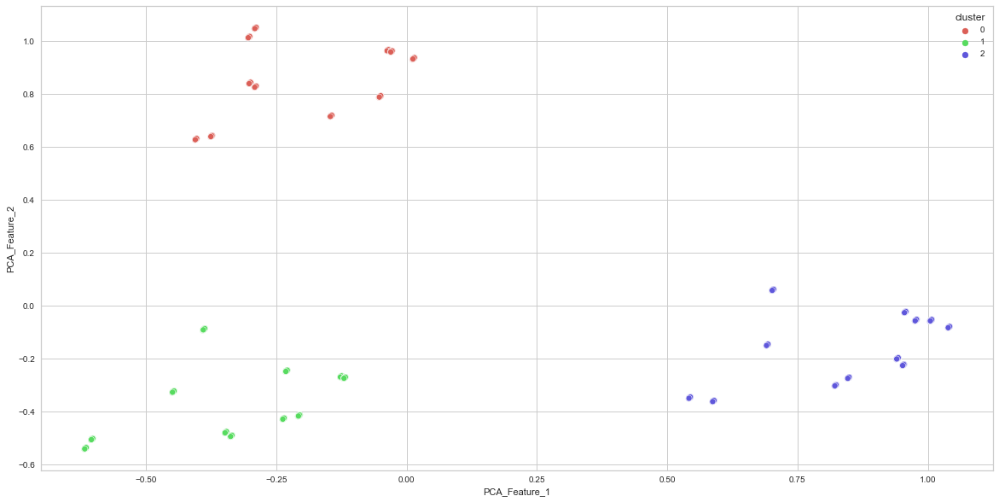

In [180]:
# Implementing K-Means Clustering with 3 clusters
clusters=3 #from above analysis for optimal value of k
kmeans = KMeans(n_clusters=clusters, init='k-means++')
kmeans.fit(Weekly_array)
pred = kmeans.predict(Weekly_array)
data = pd.DataFrame(Weekly_array, columns = ['PCA_Feature_1','PCA_Feature_2']) # features selected by using PCA
data['cluster'] = pred

# Plot Showing Clusters using features [2] selected from PCA
plt.figure(figsize=(20,10))
sns.scatterplot(data=data, x=data.PCA_Feature_1, y=data.PCA_Feature_2, hue='cluster', palette=sns.color_palette("hls",clusters), legend="full")
plt.show()

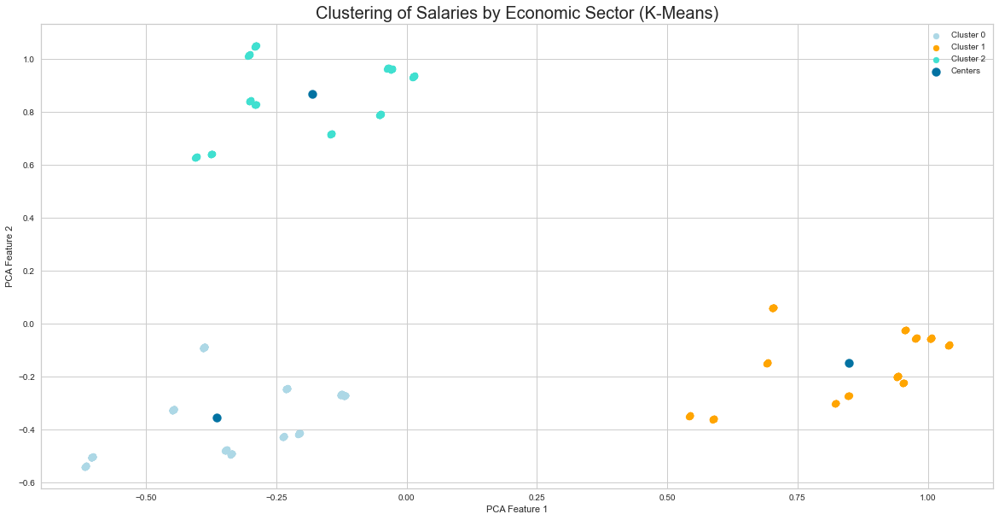

In [181]:
# Implementing K-Means Clustering with 3 clusters
draw_optimal_clusters(X,n_clusters=3, xlabel="PCA Feature 1", 
                      ylabel="PCA Feature 2", 
                      title="Clustering of Salaries by Economic Sector (K-Means)")

We obtain a perfect separation of our values in 3 groups perfectly well defined

We add our results to our database.

In [182]:
#Adding a new column with the result of the segmentation of Weekly wages with respect to K-Means
FCM1['KMeans_Weekly'] = pred
Kmeans2 = FCM1.sort_values(by = 'KMeans_Weekly', ignore_index=True)
Kmeans2.head()

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly
0,2010-01-01,"Professional, scientific and technical activit...",825.04,1,Jan,2010,Friday,25.72,72800,32.4,0,0,1,0
1,2016-10-01,Accommodation and food service activities (I),332.26,1,Oct,2016,Saturday,12.54,158000,26.7,2,0,0,0
2,2019-01-01,Real estate activities (L),747.62,1,Jan,2019,Tuesday,24.49,10100,30.6,0,0,0,0
3,2008-07-01,Wholesale and retail trade; repair of motor ve...,509.55,1,Jul,2008,Tuesday,16.52,313300,31.0,1,1,0,0
4,2019-01-01,"Professional, scientific and technical activit...",903.47,1,Jan,2019,Tuesday,26.50,98300,33.9,0,0,0,0


We evaluate the result using Silhouette method. And we get a good evaluation value.

In [183]:
# Analyzing the Silhouette Score for 3 clusters
X = Weekly_array
kmeans = KMeans(n_clusters=3)
kmeans.fit(X)
y_means = kmeans.predict(X)
    
score_kmeans = silhouette_score(X, y_means)
score_kmeans

0.7824004275569864

We analyze various segmentations with our algorithm and compare the results.

For n_clusters = 2 The average silhouette_score is : 0.5560041130691376
For n_clusters = 3 The average silhouette_score is : 0.7824004275569864
For n_clusters = 4 The average silhouette_score is : 0.6305855290981344
For n_clusters = 5 The average silhouette_score is : 0.5617360599196887
For n_clusters = 6 The average silhouette_score is : 0.49331298840535187


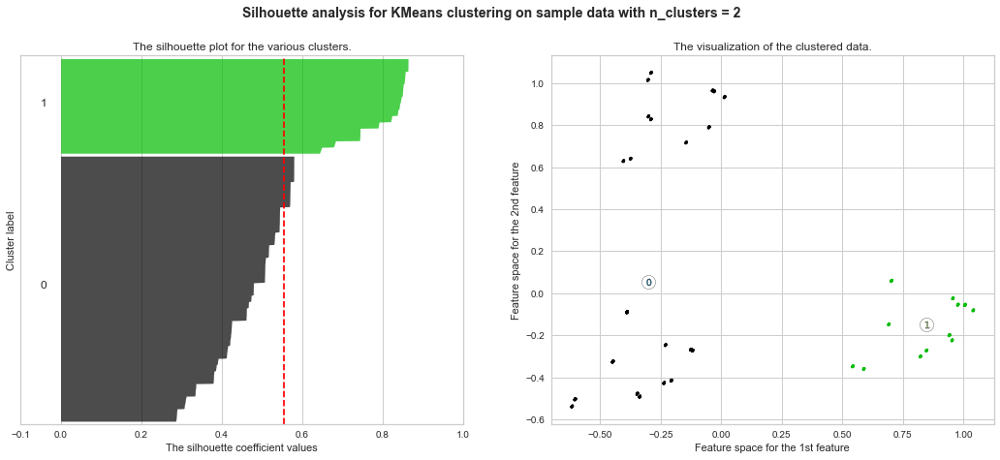

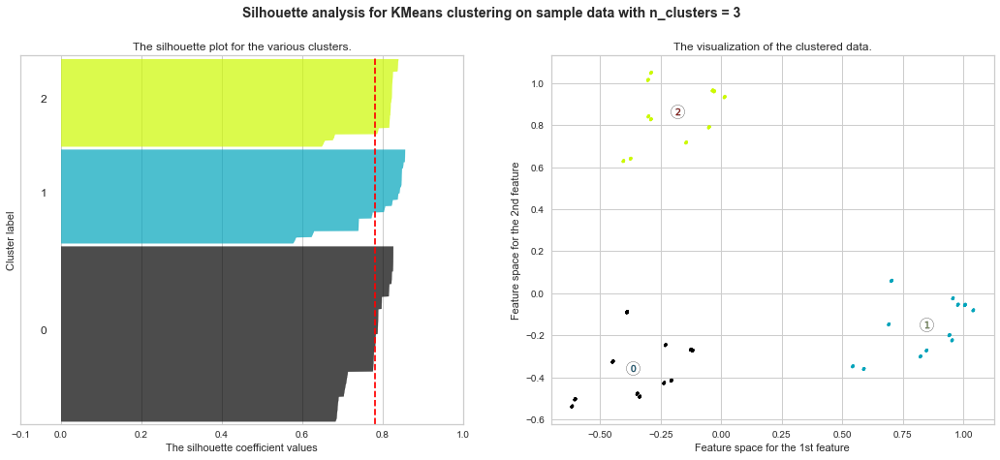

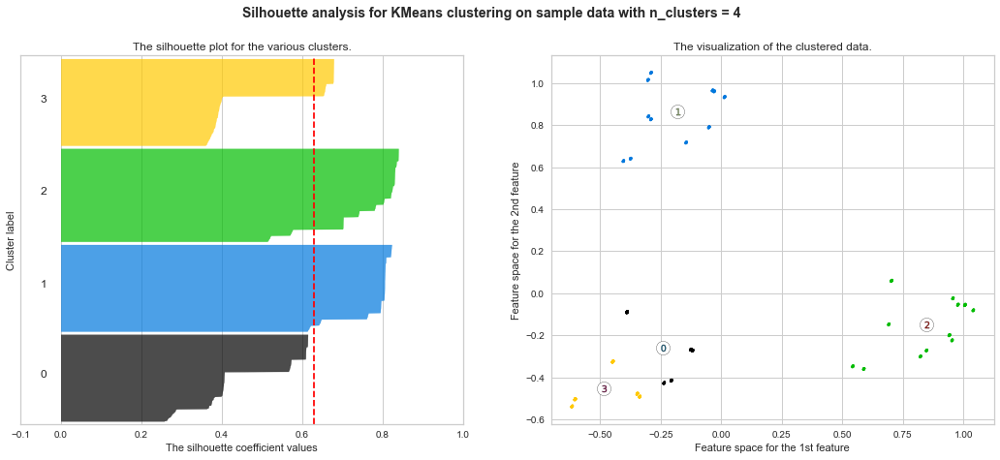

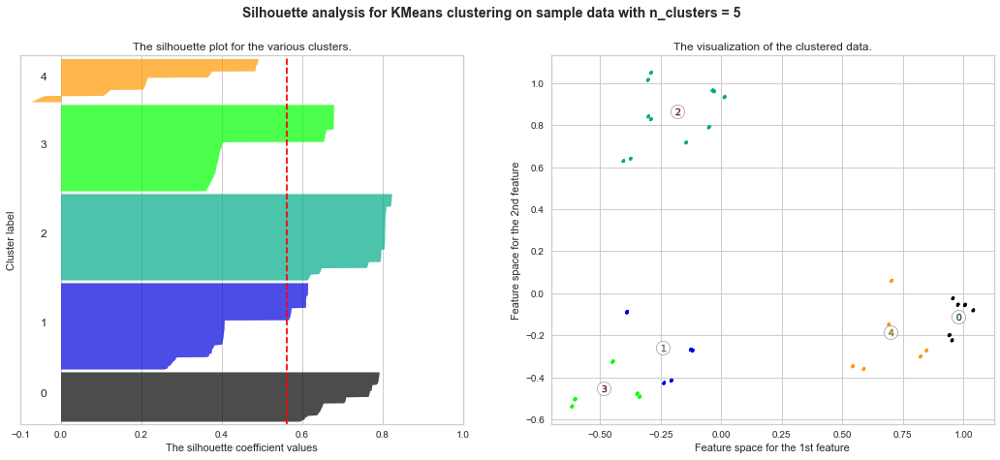

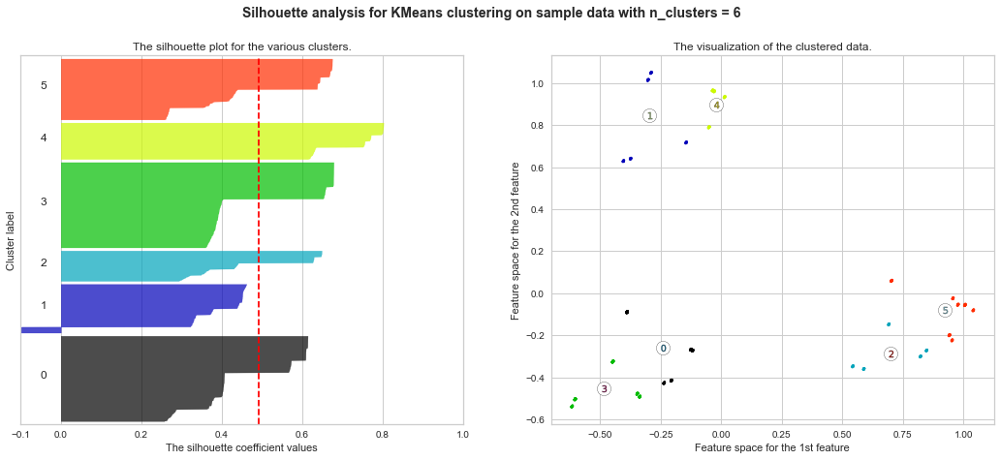

In [184]:
X = Weekly_array

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )
plt.savefig('Silhouette_weekly.png', dpi=300, bbox_inches='tight')
plt.show()


A value of k to 3 is confirmed as the best segmentation of our analysis variable.

# B2. Agglomerative Hierarchical Clustering

We implement Agglomerative Hierarchical Clustering model of to our average weekly wages variable.

In [185]:
# Defining the Agglomerative Hierarchical Clustering model
def draw_optimal_agglo(data, n_clusters=3, affinity = 'euclidean', linkage = 'ward', xlabel=None, ylabel=None, title=None):

    agglo_c = AgglomerativeClustering(n_clusters=n_clusters,
                                       affinity='euclidean',
                                       linkage='ward')
    

    y_agglo = agglo_c.fit_predict(X)
    
#Defining the centers based on the k-means model
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(data)
    y_means = kmeans.predict(X)
    centers = kmeans.cluster_centers_
   
    plt.figure(figsize=(20,10))
    plt.scatter(X[y_agglo==0, 0], X[y_agglo==0, 1], color='lightblue', label='Cluster 0')
    plt.scatter(X[y_agglo==1, 0], X[y_agglo==1, 1], color='orange', label='Cluster 1')
    plt.scatter(X[y_agglo==2, 0], X[y_agglo==2, 1], color='turquoise', label='Cluster 2')
    #plt.scatter(X[y_agglo==3, 0], X[y_agglo==3, 1], color='lightcoral', label='Cluster 3')
    #plt.scatter(X[y_agglo==4, 0], X[y_agglo==4, 1], color='orchid', label='Cluster 4')
    
 
    plt.scatter(centers[:,0], centers[:,1], s=100, label='Centers')
 

    plt.legend()

    plt.title(title, fontsize = 20)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

In [186]:
# 1 means Informational Duration and 2 means Bounce Rate
X = Weekly_array

# Display an array of only two columns
print(X)

[[ 0.95231684 -0.22364594]
 [ 0.95464052 -0.22244681]
 [ 0.9533861  -0.22382123]
 ...
 [ 0.97825661 -0.052636  ]
 [ 0.97816128 -0.05185101]
 [ 0.97563992 -0.0567938 ]]


We implement our `Dendrogram` using the `Ward method` to visualize the possible number of clusters.

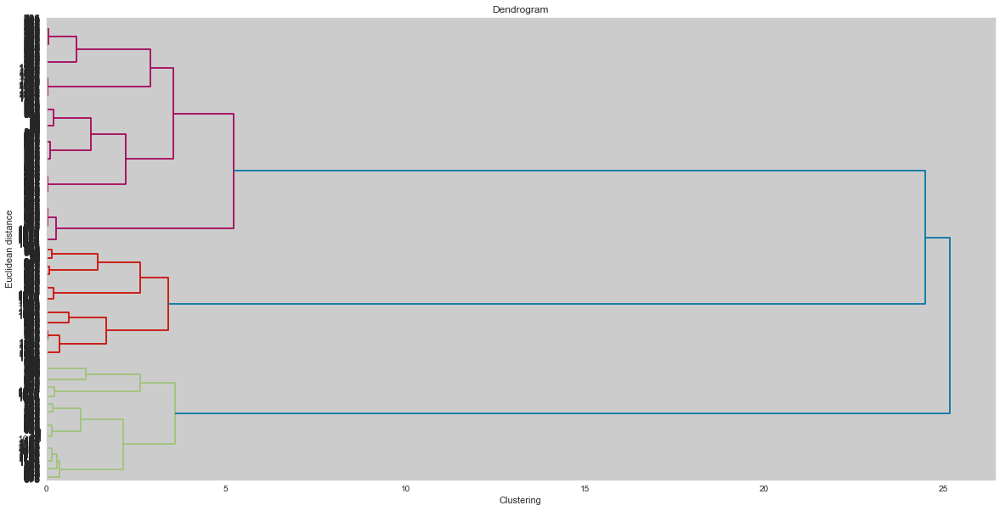

In [187]:
#Size of the figure
plt.figure(figsize = (20, 10))

#Call the method dendrogram by using an object sch
dendrogrm = sch.dendrogram(sch.linkage(X, method = 'ward'), leaf_rotation=0, leaf_font_size=12, orientation='right')

plt.title('Dendrogram')
plt.xlabel('Clustering')
plt.ylabel('Euclidean distance')
plt.savefig('dendofram_weekly.png', dpi=300, bbox_inches='tight')
plt.show()


We corroborate by means of the Elbow model the ideal number of segmentations.

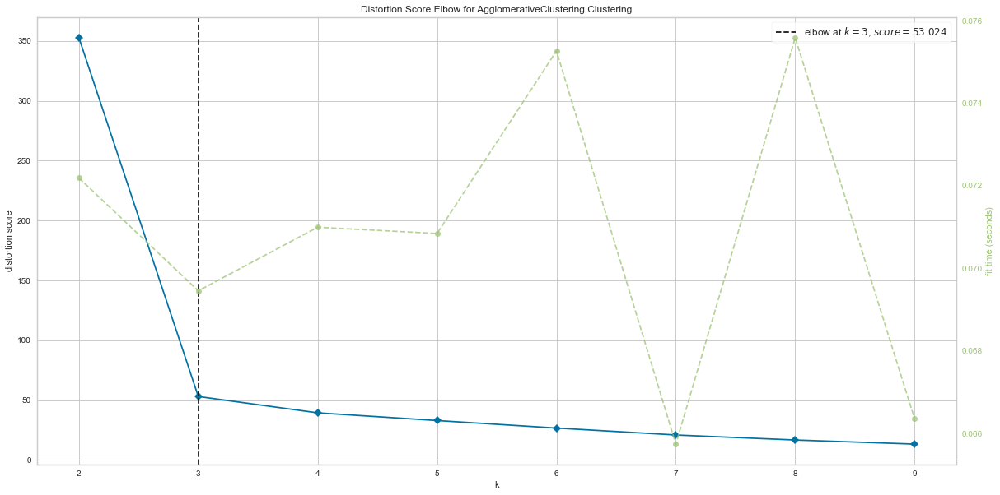

In [188]:
# Defining Elbow method
X = Weekly_array
# Instantiate the clustering model and visualizer
#
AC = AgglomerativeClustering(n_clusters=clusters, affinity='euclidean', linkage='ward')
visualizer = KElbowVisualizer(AC, k=(2,10))
plt.figure(figsize=(20,10)) 
visualizer.fit(X)        # Fit the data to the visualizer
plt.savefig('Elbow_Hourly.png', dpi=300, bbox_inches='tight')
visualizer.show();        # Finalize and render the figure

We implemented a total of 3 clusters.

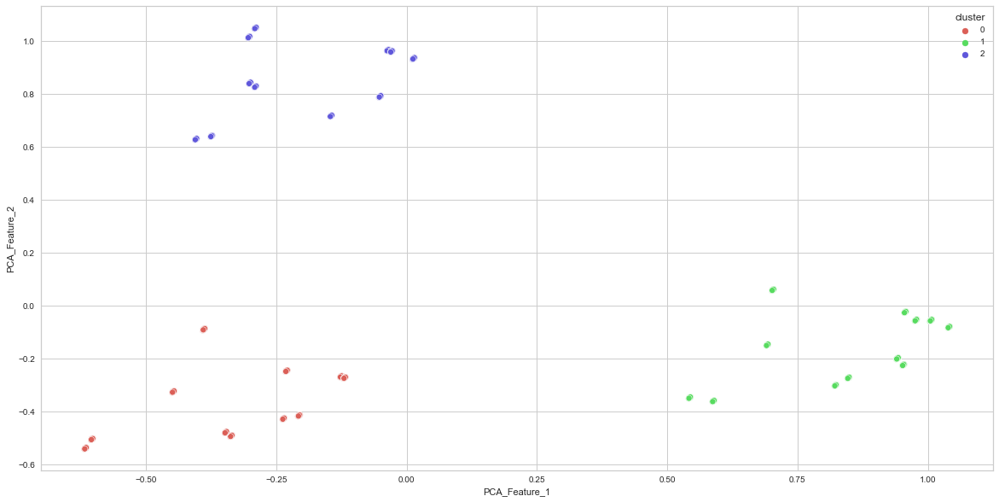

In [189]:
# Implementing Agglomerative Hierarchical Clustering with 3 clusters
clusters=3 #from above analysis for optimal value of k
agglo_c = AgglomerativeClustering(n_clusters=clusters, affinity='euclidean', linkage='ward')
agglo_c.fit(Weekly_array)
pred = agglo_c.fit_predict(Weekly_array)

data = pd.DataFrame(Weekly_array, columns = ['PCA_Feature_1','PCA_Feature_2']) # features selected by using PCA
data['cluster'] = pred

# Plot Showing Clusters using features [2] selected from PCA
plt.figure(figsize=(20,10))
sns.scatterplot(data=data, x=data.PCA_Feature_1, y=data.PCA_Feature_2, hue='cluster', palette=sns.color_palette("hls",clusters), legend="full")
plt.show()

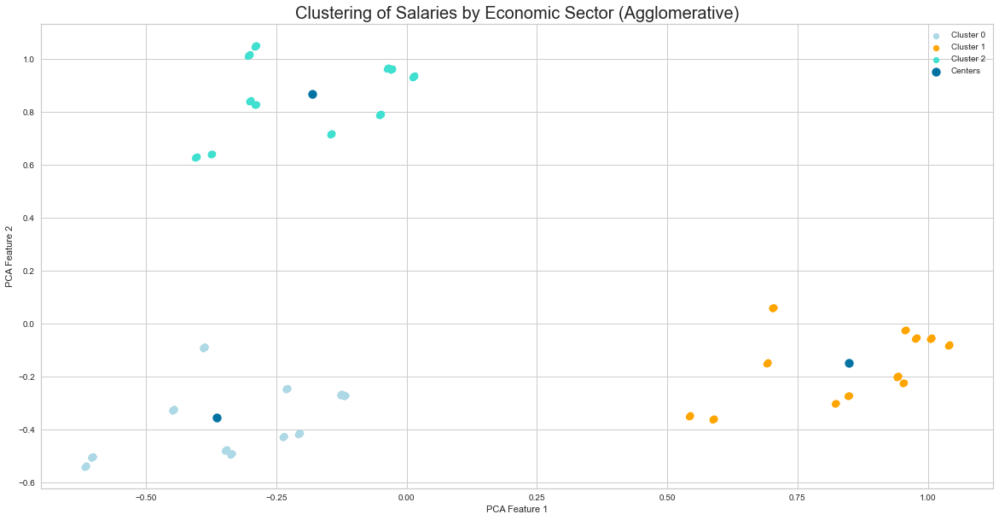

In [190]:
# Implementing Agglomerative Hierarchical Clustering with 3 clusters
X = Weekly_array
draw_optimal_agglo(X, n_clusters=3, xlabel="PCA Feature 1", 
                      ylabel="PCA Feature 2", 
                      title="Clustering of Salaries by Economic Sector (Agglomerative)")

3 perfectly well-defined clusters are obtained as a result.

We add a new column with the results

In [191]:
#Adding a new column with the result of the segmentation of Weekly wages with respect to Agglomerative Hierarchical Clustering
Kmeans2['HAC_Weekly'] = pred
Agglomerative2 = Kmeans2.sort_values(by = 'HAC_Weekly', ignore_index=True)
Agglomerative2.head()

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly
0,2017-10-01,Other service activities (S),433.38,1,Oct,2017,Sunday,15.73,25000,27.6,2,2,0,1,0
1,2015-01-01,"Financial, insurance and real estate activitie...",1015.24,1,Jan,2015,Thursday,29.79,91000,34.1,0,0,0,1,0
2,2015-01-01,"Arts, entertainment, recreation and other serv...",472.85,1,Jan,2015,Thursday,17.11,49500,27.7,0,0,0,1,0
3,2016-01-01,All NACE economic sectors,708.29,1,Jan,2016,Friday,22.04,1652300,31.9,0,0,0,1,0
4,2016-01-01,Mining and quarrying (B),938.73,1,Jan,2016,Friday,23.98,5300,39.1,0,0,0,1,0


We evaluate the quality of our algorithm.

In [192]:
# Analyzing the Silhouette Score for 3 clusters
X = Weekly_array
agglo_c = AgglomerativeClustering(n_clusters=3,
                                       affinity='euclidean',
                                       linkage='ward')
    

y_agglo = agglo_c.fit_predict(X)
    
score_Agglo = silhouette_score(X, y_agglo)
score_Agglo

0.7824004275569864

A high value is obtained in the silhouette method

We compare different numbers of clusters with their respective evaluations

For n_clusters = 2 The average silhouette_score is : 0.5560041130691376
For n_clusters = 3 The average silhouette_score is : 0.7824004275569864
For n_clusters = 4 The average silhouette_score is : 0.6564675358373219
For n_clusters = 5 The average silhouette_score is : 0.5956083760285549
For n_clusters = 6 The average silhouette_score is : 0.6116814604178242


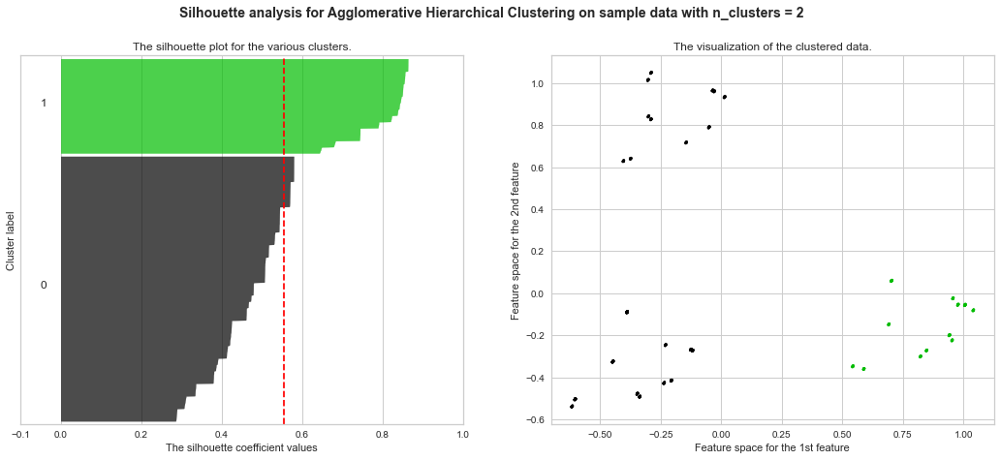

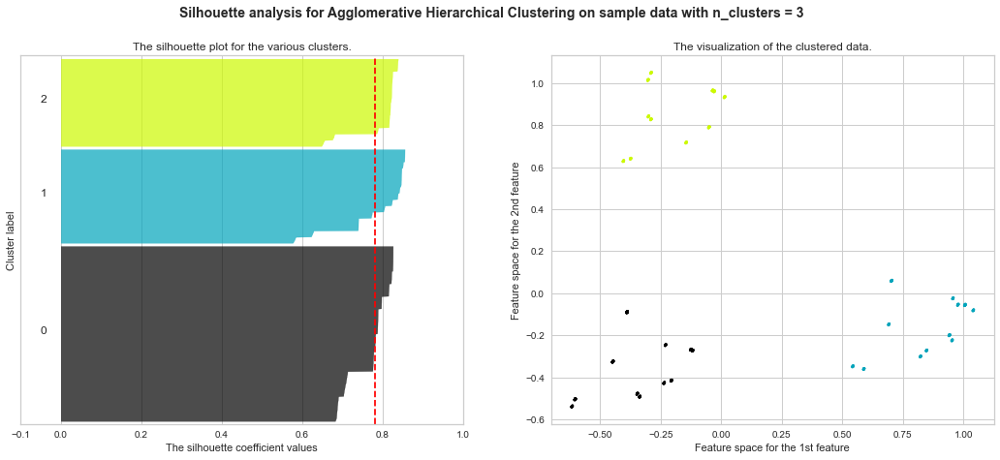

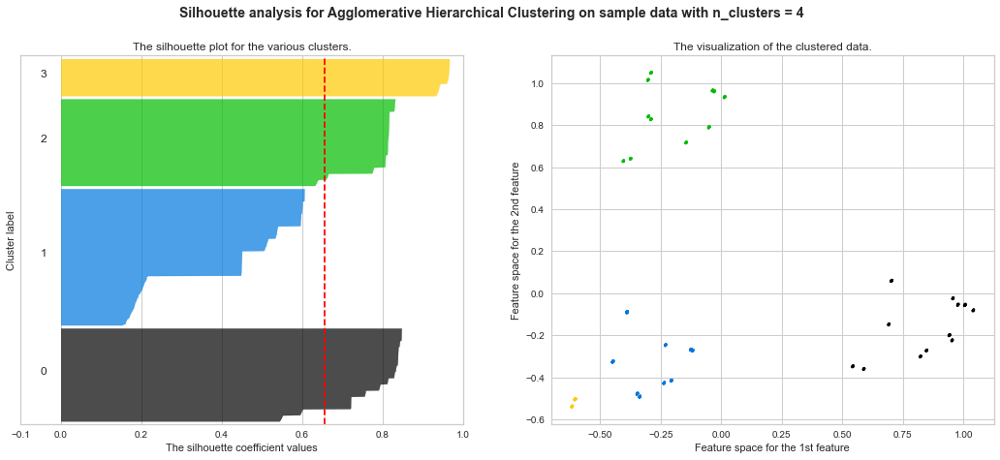

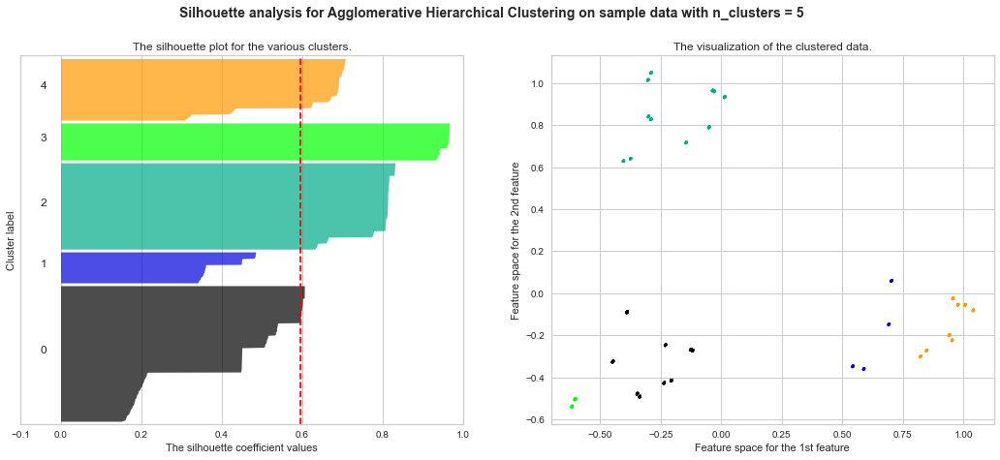

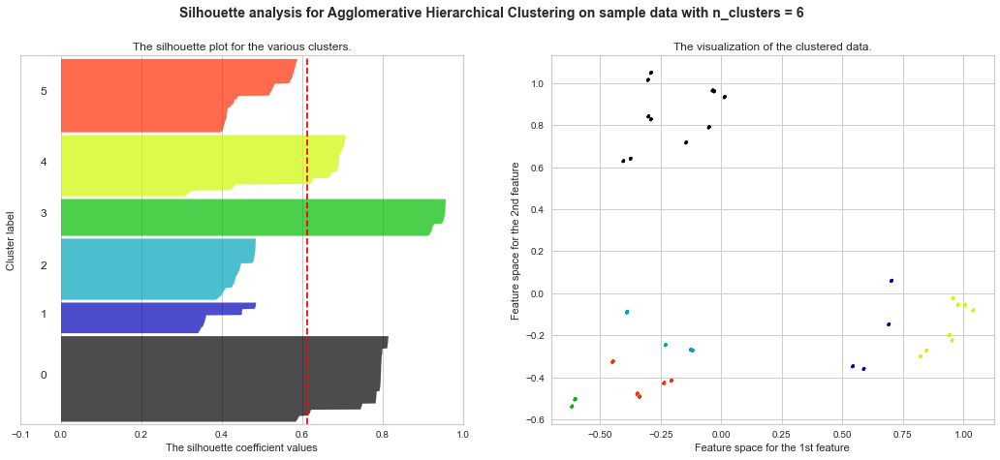

In [193]:
X = Weekly_array

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='ward')
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
   # centers = clusterer.cluster_centers_
   # centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
   # ax2.scatter(
    #    centers[:, 0],
    #    centers[:, 1],
    #    marker="o",
    #    c="white",
    #    alpha=1,
    #    s=200,
    #    edgecolor="k",
    #)

   # for i, c in enumerate(centers):
   #     ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for Agglomerative Hierarchical Clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )
plt.savefig('Silhouette_weekly.png', dpi=300, bbox_inches='tight')
plt.show()


The implementation of 3 clusters is corroborated as the best number to segment our data.

# C2. Fuzzy C-Means Clustering Model

In this section `Fuzzy C-Means` model is defined.

In [194]:
# Defining the Fuzzy C-Means model
def draw_optimal_Fuzzy(data, n_clusters=3, xlabel=None, ylabel=None, title=None):
    
    fcm = FCM(n_clusters=n_clusters)
    fcm.fit(data)
    
    y_fcm = fcm.predict(X)
   # outputs are stored fcm_centers and fcm_labels
    fcm_centers = fcm.centers 

    plt.figure(figsize=(20,10))
    plt.scatter(X[y_fcm==0, 0], X[y_fcm==0, 1], cmap='salmon', label='Cluster 0')
    plt.scatter(X[y_fcm==1, 0], X[y_fcm==1, 1], cmap='orchid', label='Cluster 1')
    plt.scatter(X[y_fcm==2, 0], X[y_fcm==2, 1], cmap='salmon', label='Cluster 2')
    plt.scatter(X[y_fcm==3, 0], X[y_fcm==3, 1], cmap='orchid', label='Cluster 3')
    #plt.scatter(X[y_fcm==4, 0], X[y_fcm==4, 1], cmap='salmon', label='Cluster 4')
    #plt.scatter(X[y_fcm==5, 0], X[y_fcm==5, 1], cmap='salmon', label='Cluster 5')
    
    plt.scatter(fcm_centers[:,0], fcm_centers[:,1], s=100, label='Centers')

    plt.legend()

    plt.title(title, fontsize = 20)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()

We develop a segmentation for 3 clusters.

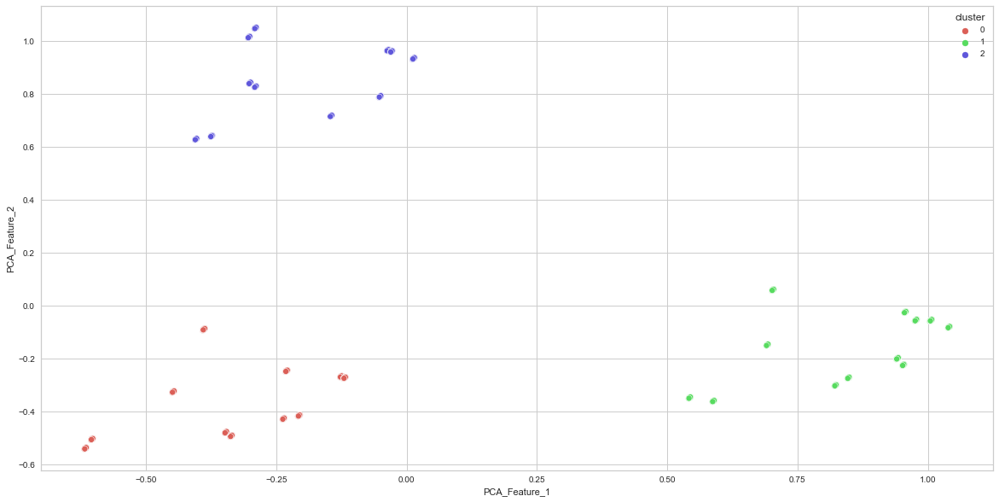

In [195]:
# Implementing Fuzzy C-Means Clustering with 3 clusters
clusters=3 #from above analysis for optimal value of k
fcm = FCM(n_clusters=clusters)
fcm.fit(Weekly_array)
y_fcm = fcm.predict(Weekly_array)

data = pd.DataFrame(Weekly_array, columns = ['PCA_Feature_1','PCA_Feature_2']) # features selected by using PCA
data['cluster'] = y_fcm

# Plot Showing Clusters using features [2] selected from PCA
plt.figure(figsize=(20,10))
sns.scatterplot(data=data, x=data.PCA_Feature_1, y=data.PCA_Feature_2, hue='cluster', palette=sns.color_palette("hls",clusters), legend="full")
plt.show()

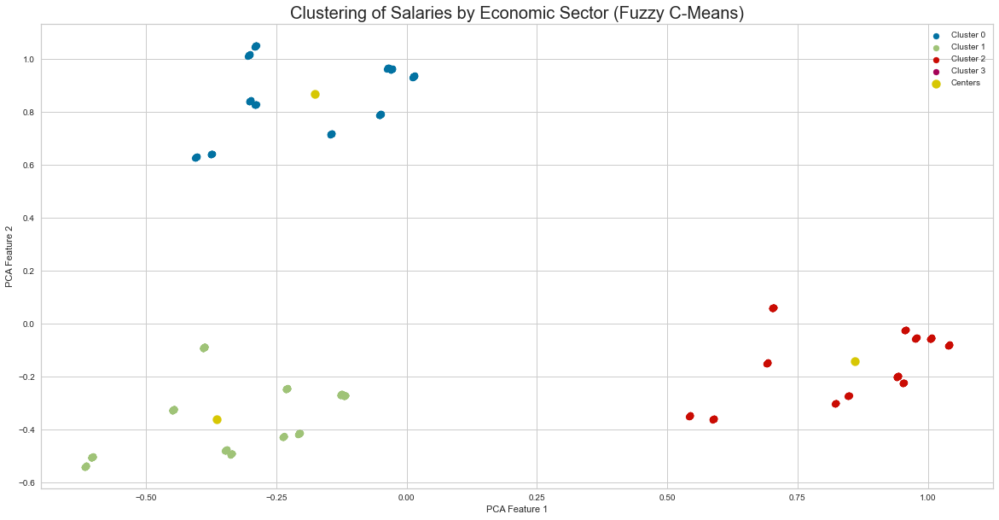

In [196]:
# Implementing Fuzzy C-Means Clustering with 3 clusters
X = Weekly_array
draw_optimal_Fuzzy(X,n_clusters=3, xlabel="PCA Feature 1", 
                      ylabel="PCA Feature 2", 
                      title="Clustering of Salaries by Economic Sector (Fuzzy C-Means)")

Perfectly well defined and separated clusters are obtained.

We build a new column with the results obtained.

In [197]:
#Adding a new column with the result of the segmentation of hourly wages with respect to Fuzzy C-Means
Agglomerative2['FCM_Weekly'] = pred
FCM2 = Agglomerative2.sort_values(by = 'FCM_Weekly', ignore_index=True)
FCM2.head()

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
0,2017-04-01,Accommodation and food service activities (I),338.48,1,Apr,2017,Saturday,12.66,163400,26.6,1,1,1,2,1,0
1,2008-07-01,Information and communication (J),950.53,1,Jul,2008,Tuesday,26.64,59600,36.0,1,1,1,2,1,0
2,2019-04-01,Wholesale and retail trade; repair of motor ve...,594.03,1,Apr,2019,Monday,19.25,297200,30.6,1,2,2,2,1,0
3,2020-01-01,Accommodation and food service activities (I),366.53,1,Jan,2020,Wednesday,13.53,174800,26.9,0,2,1,2,1,0
4,2014-04-01,Transportation and storage (H),742.93,1,Apr,2014,Tuesday,21.04,62300,35.3,1,0,1,2,1,0


And we analyze the corresponding evaluation.

In [198]:
# Analyzing the Silhouette Score for 3 clusters
X = Weekly_array
fcm = FCM(n_clusters=3)
fcm.fit(X)
y_fcm = fcm.predict(X)
  
    
score_fcm = silhouette_score(X, y_fcm)
score_fcm

0.7824004275569864

A silhouette value is close to 1 is obtained.

We analyze various segmentations and evaluate the results.

For n_clusters = 2 The average silhouette_score is : 0.5004554512093171
For n_clusters = 3 The average silhouette_score is : 0.7824004275569864
For n_clusters = 4 The average silhouette_score is : 0.6305855290981344
For n_clusters = 5 The average silhouette_score is : 0.6106915686043343
For n_clusters = 6 The average silhouette_score is : 0.6059089786110714


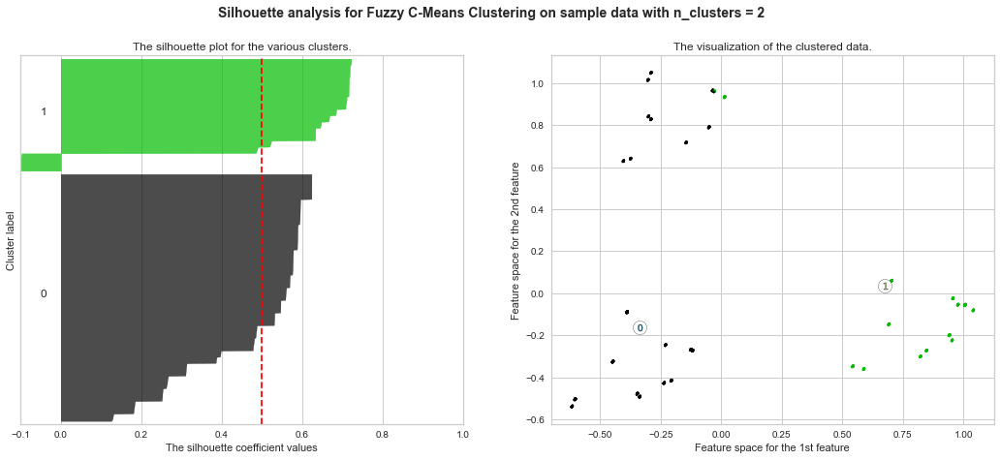

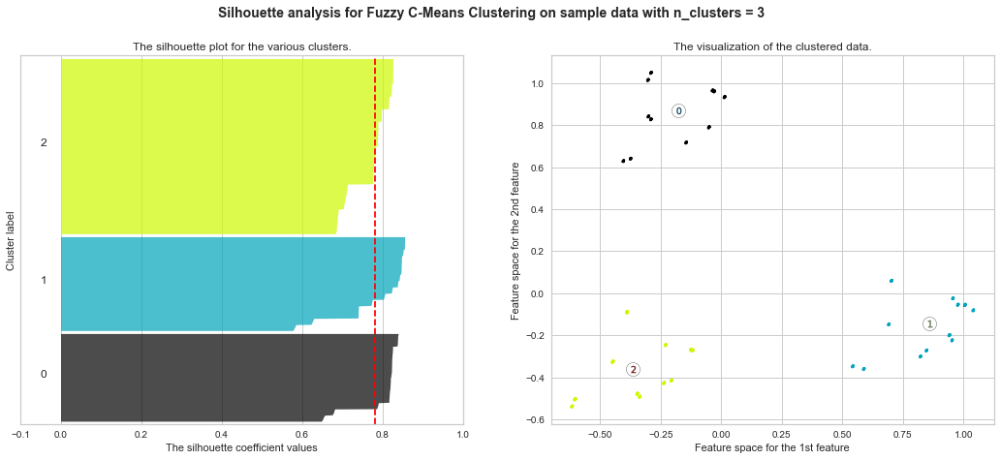

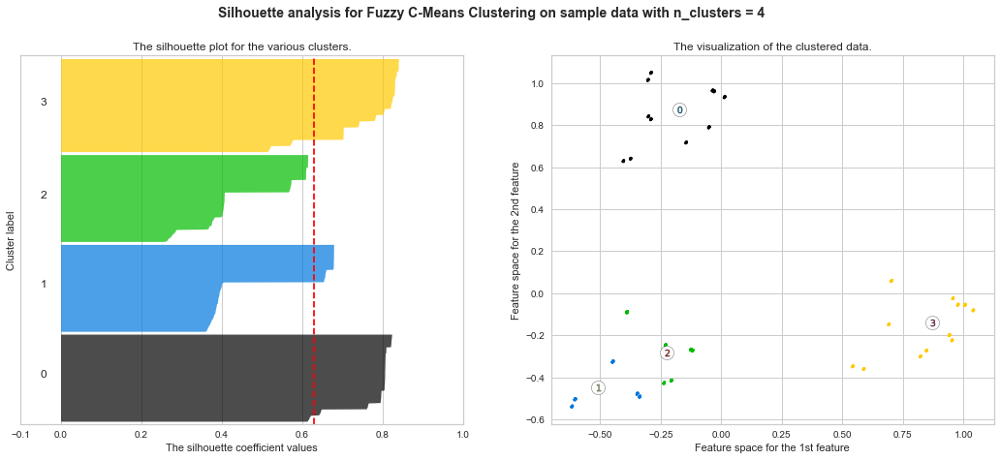

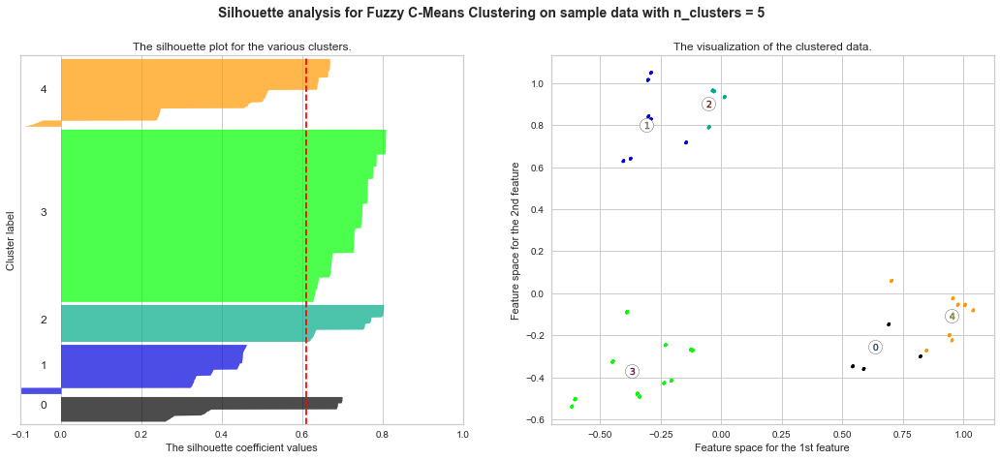

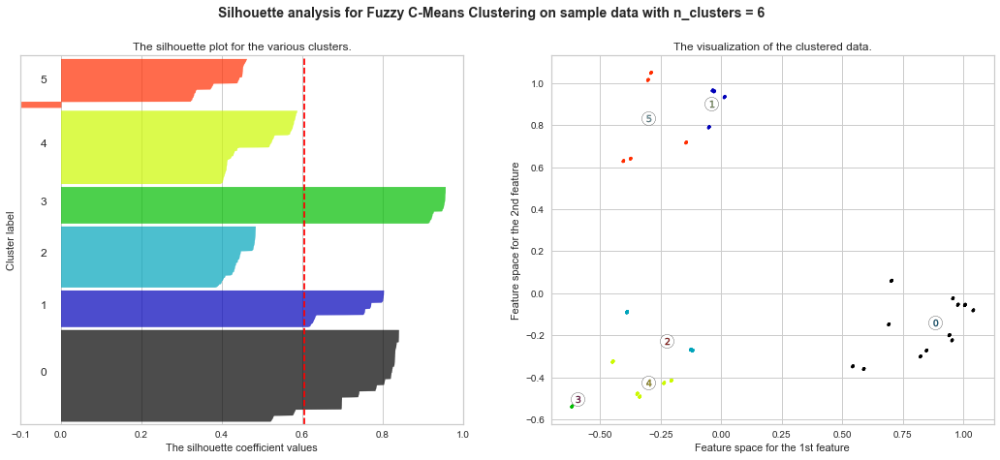

In [199]:
X = Weekly_array

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = FCM(n_clusters=n_clusters, random_state=10)
    clusterer.fit(X)
    cluster_labels = clusterer.predict(X)
    

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    #centers = clusterer.cluster_centers_
    centers = clusterer.centers
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for Fuzzy C-Means Clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )
plt.savefig('Silhouette_weekly.png', dpi=300, bbox_inches='tight')
plt.show()


The best evaluation corresponds to 3 segmentations.

# D2. K-Means vs. Hierarchical vs. C-Means Clustering

We test the three clustering algorithms to review the best performing one.

We graph our data before being segmented and proceed to apply the clustering models.

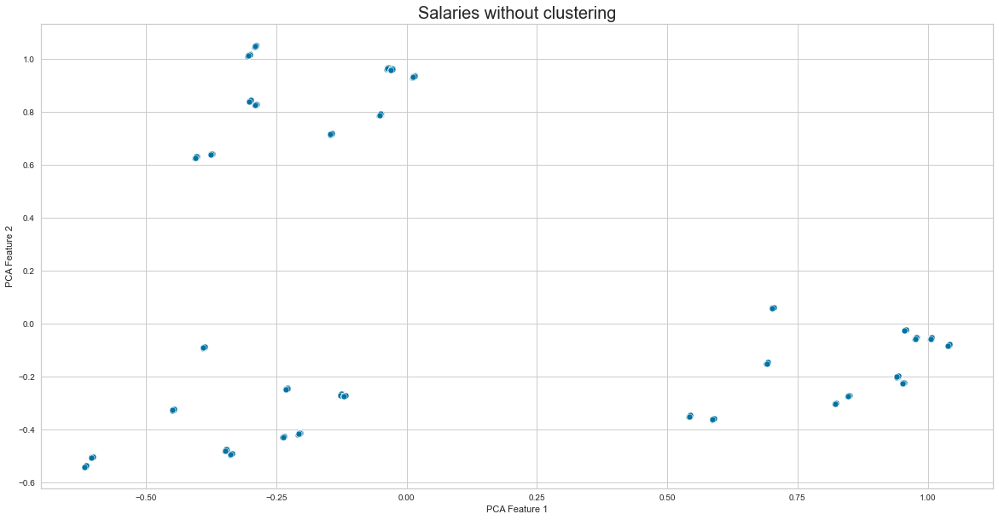

In [200]:
# Graphing the unsegmented data

Weekly_c = pd.DataFrame(Weekly_array, columns = ['PCA_Feature_1','PCA_Feature_2']) # features selected by using PCA

# Plot Showing Clusters using features [2] selected from PCA
plt.figure(figsize=(20,10))
sns.scatterplot(data=Weekly_c, x=Weekly_c.PCA_Feature_1, y=Weekly_c.PCA_Feature_2) 
plt.title("Salaries without clustering", fontsize = 20)
plt.xlabel("PCA Feature 1")
plt.ylabel("PCA Feature 2")
plt.savefig('Weekly.png', dpi=300, bbox_inches='tight')
plt.show()


In [201]:
# Generate clusters from K-Means
X = Weekly_array
km = KMeans(3)
km_clusters = km.fit_predict(X) 
# Generate clusters from Agglomerative Hierarchical Clustering
ac = AgglomerativeClustering(3, linkage='ward')
ac_clusters = ac.fit_predict(X)  

We plot the three clustering models and compare the results.

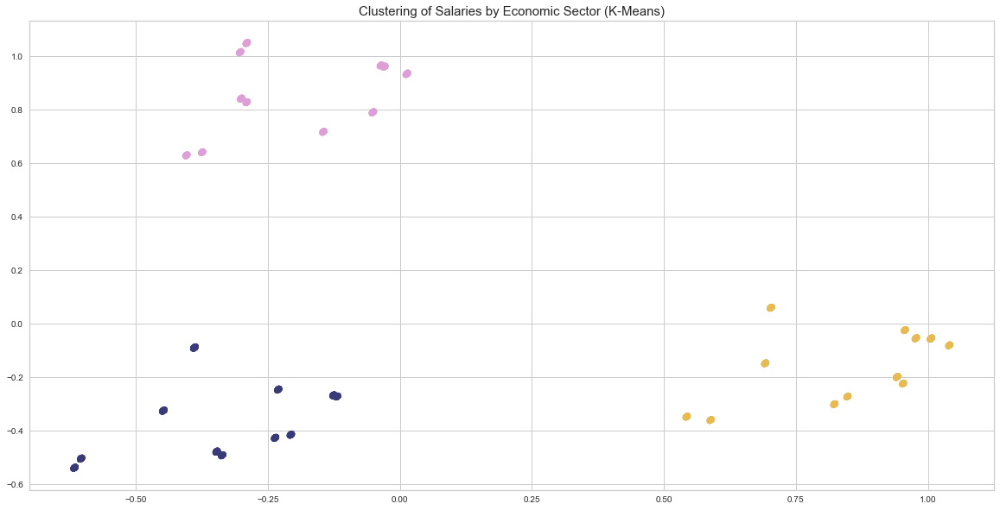

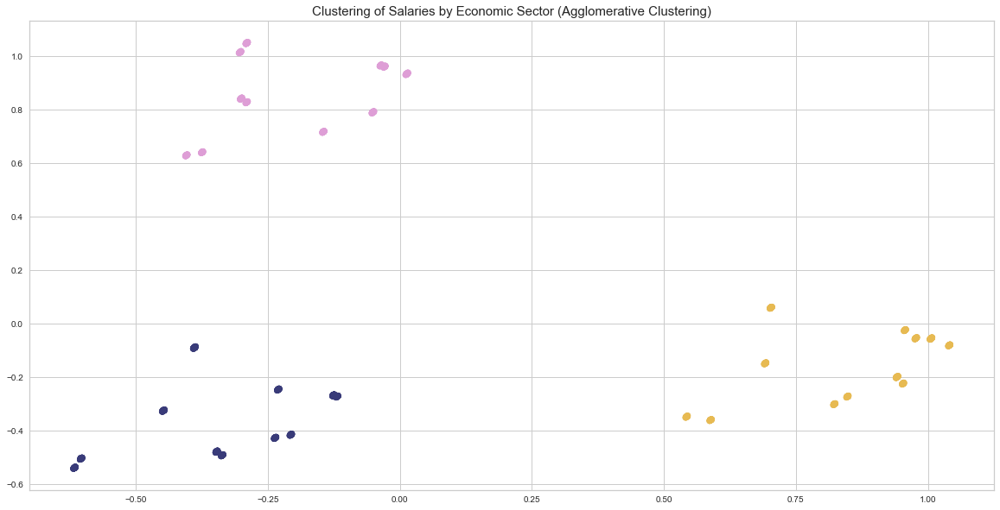

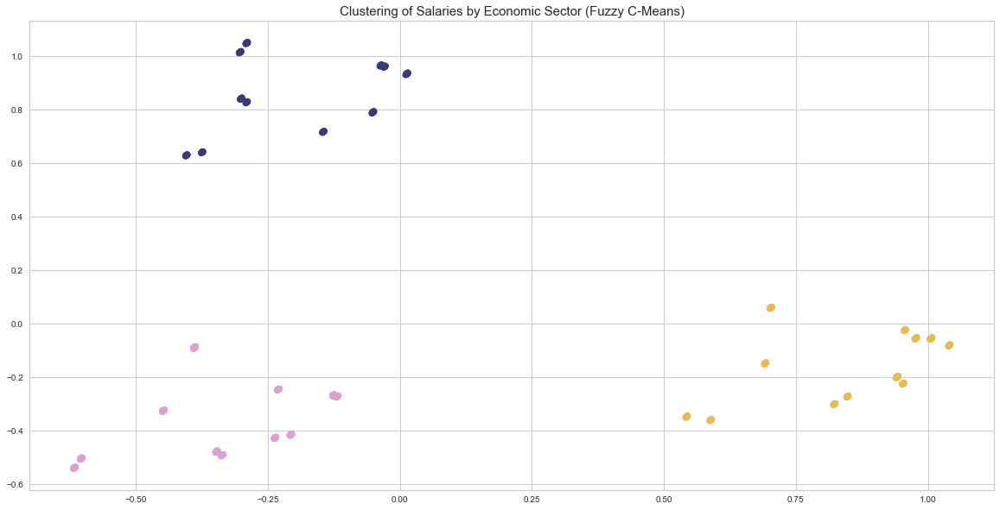

In [202]:
#Plotting the three algorithms ### K-Means vs. Hierarchical vs. C-Means Clustering
plt.figure(figsize=(20,10))
plt.title("Clustering of Salaries by Economic Sector (K-Means)", fontsize = 15)
plt.scatter(Weekly_c.PCA_Feature_1, Weekly_c.PCA_Feature_2, c=km_clusters,s=50, cmap='tab20b')
plt.show()

plt.figure(figsize=(20,10))
plt.title("Clustering of Salaries by Economic Sector (Agglomerative Clustering)", fontsize = 15)
plt.scatter(Weekly_c.PCA_Feature_1, Weekly_c.PCA_Feature_2, c=ac_clusters,s=50, cmap='tab20b')
plt.show()

plt.figure(figsize=(20,10))
plt.title("Clustering of Salaries by Economic Sector (Fuzzy C-Means)", fontsize = 15)
plt.scatter(Weekly_c.PCA_Feature_1, Weekly_c.PCA_Feature_2, c=y_fcm,s=50, cmap='tab20b')
plt.savefig('Results_Weekly.png', dpi=300, bbox_inches='tight')
plt.show()


We compare the evaluations of the Silhouette method

In [203]:
# Calculate Silhouette Scores
print("Silhouette Scores for PCA Salaries Clusters:\n")
print("K-Means Clustering: ", silhouette_score(pca_Weekly.values, km_clusters))
print("Agg Clustering: ", silhouette_score(pca_Weekly.values, ac_clusters))
print("Fuzzy C-Means Clustering: ", silhouette_score(pca_Weekly.values, y_fcm))

Silhouette Scores for PCA Salaries Clusters:

K-Means Clustering:  0.7824004275569864
Agg Clustering:  0.7824004275569864
Fuzzy C-Means Clustering:  0.7824004275569864


We can conclude that all the implemented models coincide with a perfect segmentation with a number of 3.

In [204]:
FCM2

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
0,2017-04-01,Accommodation and food service activities (I),338.48,1,Apr,2017,Saturday,12.66,163400,26.6,1,1,1,2,1,0
1,2008-07-01,Information and communication (J),950.53,1,Jul,2008,Tuesday,26.64,59600,36.0,1,1,1,2,1,0
2,2019-04-01,Wholesale and retail trade; repair of motor ve...,594.03,1,Apr,2019,Monday,19.25,297200,30.6,1,2,2,2,1,0
3,2020-01-01,Accommodation and food service activities (I),366.53,1,Jan,2020,Wednesday,13.53,174800,26.9,0,2,1,2,1,0
4,2014-04-01,Transportation and storage (H),742.93,1,Apr,2014,Tuesday,21.04,62300,35.3,1,0,1,2,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1192,2022-01-01,Industry (B to E),987.96,1,Jan,2022,Saturday,26.29,255100,38.1,0,2,1,2,2,2
1193,2020-01-01,Construction (F),842.38,1,Jan,2020,Wednesday,21.89,112400,38.0,0,2,1,2,2,2
1194,2015-01-01,Real estate activities (L),620.16,1,Jan,2015,Thursday,20.69,12600,30.0,0,0,0,1,2,2
1195,2021-07-01,"Financial, insurance and real estate activitie...",1232.88,1,Jul,2021,Thursday,35.63,119500,34.6,1,0,0,2,2,2


In [205]:
FCM2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1197 entries, 0 to 1196
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   Date             1197 non-null   datetime64[ns]
 1   Economic_Sector  1197 non-null   object        
 2   Weekly_Salary    1197 non-null   float64       
 3   Day              1197 non-null   int64         
 4   Month            1197 non-null   object        
 5   Year             1197 non-null   int64         
 6   Day of the week  1197 non-null   category      
 7   Hourly_Salary    1197 non-null   float64       
 8   Employees        1197 non-null   int32         
 9   Paid_Hours       1197 non-null   float64       
 10  KMeans_Hourly    1197 non-null   int32         
 11  HAC_Hourly       1197 non-null   int64         
 12  FCM_Hourly       1197 non-null   int64         
 13  KMeans_Weekly    1197 non-null   int32         
 14  HAC_Weekly       1197 non-null   int64  

In [206]:
#Analysing the total frequency by category
df['Economic Sector NACE Rev 2'].value_counts()

All NACE economic sectors                                                   3876
Administrative and support service activities (N)                           3876
Financial, insurance and real estate activities (K,L)                       3876
Electricity, water supply and waste management (D,E)                        3876
Industry (B to E)                                                           3876
Other service activities (S)                                                3876
Arts, entertainment and recreation (R)                                      3876
Human health and social work activities (Q)                                 3876
Education (P)                                                               3876
Public administration and defence; compulsory social security (O)           3876
Professional, scientific and technical activities (M)                       3876
Mining and quarrying (B)                                                    3876
Real estate activities (L)  

In [207]:
# select a subset of the dataframe with the chosen columns
Sector = FCM2.groupby('Economic_Sector')
Sector

In [285]:
print(KMeans_Hourly)

None


In [208]:
Education = Sector.get_group('Education (P)')


,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
17,2016-01-01,Education (P),802.32,1,Jan,2016,Friday,34.12,139600,23.5,0,0,1,2,1,0
31,2010-01-01,Education (P),860.38,1,Jan,2010,Friday,35.90,129900,23.8,0,0,2,0,0,0
44,2021-04-01,Education (P),934.29,1,Apr,2021,Thursday,38.16,194800,24.7,1,0,1,0,0,0
62,2019-07-01,Education (P),859.66,1,Jul,2019,Monday,36.72,169200,23.3,1,0,1,1,1,0
63,2008-07-01,Education (P),847.19,1,Jul,2008,Tuesday,35.03,128900,24.6,1,0,1,1,1,0
78,2011-01-01,Education (P),845.55,1,Jan,2011,Saturday,36.27,129200,23.1,0,2,0,1,2,0
104,2021-10-01,Education (P),933.06,1,Oct,2021,Friday,38.73,194600,23.9,2,2,1,0,0,0
144,2021-07-01,Education (P),950.74,1,Jul,2021,Thursday,38.54,190500,24.6,1,1,0,1,2,0
177,2017-10-01,Education (P),830.57,1,Oct,2017,Sunday,35.07,153000,23.8,2,1,0,1,0,0
187,2012-01-01,Education (P),842.88,1,Jan,2012,Sunday,35.82,128800,23.3,0,0,0,1,0,0


In [286]:
Education1 = Education.sort_values('Date',ascending=True)
Education1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
936,2008-01-01,Education (P),851.56,1,Jan,2008,Tuesday,33.92,133600,24.9,0,0,2,1,2,2
1059,2008-04-01,Education (P),878.58,1,Apr,2008,Tuesday,34.69,134800,25.2,1,0,2,1,0,2
63,2008-07-01,Education (P),847.19,1,Jul,2008,Tuesday,35.03,128900,24.6,1,0,1,1,1,0
264,2008-10-01,Education (P),894.71,1,Oct,2008,Wednesday,35.57,137200,25.1,2,0,0,2,0,0
307,2009-01-01,Education (P),902.09,1,Jan,2009,Thursday,36.26,135200,24.7,0,1,2,2,2,0
1170,2009-04-01,Education (P),891.87,1,Apr,2009,Wednesday,36.13,134200,24.6,1,1,1,2,0,2
861,2009-07-01,Education (P),896.77,1,Jul,2009,Wednesday,37.75,124700,24.1,1,0,0,1,1,1
735,2009-10-01,Education (P),866.52,1,Oct,2009,Thursday,36.58,131500,23.6,2,2,2,1,0,1
31,2010-01-01,Education (P),860.38,1,Jan,2010,Friday,35.90,129900,23.8,0,0,2,0,0,0
653,2010-04-01,Education (P),844.82,1,Apr,2010,Thursday,35.66,131100,23.5,1,0,0,2,2,1


In [210]:
Administrative = Sector.get_group('Administrative and support service activities (N)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
37,2014-10-01,Administrative and support service activities (N),495.54,1,Oct,2014,Wednesday,16.66,80200,29.9,2,1,0,2,1,0
46,2021-04-01,Administrative and support service activities (N),699.59,1,Apr,2021,Thursday,21.89,92100,31.7,1,0,1,0,0,0
70,2015-01-01,Administrative and support service activities (N),502.66,1,Jan,2015,Thursday,16.53,76000,30.0,0,0,0,1,1,0
102,2020-04-01,Administrative and support service activities (N),614.76,1,Apr,2020,Wednesday,20.06,87100,30.5,1,0,2,2,0,0
111,2020-07-01,Administrative and support service activities (N),633.44,1,Jul,2020,Wednesday,20.29,88400,31.3,1,1,1,2,2,0
200,2015-07-01,Administrative and support service activities (N),524.36,1,Jul,2015,Wednesday,17.04,83200,30.8,1,2,0,0,1,0
220,2014-07-01,Administrative and support service activities (N),488.54,1,Jul,2014,Tuesday,16.30,78000,30.1,1,1,0,0,1,0
257,2013-04-01,Administrative and support service activities (N),500.72,1,Apr,2013,Monday,16.54,67700,30.5,1,0,0,2,0,0
281,2008-10-01,Administrative and support service activities (N),491.66,1,Oct,2008,Wednesday,16.19,86200,30.5,2,0,0,2,0,0
282,2016-01-01,Administrative and support service activities (N),518.67,1,Jan,2016,Friday,17.42,84300,29.6,0,0,1,2,1,0


In [287]:
Administrative1 = Administrative.sort_values('Date',ascending=True)
Administrative1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
891,2008-01-01,Administrative and support service activities (N),503.36,1,Jan,2008,Tuesday,15.61,88700,32.0,0,0,0,1,1,1
1058,2008-04-01,Administrative and support service activities (N),487.90,1,Apr,2008,Tuesday,15.89,91500,30.8,1,0,2,1,0,2
921,2008-07-01,Administrative and support service activities (N),492.37,1,Jul,2008,Tuesday,16.04,90000,30.8,1,0,1,1,1,2
281,2008-10-01,Administrative and support service activities (N),491.66,1,Oct,2008,Wednesday,16.19,86200,30.5,2,0,0,2,0,0
613,2009-01-01,Administrative and support service activities (N),493.86,1,Jan,2009,Thursday,16.13,81300,30.3,0,1,2,2,2,1
1171,2009-04-01,Administrative and support service activities (N),496.34,1,Apr,2009,Wednesday,16.49,79800,30.2,1,1,1,2,0,2
713,2009-07-01,Administrative and support service activities (N),495.33,1,Jul,2009,Wednesday,16.77,79500,29.6,1,0,0,1,1,1
801,2009-10-01,Administrative and support service activities (N),497.90,1,Oct,2009,Thursday,16.56,73800,30.2,2,2,2,1,0,1
625,2010-01-01,Administrative and support service activities (N),495.07,1,Jan,2010,Friday,16.12,71600,30.4,0,0,1,0,2,1
321,2010-04-01,Administrative and support service activities (N),501.54,1,Apr,2010,Thursday,16.28,73700,30.9,1,0,0,2,0,0


In [211]:
Insurance = Sector.get_group('Financial, insurance and real estate activities (K,L)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
25,2017-04-01,"Financial, insurance and real estate activitie...",1070.81,1,Apr,2017,Saturday,30.66,92100,35.0,1,2,2,0,0,0
34,2013-10-01,"Financial, insurance and real estate activitie...",1019.70,1,Oct,2013,Tuesday,29.89,85900,34.1,2,2,0,1,0,0
58,2011-10-01,"Financial, insurance and real estate activitie...",968.46,1,Oct,2011,Saturday,28.67,89700,33.5,2,0,1,1,1,0
114,2008-01-01,"Financial, insurance and real estate activitie...",1052.60,1,Jan,2008,Tuesday,31.93,97500,33.9,0,0,1,2,2,0
125,2014-07-01,"Financial, insurance and real estate activitie...",1020.84,1,Jul,2014,Tuesday,29.51,92700,34.7,1,0,1,0,0,0
168,2012-01-01,"Financial, insurance and real estate activitie...",950.11,1,Jan,2012,Sunday,28.66,86800,33.9,0,0,0,1,0,0
178,2018-07-01,"Financial, insurance and real estate activitie...",1133.86,1,Jul,2018,Sunday,32.37,87400,35.1,1,1,0,1,0,0
230,2016-07-01,"Financial, insurance and real estate activitie...",1043.30,1,Jul,2016,Friday,29.74,93500,35.2,1,0,0,1,0,0
235,2009-07-01,"Financial, insurance and real estate activitie...",936.84,1,Jul,2009,Wednesday,28.11,97500,33.3,1,1,0,1,1,0
243,2022-01-01,"Financial, insurance and real estate activitie...",1245.83,1,Jan,2022,Saturday,35.98,117700,34.5,0,0,0,1,1,0


In [288]:
Insurance1 = Insurance.sort_values('Date',ascending=True)
Insurance1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
114,2008-01-01,"Financial, insurance and real estate activitie...",1052.60,1,Jan,2008,Tuesday,31.93,97500,33.9,0,0,1,2,2,0
511,2008-04-01,"Financial, insurance and real estate activitie...",1082.08,1,Apr,2008,Tuesday,31.80,97700,34.0,1,0,1,1,0,0
974,2008-07-01,"Financial, insurance and real estate activitie...",1008.63,1,Jul,2008,Tuesday,30.28,95800,33.5,1,0,1,1,1,2
1030,2008-10-01,"Financial, insurance and real estate activitie...",963.06,1,Oct,2008,Wednesday,27.94,93800,33.9,2,2,2,2,0,2
666,2009-01-01,"Financial, insurance and real estate activitie...",967.21,1,Jan,2009,Thursday,28.96,92200,33.6,0,1,0,1,1,1
881,2009-04-01,"Financial, insurance and real estate activitie...",938.25,1,Apr,2009,Wednesday,28.06,96100,33.4,1,0,0,1,1,1
235,2009-07-01,"Financial, insurance and real estate activitie...",936.84,1,Jul,2009,Wednesday,28.11,97500,33.3,1,1,0,1,1,0
986,2009-10-01,"Financial, insurance and real estate activitie...",962.82,1,Oct,2009,Thursday,28.78,94300,33.3,2,2,1,1,2,2
484,2010-01-01,"Financial, insurance and real estate activitie...",962.71,1,Jan,2010,Friday,28.68,91800,33.4,0,1,0,1,0,0
287,2010-04-01,"Financial, insurance and real estate activitie...",986.93,1,Apr,2010,Thursday,29.32,91300,33.6,1,0,2,1,1,0


In [212]:
Electricity = Sector.get_group('Electricity, water supply and waste management (D,E)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
33,2017-04-01,"Electricity, water supply and waste management...",1109.08,1,Apr,2017,Saturday,28.23,15500,38.0,1,2,2,0,0,0
36,2021-07-01,"Electricity, water supply and waste management...",1112.95,1,Jul,2021,Thursday,29.64,16500,37.4,1,0,0,2,0,0
59,2019-07-01,"Electricity, water supply and waste management...",1136.09,1,Jul,2019,Monday,29.98,16300,37.9,1,0,1,1,1,0
74,2012-01-01,"Electricity, water supply and waste management...",1065.13,1,Jan,2012,Sunday,28.35,12700,37.9,0,0,0,1,0,0
106,2014-07-01,"Electricity, water supply and waste management...",1037.44,1,Jul,2014,Tuesday,27.64,13700,37.7,1,0,0,2,2,0
150,2018-04-01,"Electricity, water supply and waste management...",1104.93,1,Apr,2018,Sunday,28.93,15300,38.6,1,0,2,2,0,0
155,2016-07-01,"Electricity, water supply and waste management...",1090.46,1,Jul,2016,Friday,29.13,14700,37.8,1,0,0,1,0,0
156,2018-10-01,"Electricity, water supply and waste management...",1098.43,1,Oct,2018,Monday,28.69,15700,38.3,2,2,2,0,0,0
236,2016-01-01,"Electricity, water supply and waste management...",1090.65,1,Jan,2016,Friday,28.35,13600,38.0,0,0,0,1,1,0
239,2013-10-01,"Electricity, water supply and waste management...",1014.86,1,Oct,2013,Tuesday,26.99,14000,37.9,2,2,0,1,1,0


In [289]:
Electricity1 = Electricity.sort_values('Date',ascending=True)
Electricity1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
1121,2008-01-01,"Electricity, water supply and waste management...",1171.86,1,Jan,2008,Tuesday,30.58,14500,37.7,0,0,2,2,0,2
722,2008-04-01,"Electricity, water supply and waste management...",1130.79,1,Apr,2008,Tuesday,29.91,14600,38.6,1,0,1,0,0,1
609,2008-07-01,"Electricity, water supply and waste management...",1155.79,1,Jul,2008,Tuesday,29.85,14800,38.4,1,0,1,1,1,1
1115,2008-10-01,"Electricity, water supply and waste management...",1130.55,1,Oct,2008,Wednesday,29.80,14600,38.1,2,0,1,2,2,2
1088,2009-01-01,"Electricity, water supply and waste management...",1164.99,1,Jan,2009,Thursday,30.58,14900,38.6,0,1,0,0,2,2
545,2009-04-01,"Electricity, water supply and waste management...",1168.76,1,Apr,2009,Wednesday,30.68,15100,37.7,1,0,2,1,1,0
866,2009-07-01,"Electricity, water supply and waste management...",1121.49,1,Jul,2009,Wednesday,29.24,15300,38.1,1,0,0,1,1,1
313,2009-10-01,"Electricity, water supply and waste management...",1148.36,1,Oct,2009,Thursday,29.89,15300,38.6,2,2,0,1,1,0
485,2010-01-01,"Electricity, water supply and waste management...",1139.03,1,Jan,2010,Friday,30.12,16100,37.5,0,1,0,1,0,0
530,2010-04-01,"Electricity, water supply and waste management...",1132.07,1,Apr,2010,Thursday,29.96,14700,38.3,1,0,2,1,2,0


In [213]:
Industry = Sector.get_group('Industry (B to E)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
23,2008-01-01,Industry (B to E),787.24,1,Jan,2008,Tuesday,20.40,234500,38.4,0,0,2,0,0,0
71,2016-01-01,Industry (B to E),850.36,1,Jan,2016,Friday,22.29,212000,38.3,0,0,0,1,1,0
92,2010-07-01,Industry (B to E),814.50,1,Jul,2010,Thursday,21.87,196900,37.3,1,2,1,2,2,0
113,2021-04-01,Industry (B to E),956.10,1,Apr,2021,Thursday,24.93,252300,38.0,1,0,1,2,2,0
126,2014-07-01,Industry (B to E),849.72,1,Jul,2014,Tuesday,22.23,199900,38.1,1,0,1,0,0,0
140,2009-10-01,Industry (B to E),809.56,1,Oct,2009,Thursday,21.99,198700,36.9,2,2,1,1,2,0
148,2008-04-01,Industry (B to E),786.64,1,Apr,2008,Tuesday,20.44,234500,38.5,1,0,1,0,0,0
151,2012-01-01,Industry (B to E),815.06,1,Jan,2012,Sunday,21.76,186600,37.3,0,0,0,1,0,0
277,2013-04-01,Industry (B to E),815.22,1,Apr,2013,Monday,21.86,194100,37.3,1,0,0,2,0,0
284,2015-01-01,Industry (B to E),839.39,1,Jan,2015,Thursday,22.02,207200,38.1,0,0,1,2,1,0


In [290]:
Industry1 = Industry.sort_values('Date',ascending=True)
Industry1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
23,2008-01-01,Industry (B to E),787.24,1,Jan,2008,Tuesday,20.40,234500,38.4,0,0,2,0,0,0
148,2008-04-01,Industry (B to E),786.64,1,Apr,2008,Tuesday,20.44,234500,38.5,1,0,1,0,0,0
675,2008-07-01,Industry (B to E),797.59,1,Jul,2008,Tuesday,20.71,229100,38.5,1,0,1,1,1,1
1176,2008-10-01,Industry (B to E),807.24,1,Oct,2008,Wednesday,21.24,221100,38.3,2,0,2,0,0,2
823,2009-01-01,Industry (B to E),801.96,1,Jan,2009,Thursday,21.49,215200,36.9,0,1,0,1,0,1
943,2009-04-01,Industry (B to E),797.61,1,Apr,2009,Wednesday,21.50,209800,37.1,1,0,2,2,1,2
865,2009-07-01,Industry (B to E),788.75,1,Jul,2009,Wednesday,21.66,203100,36.6,1,0,0,1,1,1
140,2009-10-01,Industry (B to E),809.56,1,Oct,2009,Thursday,21.99,198700,36.9,2,2,1,1,2,0
935,2010-01-01,Industry (B to E),810.38,1,Jan,2010,Friday,21.75,194400,37.1,0,0,1,1,0,2
532,2010-04-01,Industry (B to E),816.47,1,Apr,2010,Thursday,21.95,194000,37.3,1,0,2,1,2,0


In [214]:
Other = Sector.get_group('Other service activities (S)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
22,2008-01-01,Other service activities (S),546.64,1,Jan,2008,Tuesday,16.69,25300,32.8,0,0,2,0,0,0
28,2010-01-01,Other service activities (S),465.00,1,Jan,2010,Friday,15.54,21500,29.9,0,0,2,0,0,0
42,2021-04-01,Other service activities (S),504.32,1,Apr,2021,Thursday,18.24,25000,27.6,1,0,1,0,0,0
65,2020-07-01,Other service activities (S),516.74,1,Jul,2020,Wednesday,17.62,28200,29.3,1,0,2,2,1,0
72,2016-01-01,Other service activities (S),449.28,1,Jan,2016,Friday,16.14,22800,27.8,0,0,0,1,1,0
77,2010-07-01,Other service activities (S),484.34,1,Jul,2010,Thursday,16.30,21400,29.6,1,2,1,2,2,0
146,2016-07-01,Other service activities (S),451.42,1,Jul,2016,Friday,16.26,24300,27.7,1,0,0,1,1,0
149,2008-04-01,Other service activities (S),524.37,1,Apr,2008,Tuesday,16.81,25000,31.3,1,0,1,0,0,0
165,2015-10-01,Other service activities (S),434.20,1,Oct,2015,Thursday,15.75,23800,27.6,2,0,0,2,0,0
172,2008-10-01,Other service activities (S),504.59,1,Oct,2008,Wednesday,16.53,23000,30.4,2,0,0,2,0,0


In [291]:
Other1 = Other.sort_values('Date',ascending=True)
Other1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
22,2008-01-01,Other service activities (S),546.64,1,Jan,2008,Tuesday,16.69,25300,32.8,0,0,2,0,0,0
149,2008-04-01,Other service activities (S),524.37,1,Apr,2008,Tuesday,16.81,25000,31.3,1,0,1,0,0,0
670,2008-07-01,Other service activities (S),531.36,1,Jul,2008,Tuesday,16.97,24100,31.3,1,0,1,1,1,1
172,2008-10-01,Other service activities (S),504.59,1,Oct,2008,Wednesday,16.53,23000,30.4,2,0,0,2,0,0
822,2009-01-01,Other service activities (S),505.64,1,Jan,2009,Thursday,16.77,22500,30.1,0,1,0,1,0,1
584,2009-04-01,Other service activities (S),497.28,1,Apr,2009,Wednesday,16.36,22400,30.5,1,0,0,1,0,0
864,2009-07-01,Other service activities (S),485.05,1,Jul,2009,Wednesday,15.94,24400,30.4,1,0,0,1,1,1
1183,2009-10-01,Other service activities (S),499.07,1,Oct,2009,Thursday,16.20,23200,30.7,2,2,1,1,2,2
28,2010-01-01,Other service activities (S),465.00,1,Jan,2010,Friday,15.54,21500,29.9,0,0,2,0,0,0
455,2010-04-01,Other service activities (S),461.61,1,Apr,2010,Thursday,15.70,20600,29.6,1,0,2,1,1,0


In [215]:
Arts = Sector.get_group('Arts, entertainment and recreation (R)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
21,2008-01-01,"Arts, entertainment and recreation (R)",455.68,1,Jan,2008,Tuesday,15.50,28500,29.5,0,0,2,0,0,0
29,2010-01-01,"Arts, entertainment and recreation (R)",463.75,1,Jan,2010,Friday,16.49,23200,28.3,0,0,2,0,0,0
68,2021-07-01,"Arts, entertainment and recreation (R)",612.59,1,Jul,2021,Thursday,21.20,25800,29.1,1,1,0,1,1,0
79,2011-01-01,"Arts, entertainment and recreation (R)",422.41,1,Jan,2011,Saturday,15.24,25800,27.1,0,2,0,1,2,0
80,2015-07-01,"Arts, entertainment and recreation (R)",500.48,1,Jul,2015,Wednesday,18.05,27400,28.0,1,2,0,1,2,0
93,2021-04-01,"Arts, entertainment and recreation (R)",621.23,1,Apr,2021,Thursday,22.20,21700,28.2,1,0,1,2,2,0
98,2009-04-01,"Arts, entertainment and recreation (R)",449.64,1,Apr,2009,Wednesday,16.13,24400,27.8,1,0,2,2,0,0
109,2010-07-01,"Arts, entertainment and recreation (R)",491.94,1,Jul,2010,Thursday,17.27,25800,28.1,1,2,1,2,2,0
129,2008-04-01,"Arts, entertainment and recreation (R)",459.63,1,Apr,2008,Tuesday,15.56,29600,29.8,1,0,1,0,0,0
170,2012-01-01,"Arts, entertainment and recreation (R)",445.76,1,Jan,2012,Sunday,16.08,25900,28.0,0,0,0,1,0,0


In [292]:
Arts1 = Arts.sort_values('Date',ascending=True)
Arts1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
483,2008-01-01,"Arts, entertainment, recreation and other serv...",498.01,1,Jan,2008,Tuesday,16.03,53800,30.9,0,1,0,1,0,0
952,2008-04-01,"Arts, entertainment, recreation and other serv...",488.69,1,Apr,2008,Tuesday,16.16,54600,30.5,1,0,1,1,0,2
724,2008-07-01,"Arts, entertainment, recreation and other serv...",504.09,1,Jul,2008,Tuesday,16.48,53200,30.6,1,1,1,0,0,1
294,2008-10-01,"Arts, entertainment, recreation and other serv...",499.07,1,Oct,2008,Wednesday,16.62,50800,29.8,2,1,0,2,1,0
1037,2009-01-01,"Arts, entertainment, recreation and other serv...",481.72,1,Jan,2009,Thursday,16.53,48800,29.3,0,0,1,1,0,2
559,2009-04-01,"Arts, entertainment, recreation and other serv...",472.72,1,Apr,2009,Wednesday,16.28,46800,29.0,1,2,0,1,0,0
840,2009-07-01,"Arts, entertainment, recreation and other serv...",461.02,1,Jul,2009,Wednesday,15.90,48300,29.0,1,0,0,0,0,1
636,2009-10-01,"Arts, entertainment, recreation and other serv...",478.03,1,Oct,2009,Thursday,16.18,47600,29.4,2,0,0,2,2,1
1016,2010-01-01,"Arts, entertainment, recreation and other serv...",464.38,1,Jan,2010,Friday,15.98,44700,29.0,0,0,1,0,1,2
1052,2010-04-01,"Arts, entertainment, recreation and other serv...",469.99,1,Apr,2010,Thursday,16.47,44300,28.7,1,2,0,1,0,2


In [216]:
Health = Sector.get_group('Human health and social work activities (Q)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
24,2009-01-01,Human health and social work activities (Q),748.16,1,Jan,2009,Thursday,24.71,205400,30.1,0,0,2,0,0,0
30,2010-01-01,Human health and social work activities (Q),735.96,1,Jan,2010,Friday,23.63,210500,31.0,0,0,2,0,0,0
43,2021-04-01,Human health and social work activities (Q),780.18,1,Apr,2021,Thursday,24.37,261600,32.2,1,0,1,0,0,0
64,2008-07-01,Human health and social work activities (Q),727.95,1,Jul,2008,Tuesday,23.84,208100,30.6,1,0,1,1,1,0
69,2013-10-01,Human health and social work activities (Q),675.45,1,Oct,2013,Tuesday,22.35,226000,30.1,2,2,0,1,1,0
116,2018-07-01,Human health and social work activities (Q),718.47,1,Jul,2018,Sunday,22.86,240600,31.5,1,1,1,0,0,0
132,2008-04-01,Human health and social work activities (Q),748.28,1,Apr,2008,Tuesday,23.87,206700,31.1,1,0,1,0,0,0
137,2021-07-01,Human health and social work activities (Q),797.48,1,Jul,2021,Thursday,24.67,263000,32.1,1,1,0,1,2,0
174,2013-04-01,Human health and social work activities (Q),700.22,1,Apr,2013,Monday,23.13,219300,30.2,1,0,0,2,0,0
176,2010-04-01,Human health and social work activities (Q),727.14,1,Apr,2010,Thursday,23.73,213000,30.6,1,0,0,2,0,0


In [293]:
Health1 = Health.sort_values('Date',ascending=True)
Health1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
205,2008-01-01,Human health and social work activities (Q),716.49,1,Jan,2008,Tuesday,23.23,206000,30.8,0,0,2,1,1,0
132,2008-04-01,Human health and social work activities (Q),748.28,1,Apr,2008,Tuesday,23.87,206700,31.1,1,0,1,0,0,0
64,2008-07-01,Human health and social work activities (Q),727.95,1,Jul,2008,Tuesday,23.84,208100,30.6,1,0,1,1,1,0
227,2008-10-01,Human health and social work activities (Q),768.20,1,Oct,2008,Wednesday,24.98,210200,30.8,2,0,0,2,0,0
24,2009-01-01,Human health and social work activities (Q),748.16,1,Jan,2009,Thursday,24.71,205400,30.1,0,0,2,0,0,0
1060,2009-04-01,Human health and social work activities (Q),753.55,1,Apr,2009,Wednesday,24.81,209500,30.4,1,0,2,1,0,2
862,2009-07-01,Human health and social work activities (Q),757.87,1,Jul,2009,Wednesday,24.83,212800,30.7,1,0,0,1,1,1
734,2009-10-01,Human health and social work activities (Q),772.88,1,Oct,2009,Thursday,25.21,212000,30.7,2,2,2,1,0,1
30,2010-01-01,Human health and social work activities (Q),735.96,1,Jan,2010,Friday,23.63,210500,31.0,0,0,2,0,0,0
176,2010-04-01,Human health and social work activities (Q),727.14,1,Apr,2010,Thursday,23.73,213000,30.6,1,0,0,2,0,0


In [217]:
Public = Sector.get_group('Public administration and defence; compulsory social security (O)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
38,2019-07-01,Public administration and defence; compulsory ...,979.54,1,Jul,2019,Monday,26.25,139000,37.2,1,0,1,1,1,0
45,2021-04-01,Public administration and defence; compulsory ...,1013.09,1,Apr,2021,Thursday,28.11,156100,35.9,1,0,1,0,0,0
101,2020-04-01,Public administration and defence; compulsory ...,988.65,1,Apr,2020,Wednesday,26.70,144800,36.9,1,0,2,2,0,0
128,2008-04-01,Public administration and defence; compulsory ...,972.91,1,Apr,2008,Tuesday,27.62,121600,35.5,1,0,1,0,0,0
171,2012-01-01,Public administration and defence; compulsory ...,928.32,1,Jan,2012,Sunday,26.32,107600,35.7,0,0,0,1,0,0
201,2015-07-01,Public administration and defence; compulsory ...,925.51,1,Jul,2015,Wednesday,25.45,113600,36.4,1,2,0,0,1,0
214,2012-04-01,Public administration and defence; compulsory ...,923.77,1,Apr,2012,Sunday,26.21,107500,35.4,1,1,0,0,1,0
221,2014-07-01,Public administration and defence; compulsory ...,921.50,1,Jul,2014,Tuesday,25.52,109500,36.0,1,1,0,0,1,0
228,2008-10-01,Public administration and defence; compulsory ...,980.33,1,Oct,2008,Wednesday,27.75,119600,35.3,2,0,0,2,0,0
231,2020-07-01,Public administration and defence; compulsory ...,990.39,1,Jul,2020,Wednesday,26.74,144500,37.1,1,1,2,0,0,0


In [294]:
Public1 = Public.sort_values('Date',ascending=True)
Public1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
1078,2008-01-01,Public administration and defence; compulsory ...,957.48,1,Jan,2008,Tuesday,27.74,118500,35.0,0,0,2,0,0,2
128,2008-04-01,Public administration and defence; compulsory ...,972.91,1,Apr,2008,Tuesday,27.62,121600,35.5,1,0,1,0,0,0
756,2008-07-01,Public administration and defence; compulsory ...,968.00,1,Jul,2008,Tuesday,26.87,120500,35.7,1,0,0,0,0,1
228,2008-10-01,Public administration and defence; compulsory ...,980.33,1,Oct,2008,Wednesday,27.75,119600,35.3,2,0,0,2,0,0
306,2009-01-01,Public administration and defence; compulsory ...,987.90,1,Jan,2009,Thursday,27.67,117800,35.7,0,1,2,2,2,0
868,2009-04-01,Public administration and defence; compulsory ...,984.42,1,Apr,2009,Wednesday,27.85,118400,35.5,1,0,0,1,1,1
828,2009-07-01,Public administration and defence; compulsory ...,997.94,1,Jul,2009,Wednesday,27.76,115300,35.8,1,0,1,1,0,1
404,2009-10-01,Public administration and defence; compulsory ...,997.05,1,Oct,2009,Thursday,27.68,116800,35.9,2,2,2,2,1,0
1158,2010-01-01,Public administration and defence; compulsory ...,933.12,1,Jan,2010,Friday,26.36,114500,35.4,0,0,1,2,0,2
535,2010-04-01,Public administration and defence; compulsory ...,946.86,1,Apr,2010,Thursday,26.27,116300,36.2,1,0,2,1,2,0


In [218]:
Professional = Sector.get_group('Professional, scientific and technical activities (M)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
8,2009-04-01,"Professional, scientific and technical activit...",805.91,1,Apr,2009,Wednesday,24.61,73600,32.7,1,1,1,2,1,0
15,2018-10-01,"Professional, scientific and technical activit...",913.08,1,Oct,2018,Monday,26.99,94400,34.0,2,1,0,2,1,0
47,2021-04-01,"Professional, scientific and technical activit...",1035.36,1,Apr,2021,Thursday,29.69,115500,34.8,1,0,1,0,0,0
56,2013-10-01,"Professional, scientific and technical activit...",817.85,1,Oct,2013,Tuesday,24.83,81900,32.8,2,0,0,1,1,0
66,2015-10-01,"Professional, scientific and technical activit...",822.10,1,Oct,2015,Thursday,24.65,89100,33.1,2,0,0,1,1,0
141,2014-10-01,"Professional, scientific and technical activit...",788.30,1,Oct,2014,Wednesday,24.54,84500,32.2,2,1,0,1,2,0
199,2015-07-01,"Professional, scientific and technical activit...",816.85,1,Jul,2015,Wednesday,25.04,94000,32.7,1,2,0,0,1,0
213,2019-01-01,"Professional, scientific and technical activit...",903.47,1,Jan,2019,Tuesday,26.50,98300,33.9,0,0,0,0,1,0
219,2014-07-01,"Professional, scientific and technical activit...",785.16,1,Jul,2014,Tuesday,24.19,84200,32.3,1,1,0,0,1,0
258,2013-04-01,"Professional, scientific and technical activit...",816.14,1,Apr,2013,Monday,24.57,74600,33.3,1,0,0,2,0,0


In [295]:
Professional1 = Professional.sort_values('Date',ascending=True)
Professional1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
883,2008-01-01,"Professional, scientific and technical activit...",781.81,1,Jan,2008,Tuesday,23.68,81600,32.7,0,0,0,1,1,1
1056,2008-04-01,"Professional, scientific and technical activit...",811.55,1,Apr,2008,Tuesday,24.85,83600,32.7,1,0,2,1,0,2
755,2008-07-01,"Professional, scientific and technical activit...",818.68,1,Jul,2008,Tuesday,25.00,82800,32.8,1,0,0,0,0,1
280,2008-10-01,"Professional, scientific and technical activit...",836.35,1,Oct,2008,Wednesday,25.38,80000,33.0,2,0,0,2,0,0
310,2009-01-01,"Professional, scientific and technical activit...",817.68,1,Jan,2009,Thursday,24.88,75800,32.8,0,1,2,2,2,0
8,2009-04-01,"Professional, scientific and technical activit...",805.91,1,Apr,2009,Wednesday,24.61,73600,32.7,1,1,1,2,1,0
1024,2009-07-01,"Professional, scientific and technical activit...",811.84,1,Jul,2009,Wednesday,25.01,71600,32.7,1,2,0,1,1,2
732,2009-10-01,"Professional, scientific and technical activit...",805.68,1,Oct,2009,Thursday,24.68,71500,32.3,2,2,2,1,0,1
871,2010-01-01,"Professional, scientific and technical activit...",825.04,1,Jan,2010,Friday,25.72,72800,32.4,0,0,1,0,1,1
551,2010-04-01,"Professional, scientific and technical activit...",813.85,1,Apr,2010,Thursday,25.31,72000,32.1,1,0,2,1,1,0


In [219]:
Mining = Sector.get_group('Mining and quarrying (B)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
7,2009-04-01,Mining and quarrying (B),813.95,1,Apr,2009,Wednesday,20.71,6300,39.0,1,1,1,2,1,0
60,2008-01-01,Mining and quarrying (B),970.42,1,Jan,2008,Tuesday,21.91,7100,44.1,0,0,1,1,1,0
90,2021-04-01,Mining and quarrying (B),998.89,1,Apr,2021,Thursday,25.32,4200,39.1,1,0,1,2,2,0
110,2008-07-01,Mining and quarrying (B),872.90,1,Jul,2008,Tuesday,20.72,7800,41.8,1,0,0,2,2,0
115,2019-04-01,Mining and quarrying (B),943.19,1,Apr,2019,Monday,23.29,8100,40.1,1,1,1,0,0,0
138,2015-07-01,Mining and quarrying (B),954.30,1,Jul,2015,Wednesday,25.60,7100,37.9,1,0,0,0,2,0
147,2016-10-01,Mining and quarrying (B),920.50,1,Oct,2016,Saturday,22.83,4600,40.2,2,2,0,1,0,0
164,2015-10-01,Mining and quarrying (B),914.41,1,Oct,2015,Thursday,23.66,5000,38.0,2,0,0,2,0,0
183,2017-01-01,Mining and quarrying (B),903.24,1,Jan,2017,Sunday,22.74,5400,39.4,0,0,0,1,0,0
185,2011-01-01,Mining and quarrying (B),919.88,1,Jan,2011,Saturday,24.21,4700,37.6,0,0,0,1,0,0


In [296]:
Mining1 = Mining.sort_values('Date',ascending=True)
Mining1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
60,2008-01-01,Mining and quarrying (B),970.42,1,Jan,2008,Tuesday,21.91,7100,44.1,0,0,1,1,1,0
916,2008-04-01,Mining and quarrying (B),936.70,1,Apr,2008,Tuesday,21.15,7300,44.0,1,1,2,1,2,2
110,2008-07-01,Mining and quarrying (B),872.90,1,Jul,2008,Tuesday,20.72,7800,41.8,1,0,0,2,2,0
292,2008-10-01,Mining and quarrying (B),878.92,1,Oct,2008,Wednesday,21.28,7200,42.0,2,1,0,1,1,0
717,2009-01-01,Mining and quarrying (B),874.49,1,Jan,2009,Thursday,21.67,7300,40.1,0,0,1,0,0,1
7,2009-04-01,Mining and quarrying (B),813.95,1,Apr,2009,Wednesday,20.71,6300,39.0,1,1,1,2,1,0
586,2009-07-01,Mining and quarrying (B),877.01,1,Jul,2009,Wednesday,22.96,6100,38.2,1,2,0,1,0,0
541,2009-10-01,Mining and quarrying (B),900.81,1,Oct,2009,Thursday,23.28,5400,39.2,2,0,0,0,1,0
271,2010-01-01,Mining and quarrying (B),875.67,1,Jan,2010,Friday,21.84,5300,39.6,0,0,1,2,1,0
340,2010-04-01,Mining and quarrying (B),873.50,1,Apr,2010,Thursday,22.34,6600,39.0,1,2,1,1,2,0


In [220]:
Real = Sector.get_group('Real estate activities (L)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
99,2016-01-01,Real estate activities (L),780.41,1,Jan,2016,Friday,24.56,10100,31.6,0,0,1,2,0,0
100,2021-04-01,Real estate activities (L),741.62,1,Apr,2021,Thursday,24.16,10200,30.9,1,0,2,2,0,0
131,2008-10-01,Real estate activities (L),673.88,1,Oct,2008,Wednesday,20.90,10200,32.3,2,1,2,1,2,0
198,2015-07-01,Real estate activities (L),745.55,1,Jul,2015,Wednesday,23.65,10500,31.6,1,2,0,0,1,0
211,2019-01-01,Real estate activities (L),747.62,1,Jan,2019,Tuesday,24.49,10100,30.6,0,0,0,0,1,0
225,2014-07-01,Real estate activities (L),571.79,1,Jul,2014,Tuesday,18.64,10400,30.6,1,1,0,0,1,0
259,2013-04-01,Real estate activities (L),591.72,1,Apr,2013,Monday,19.61,9300,30.1,1,0,0,2,0,0
265,2019-10-01,Real estate activities (L),726.14,1,Oct,2019,Tuesday,23.55,10500,30.8,2,1,0,1,1,0
272,2018-10-01,Real estate activities (L),731.51,1,Oct,2018,Monday,24.32,11700,30.0,2,1,2,2,1,0
274,2016-10-01,Real estate activities (L),736.34,1,Oct,2016,Saturday,23.70,12000,31.0,2,1,2,2,1,0


In [297]:
Real1 = Real.sort_values('Date',ascending=True)
Real1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
884,2008-01-01,Real estate activities (L),745.58,1,Jan,2008,Tuesday,21.75,11200,34.4,0,0,0,1,1,1
572,2008-04-01,Real estate activities (L),769.59,1,Apr,2008,Tuesday,21.90,11200,35.0,1,0,0,1,0,0
475,2008-07-01,Real estate activities (L),743.08,1,Jul,2008,Tuesday,21.94,10800,33.6,1,0,1,1,0,0
131,2008-10-01,Real estate activities (L),673.88,1,Oct,2008,Wednesday,20.90,10200,32.3,2,1,2,1,2,0
615,2009-01-01,Real estate activities (L),658.24,1,Jan,2009,Thursday,20.52,8100,32.3,0,1,2,2,2,1
322,2009-04-01,Real estate activities (L),614.31,1,Apr,2009,Wednesday,19.49,9600,31.3,1,2,1,1,2,0
305,2009-07-01,Real estate activities (L),600.93,1,Jul,2009,Wednesday,18.48,10900,32.2,1,2,0,0,2,0
486,2009-10-01,Real estate activities (L),601.27,1,Oct,2009,Thursday,19.01,8400,31.7,2,2,2,0,2,0
715,2010-01-01,Real estate activities (L),556.48,1,Jan,2010,Friday,18.04,9500,31.4,0,0,1,0,0,1
1054,2010-04-01,Real estate activities (L),552.80,1,Apr,2010,Thursday,17.24,9200,31.8,1,2,0,1,0,2


In [221]:
Financial = Sector.get_group('Financial and insurance activities (K)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
27,2010-01-01,Financial and insurance activities (K),1000.57,1,Jan,2010,Friday,29.85,82300,33.6,0,0,2,0,0,0
48,2021-04-01,Financial and insurance activities (K),1283.67,1,Apr,2021,Thursday,36.59,101400,35.1,1,0,1,0,0,0
86,2015-01-01,Financial and insurance activities (K),1050.73,1,Jan,2015,Thursday,31.09,78400,34.8,0,0,0,1,2,0
95,2008-10-01,Financial and insurance activities (K),1008.97,1,Oct,2008,Wednesday,28.84,83600,34.0,2,1,2,2,2,0
97,2019-04-01,Financial and insurance activities (K),1215.91,1,Apr,2019,Monday,34.42,87000,35.2,1,0,2,2,0,0
120,2008-07-01,Financial and insurance activities (K),1004.44,1,Jul,2008,Tuesday,31.07,85000,33.5,1,1,1,0,0,0
124,2011-10-01,Financial and insurance activities (K),1020.45,1,Oct,2011,Saturday,29.79,79800,34.0,2,0,0,0,0,0
133,2020-01-01,Financial and insurance activities (K),1226.39,1,Jan,2020,Wednesday,35.00,91000,35.2,0,2,1,0,0,0
135,2016-01-01,Financial and insurance activities (K),1108.54,1,Jan,2016,Friday,30.88,81500,36.0,0,0,0,1,2,0
153,2016-07-01,Financial and insurance activities (K),1085.96,1,Jul,2016,Friday,30.57,83300,35.7,1,0,0,2,0,0


In [298]:
Financial1 = Financial.sort_values('Date',ascending=True)
Financial1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
1018,2008-01-01,Financial and insurance activities (K),1125.88,1,Jan,2008,Tuesday,33.13,86300,33.8,0,0,1,0,1,2
573,2008-04-01,Financial and insurance activities (K),1129.50,1,Apr,2008,Tuesday,33.22,86500,33.9,1,0,0,1,0,0
120,2008-07-01,Financial and insurance activities (K),1004.44,1,Jul,2008,Tuesday,31.07,85000,33.5,1,1,1,0,0,0
95,2008-10-01,Financial and insurance activities (K),1008.97,1,Oct,2008,Wednesday,28.84,83600,34.0,2,1,2,2,2,0
910,2009-01-01,Financial and insurance activities (K),984.74,1,Jan,2009,Thursday,29.74,84000,33.7,0,1,2,2,2,2
367,2009-04-01,Financial and insurance activities (K),979.64,1,Apr,2009,Wednesday,29.00,86500,33.7,1,2,1,1,0,0
899,2009-07-01,Financial and insurance activities (K),980.57,1,Jul,2009,Wednesday,29.05,86600,33.3,1,2,2,0,0,1
488,2009-10-01,Financial and insurance activities (K),1008.23,1,Oct,2009,Thursday,29.84,85900,33.5,2,2,2,0,2,0
27,2010-01-01,Financial and insurance activities (K),1000.57,1,Jan,2010,Friday,29.85,82300,33.6,0,0,2,0,0,0
552,2010-04-01,Financial and insurance activities (K),1042.78,1,Apr,2010,Thursday,30.71,82200,33.8,1,2,0,1,1,0


In [222]:
Information = Sector.get_group('Information and communication (J)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
1,2008-07-01,Information and communication (J),950.53,1,Jul,2008,Tuesday,26.64,59600,36.0,1,1,1,2,1,0
5,2017-04-01,Information and communication (J),1082.16,1,Apr,2017,Saturday,29.99,68200,36.2,1,1,1,2,1,0
19,2011-07-01,Information and communication (J),957.79,1,Jul,2011,Friday,26.82,52100,35.8,1,1,2,0,0,0
35,2019-01-01,Information and communication (J),1215.14,1,Jan,2019,Tuesday,32.79,73300,37.0,0,2,0,1,0,0
50,2021-04-01,Information and communication (J),1329.00,1,Apr,2021,Thursday,35.55,88700,37.3,1,0,1,0,0,0
54,2016-10-01,Information and communication (J),1064.80,1,Oct,2016,Saturday,29.51,68400,36.2,2,1,0,1,1,0
89,2014-01-01,Information and communication (J),1011.79,1,Jan,2014,Wednesday,27.97,57800,36.3,0,0,0,1,2,0
143,2012-04-01,Information and communication (J),987.90,1,Apr,2012,Sunday,27.58,57200,35.9,1,1,0,1,2,0
145,2016-01-01,Information and communication (J),1106.30,1,Jan,2016,Friday,30.37,63800,36.1,0,0,0,1,2,0
160,2013-01-01,Information and communication (J),1019.00,1,Jan,2013,Tuesday,27.70,54800,36.5,0,0,2,0,0,0


In [299]:
Information1 = Information.sort_values('Date',ascending=True)
Information1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
1156,2008-01-01,Information and communication (J),998.29,1,Jan,2008,Tuesday,27.24,64800,36.2,0,0,1,1,0,2
607,2008-04-01,Information and communication (J),946.97,1,Apr,2008,Tuesday,26.04,64000,36.2,1,0,2,1,1,1
1,2008-07-01,Information and communication (J),950.53,1,Jul,2008,Tuesday,26.64,59600,36.0,1,1,1,2,1,0
354,2008-10-01,Information and communication (J),958.91,1,Oct,2008,Wednesday,26.56,58600,36.2,2,1,2,2,0,0
912,2009-01-01,Information and communication (J),946.61,1,Jan,2009,Thursday,26.07,54700,36.1,0,1,2,2,2,2
950,2009-04-01,Information and communication (J),941.45,1,Apr,2009,Wednesday,26.25,54800,35.7,1,2,1,1,0,2
579,2009-07-01,Information and communication (J),892.28,1,Jul,2009,Wednesday,25.09,54000,36.0,1,2,0,1,0,0
335,2009-10-01,Information and communication (J),968.91,1,Oct,2009,Thursday,26.70,54200,35.9,2,1,0,1,2,0
716,2010-01-01,Information and communication (J),915.88,1,Jan,2010,Friday,25.63,54500,36.0,0,0,1,0,0,1
1083,2010-04-01,Information and communication (J),934.86,1,Apr,2010,Thursday,25.85,55000,36.1,1,2,0,1,0,2


In [223]:
Accommodation = Sector.get_group('Accommodation and food service activities (I)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
0,2017-04-01,Accommodation and food service activities (I),338.48,1,Apr,2017,Saturday,12.66,163400,26.6,1,1,1,2,1,0
3,2020-01-01,Accommodation and food service activities (I),366.53,1,Jan,2020,Wednesday,13.53,174800,26.9,0,2,1,2,1,0
51,2021-04-01,Accommodation and food service activities (I),384.62,1,Apr,2021,Thursday,15.67,124200,24.2,1,0,1,0,0,0
118,2019-07-01,Accommodation and food service activities (I),368.82,1,Jul,2019,Monday,13.59,181900,27.4,1,1,1,0,0,0
119,2021-07-01,Accommodation and food service activities (I),393.94,1,Jul,2021,Thursday,14.79,182700,27.1,1,1,1,0,0,0
121,2008-01-01,Accommodation and food service activities (I),361.98,1,Jan,2008,Tuesday,12.51,152700,29.1,0,0,2,0,0,0
123,2011-10-01,Accommodation and food service activities (I),321.85,1,Oct,2011,Saturday,12.33,120600,26.1,2,0,0,0,0,0
134,2014-01-01,Accommodation and food service activities (I),320.39,1,Jan,2014,Wednesday,12.30,140600,26.1,0,0,0,1,2,0
159,2013-01-01,Accommodation and food service activities (I),307.01,1,Jan,2013,Tuesday,12.11,126400,25.4,0,0,2,0,0,0
181,2021-01-01,Accommodation and food service activities (I),393.19,1,Jan,2021,Friday,15.81,101200,24.8,0,0,0,1,0,0


In [300]:
Accommodation1 = Accommodation.sort_values('Date',ascending=True)
Accommodation1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
121,2008-01-01,Accommodation and food service activities (I),361.98,1,Jan,2008,Tuesday,12.51,152700,29.1,0,0,2,0,0,0
598,2008-04-01,Accommodation and food service activities (I),345.08,1,Apr,2008,Tuesday,12.55,155200,27.4,1,0,2,1,1,1
283,2008-07-01,Accommodation and food service activities (I),341.93,1,Jul,2008,Tuesday,12.53,149600,27.3,1,1,0,1,1,0
293,2008-10-01,Accommodation and food service activities (I),343.74,1,Oct,2008,Wednesday,12.59,141000,27.2,2,1,0,2,1,0
911,2009-01-01,Accommodation and food service activities (I),347.47,1,Jan,2009,Thursday,12.87,128800,27.1,0,1,2,2,2,2
999,2009-04-01,Accommodation and food service activities (I),341.69,1,Apr,2009,Wednesday,12.58,132600,27.0,1,2,1,1,2,2
779,2009-07-01,Accommodation and food service activities (I),331.39,1,Jul,2009,Wednesday,12.58,131900,26.4,1,2,0,2,0,1
275,2009-10-01,Accommodation and food service activities (I),334.21,1,Oct,2009,Thursday,12.62,128900,26.4,2,1,0,1,1,0
718,2010-01-01,Accommodation and food service activities (I),331.05,1,Jan,2010,Friday,12.72,132100,26.1,0,0,1,0,0,1
1196,2010-04-01,Accommodation and food service activities (I),327.98,1,Apr,2010,Thursday,12.47,126200,26.2,1,2,1,1,0,2


In [224]:
Transportation = Sector.get_group('Transportation and storage (H)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
4,2014-04-01,Transportation and storage (H),742.93,1,Apr,2014,Tuesday,21.04,62300,35.3,1,0,1,2,1,0
6,2017-04-01,Transportation and storage (H),770.44,1,Apr,2017,Saturday,21.05,70500,36.6,1,1,1,2,1,0
16,2021-07-01,Transportation and storage (H),783.75,1,Jul,2021,Thursday,22.12,87000,35.3,1,1,1,2,1,0
52,2021-04-01,Transportation and storage (H),785.93,1,Apr,2021,Thursday,22.30,79300,35.3,1,0,1,0,0,0
75,2009-07-01,Transportation and storage (H),721.99,1,Jul,2009,Wednesday,19.79,63800,36.4,1,2,0,2,0,0
82,2014-01-01,Transportation and storage (H),719.90,1,Jan,2014,Wednesday,20.45,61000,35.2,0,0,0,1,2,0
107,2020-04-01,Transportation and storage (H),798.33,1,Apr,2020,Wednesday,22.70,74100,35.3,1,0,0,2,2,0
117,2019-07-01,Transportation and storage (H),837.05,1,Jul,2019,Monday,23.50,83300,35.7,1,1,1,0,0,0
142,2012-04-01,Transportation and storage (H),704.17,1,Apr,2012,Sunday,19.62,60800,35.8,1,1,0,1,2,0
152,2018-10-01,Transportation and storage (H),833.85,1,Oct,2018,Monday,23.08,80900,36.0,2,1,0,2,0,0


In [277]:
Transportation1 = Transportation.sort_values('Date',ascending=True)
Transportation1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
624,2017-01-01,Transportation and storage (H),773.16,1,Jan,2017,Sunday,21.22,70000,36.3,0,0,2,0,2,1
948,2022-01-01,Transportation and storage (H),808.98,1,Jan,2022,Saturday,23.20,90800,35.2,0,1,1,2,1,2
934,2015-01-01,Transportation and storage (H),747.20,1,Jan,2015,Thursday,20.46,63400,36.5,0,1,0,1,0,2
917,2009-01-01,Transportation and storage (H),750.43,1,Jan,2009,Thursday,20.72,64500,36.1,0,1,2,2,2,2
897,2012-01-01,Transportation and storage (H),720.33,1,Jan,2012,Sunday,20.14,58900,35.8,0,2,0,0,0,1
885,2019-01-01,Transportation and storage (H),827.91,1,Jan,2019,Tuesday,22.84,83500,36.2,0,2,0,1,1,1
806,2016-01-01,Transportation and storage (H),752.69,1,Jan,2016,Friday,20.89,67700,35.9,0,0,0,1,0,1
761,2008-01-01,Transportation and storage (H),770.38,1,Jan,2008,Tuesday,20.11,69800,38.1,0,0,1,0,0,1
719,2010-01-01,Transportation and storage (H),696.36,1,Jan,2010,Friday,19.37,61500,36.0,0,0,1,0,0,1
654,2011-01-01,Transportation and storage (H),725.62,1,Jan,2011,Saturday,19.88,62600,36.5,0,1,0,1,2,1


In [225]:
Wholesale = Sector.get_group('Wholesale and retail trade; repair of motor vehicles and motorcycles (G)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
2,2019-04-01,Wholesale and retail trade; repair of motor ve...,594.03,1,Apr,2019,Monday,19.25,297200,30.6,1,2,2,2,1,0
40,2011-01-01,Wholesale and retail trade; repair of motor ve...,501.60,1,Jan,2011,Saturday,16.46,266100,30.6,0,1,0,1,1,0
55,2008-10-01,Wholesale and retail trade; repair of motor ve...,510.63,1,Oct,2008,Wednesday,16.65,318100,30.8,2,1,0,2,1,0
57,2012-04-01,Wholesale and retail trade; repair of motor ve...,517.51,1,Apr,2012,Sunday,16.81,266200,30.8,1,0,0,1,1,0
83,2014-01-01,Wholesale and retail trade; repair of motor ve...,523.16,1,Jan,2014,Wednesday,17.17,273900,30.6,0,0,0,1,2,0
94,2017-04-01,Wholesale and retail trade; repair of motor ve...,566.01,1,Apr,2017,Saturday,18.06,304000,31.2,1,1,1,2,2,0
105,2020-04-01,Wholesale and retail trade; repair of motor ve...,602.04,1,Apr,2020,Wednesday,19.84,286200,30.2,1,0,0,2,2,0
136,2016-01-01,Wholesale and retail trade; repair of motor ve...,545.32,1,Jan,2016,Friday,17.60,288100,30.8,0,0,1,2,2,0
154,2016-07-01,Wholesale and retail trade; repair of motor ve...,554.26,1,Jul,2016,Friday,17.85,299700,30.9,1,2,2,0,0,0
175,2015-10-01,Wholesale and retail trade; repair of motor ve...,542.65,1,Oct,2015,Thursday,17.45,295200,31.0,2,0,0,2,0,0


In [301]:
Wholesale1 = Wholesale.sort_values('Date',ascending=True)
Wholesale1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
764,2008-01-01,Wholesale and retail trade; repair of motor ve...,515.95,1,Jan,2008,Tuesday,16.29,319000,31.4,0,0,1,0,0,1
1010,2008-04-01,Wholesale and retail trade; repair of motor ve...,511.09,1,Apr,2008,Tuesday,16.32,317600,31.3,1,2,2,2,0,2
212,2008-07-01,Wholesale and retail trade; repair of motor ve...,509.55,1,Jul,2008,Tuesday,16.52,313300,31.0,1,1,0,0,1,0
55,2008-10-01,Wholesale and retail trade; repair of motor ve...,510.63,1,Oct,2008,Wednesday,16.65,318100,30.8,2,1,0,2,1,0
909,2009-01-01,Wholesale and retail trade; repair of motor ve...,507.22,1,Jan,2009,Thursday,16.55,297000,30.6,0,1,2,2,2,2
838,2009-04-01,Wholesale and retail trade; repair of motor ve...,494.93,1,Apr,2009,Wednesday,16.31,288500,30.3,1,1,0,1,0,1
568,2009-07-01,Wholesale and retail trade; repair of motor ve...,500.32,1,Jul,2009,Wednesday,16.63,281300,30.3,1,2,0,1,0,0
399,2009-10-01,Wholesale and retail trade; repair of motor ve...,496.09,1,Oct,2009,Thursday,16.28,274700,30.2,2,2,0,2,1,0
702,2010-01-01,Wholesale and retail trade; repair of motor ve...,490.86,1,Jan,2010,Friday,16.36,273400,30.2,0,0,1,2,2,1
323,2010-04-01,Wholesale and retail trade; repair of motor ve...,503.14,1,Apr,2010,Thursday,16.57,276200,30.3,1,2,1,1,2,0


In [226]:
Construction = Sector.get_group('Construction (F)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
12,2017-04-01,Construction (F),733.58,1,Apr,2017,Saturday,20.13,93600,36.4,1,1,1,2,1,0
14,2019-07-01,Construction (F),803.44,1,Jul,2019,Monday,21.72,111600,37.1,1,2,2,2,1,0
39,2014-04-01,Construction (F),747.34,1,Apr,2014,Tuesday,19.94,62700,37.3,1,1,0,1,1,0
53,2021-04-01,Construction (F),854.20,1,Apr,2021,Thursday,23.09,99500,37.3,1,0,1,0,0,0
61,2011-10-01,Construction (F),650.12,1,Oct,2011,Saturday,18.06,63100,35.5,2,0,1,1,1,0
73,2014-07-01,Construction (F),703.43,1,Jul,2014,Tuesday,19.30,67600,37.1,1,0,0,1,1,0
84,2014-01-01,Construction (F),717.87,1,Jan,2014,Wednesday,19.51,58900,36.8,0,0,0,1,2,0
169,2017-07-01,Construction (F),739.53,1,Jul,2017,Saturday,20.19,91100,36.6,1,2,0,0,1,0
192,2015-07-01,Construction (F),697.58,1,Jul,2015,Wednesday,19.52,77600,36.1,1,2,0,0,1,0
217,2017-10-01,Construction (F),732.97,1,Oct,2017,Sunday,20.17,95700,36.3,2,0,0,0,1,0


In [302]:
Construction1 = Construction.sort_values('Date',ascending=True)
Construction1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
1092,2008-01-01,Construction (F),746.83,1,Jan,2008,Tuesday,19.66,146700,37.6,0,0,1,0,0,2
603,2008-04-01,Construction (F),738.67,1,Apr,2008,Tuesday,19.65,144100,37.9,1,1,2,1,1,1
771,2008-07-01,Construction (F),750.00,1,Jul,2008,Tuesday,20.34,135100,37.5,1,0,0,2,0,1
882,2008-10-01,Construction (F),772.21,1,Oct,2008,Wednesday,20.68,127700,36.9,2,1,0,1,1,1
656,2009-01-01,Construction (F),762.23,1,Jan,2009,Thursday,21.11,113600,36.1,0,1,2,2,2,1
1187,2009-04-01,Construction (F),753.23,1,Apr,2009,Wednesday,21.02,94800,35.8,1,1,1,1,2,2
561,2009-07-01,Construction (F),732.72,1,Jul,2009,Wednesday,20.95,90500,35.6,1,2,0,1,0,0
245,2009-10-01,Construction (F),741.31,1,Oct,2009,Thursday,20.69,79800,35.4,2,1,0,1,1,0
269,2010-01-01,Construction (F),733.56,1,Jan,2010,Friday,20.53,74300,35.6,0,0,1,2,1,0
339,2010-04-01,Construction (F),709.88,1,Apr,2010,Thursday,20.37,70300,34.8,1,2,1,1,2,0


In [227]:
Manufacturing = Sector.get_group('Manufacturing (C)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
11,2017-04-01,Manufacturing (C),841.19,1,Apr,2017,Saturday,21.92,201000,38.3,1,1,1,2,1,0
18,2022-01-01,Manufacturing (C),972.30,1,Jan,2022,Saturday,25.85,231800,38.1,0,1,1,2,1,0
20,2017-07-01,Manufacturing (C),856.05,1,Jul,2017,Saturday,22.47,210800,38.2,1,2,2,0,0,0
49,2008-04-01,Manufacturing (C),756.08,1,Apr,2008,Tuesday,19.75,212500,38.2,1,0,1,0,0,0
85,2014-01-01,Manufacturing (C),821.70,1,Jan,2014,Wednesday,21.73,174900,37.9,0,0,0,1,2,0
88,2021-04-01,Manufacturing (C),942.76,1,Apr,2021,Thursday,24.51,231600,38.1,1,0,1,2,2,0
112,2009-04-01,Manufacturing (C),768.05,1,Apr,2009,Wednesday,20.79,188300,37.0,1,1,1,2,0,0
122,2008-01-01,Manufacturing (C),757.54,1,Jan,2008,Tuesday,19.71,212900,38.3,0,0,1,0,0,0
130,2013-10-01,Manufacturing (C),809.41,1,Oct,2013,Tuesday,21.38,180100,37.8,2,1,1,0,0,0
161,2013-01-01,Manufacturing (C),786.34,1,Jan,2013,Tuesday,20.91,175300,37.7,0,0,2,0,0,0


In [303]:
Manufacturing1 = Manufacturing.sort_values('Date',ascending=True)
Manufacturing1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
122,2008-01-01,Manufacturing (C),757.54,1,Jan,2008,Tuesday,19.71,212900,38.3,0,0,1,0,0,0
49,2008-04-01,Manufacturing (C),756.08,1,Apr,2008,Tuesday,19.75,212500,38.2,1,0,1,0,0,0
770,2008-07-01,Manufacturing (C),767.65,1,Jul,2008,Tuesday,20.05,206500,38.3,1,0,0,2,0,1
664,2008-10-01,Manufacturing (C),776.78,1,Oct,2008,Wednesday,20.55,199200,38.1,2,1,0,1,1,1
482,2009-01-01,Manufacturing (C),772.34,1,Jan,2009,Thursday,20.80,192900,36.8,0,1,0,1,0,0
112,2009-04-01,Manufacturing (C),768.05,1,Apr,2009,Wednesday,20.79,188300,37.0,1,1,1,2,0,0
587,2009-07-01,Manufacturing (C),759.15,1,Jul,2009,Wednesday,20.96,181700,36.4,1,2,0,1,0,0
398,2009-10-01,Manufacturing (C),779.30,1,Oct,2009,Thursday,21.22,177900,36.7,2,2,0,2,1,0
1067,2010-01-01,Manufacturing (C),777.12,1,Jan,2010,Friday,21.00,173000,36.9,0,0,1,2,0,2
325,2010-04-01,Manufacturing (C),784.38,1,Apr,2010,Thursday,21.21,172700,37.1,1,2,1,1,2,0


In [228]:
Arts = Sector.get_group('Arts, entertainment, recreation and other service activities (R,S)')

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
32,2017-04-01,"Arts, entertainment, recreation and other serv...",473.33,1,Apr,2017,Saturday,16.65,54600,28.2,1,2,2,0,0,0
67,2015-07-01,"Arts, entertainment, recreation and other serv...",474.69,1,Jul,2015,Wednesday,17.19,51700,27.6,1,0,1,1,1,0
76,2014-10-01,"Arts, entertainment, recreation and other serv...",486.87,1,Oct,2014,Wednesday,17.27,46600,28.1,2,2,0,1,0,0
81,2011-07-01,"Arts, entertainment, recreation and other serv...",463.10,1,Jul,2011,Friday,16.49,46500,28.1,1,0,0,2,2,0
87,2015-10-01,"Arts, entertainment, recreation and other serv...",470.71,1,Oct,2015,Thursday,16.82,48700,27.9,2,0,0,0,2,0
96,2018-04-01,"Arts, entertainment, recreation and other serv...",483.63,1,Apr,2018,Sunday,17.06,54200,28.4,1,0,2,2,0,0
103,2017-10-01,"Arts, entertainment, recreation and other serv...",475.66,1,Oct,2017,Sunday,16.98,55800,28.0,2,2,0,1,0,0
108,2014-07-01,"Arts, entertainment, recreation and other serv...",473.70,1,Jul,2014,Tuesday,16.74,47200,28.3,1,0,0,2,2,0
127,2021-04-01,"Arts, entertainment, recreation and other serv...",561.19,1,Apr,2021,Thursday,20.05,46600,27.8,1,0,1,0,0,0
158,2013-01-01,"Arts, entertainment, recreation and other serv...",487.36,1,Jan,2013,Tuesday,17.01,46500,28.5,0,0,2,0,0,0


In [304]:
Arts1 = Arts.sort_values('Date',ascending=True)
Arts1

,Date,Economic_Sector,Weekly_Salary,Day,Month,Year,Day of the week,Hourly_Salary,Employees,Paid_Hours,KMeans_Hourly,HAC_Hourly,FCM_Hourly,KMeans_Weekly,HAC_Weekly,FCM_Weekly
483,2008-01-01,"Arts, entertainment, recreation and other serv...",498.01,1,Jan,2008,Tuesday,16.03,53800,30.9,0,1,0,1,0,0
952,2008-04-01,"Arts, entertainment, recreation and other serv...",488.69,1,Apr,2008,Tuesday,16.16,54600,30.5,1,0,1,1,0,2
724,2008-07-01,"Arts, entertainment, recreation and other serv...",504.09,1,Jul,2008,Tuesday,16.48,53200,30.6,1,1,1,0,0,1
294,2008-10-01,"Arts, entertainment, recreation and other serv...",499.07,1,Oct,2008,Wednesday,16.62,50800,29.8,2,1,0,2,1,0
1037,2009-01-01,"Arts, entertainment, recreation and other serv...",481.72,1,Jan,2009,Thursday,16.53,48800,29.3,0,0,1,1,0,2
559,2009-04-01,"Arts, entertainment, recreation and other serv...",472.72,1,Apr,2009,Wednesday,16.28,46800,29.0,1,2,0,1,0,0
840,2009-07-01,"Arts, entertainment, recreation and other serv...",461.02,1,Jul,2009,Wednesday,15.90,48300,29.0,1,0,0,0,0,1
636,2009-10-01,"Arts, entertainment, recreation and other serv...",478.03,1,Oct,2009,Thursday,16.18,47600,29.4,2,0,0,2,2,1
1016,2010-01-01,"Arts, entertainment, recreation and other serv...",464.38,1,Jan,2010,Friday,15.98,44700,29.0,0,0,1,0,1,2
1052,2010-04-01,"Arts, entertainment, recreation and other serv...",469.99,1,Apr,2010,Thursday,16.47,44300,28.7,1,2,0,1,0,2


---------------------------------------------------------------------------------------------------------------------------------

## Neural Network Model

### Train-test split Hourly Salary

In [229]:
drop_elements = ['Weekly_Salary', 'Hourly_Salary']
y = Prediction["Hourly_Salary"].values.reshape(-1,1)
X = Prediction.drop(drop_elements, axis=1)
X.head()

,Employees,Paid_Hours,Date_2008-01-01 00:00:00,Date_2008-04-01 00:00:00,Date_2008-07-01 00:00:00,Date_2008-10-01 00:00:00,Date_2009-01-01 00:00:00,Date_2009-04-01 00:00:00,Date_2009-07-01 00:00:00,Date_2009-10-01 00:00:00,...,Year_2020,Year_2021,Year_2022,Day of the week_Monday,Day of the week_Tuesday,Day of the week_Wednesday,Day of the week_Thursday,Day of the week_Friday,Day of the week_Saturday,Day of the week_Sunday
0,1767200,32.9,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,7100,44.1,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
2,212900,38.3,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,146700,37.6,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4,319000,31.4,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0


In [230]:
# look at the shape of each data set
X.shape

(1197, 107)

In [231]:
y.shape

(1197, 1)

In [232]:
# lets import train test split to split the data up
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=2)

In [233]:
# use MinMaxScaler to scale the date
x_scaler = MinMaxScaler()
y_scaler = MinMaxScaler()

In [234]:
# scale the training data
x_scaler.fit(X_train)
y_scaler.fit(y_train)
X_train_scaled = x_scaler.transform(X_train)
X_test_scaled = x_scaler.transform(X_test)
y_train_scaled = y_scaler.transform(y_train)
y_test_scaled =y_scaler.transform(y_test)

### Predicting the hourly salary

In [235]:
# This will act as a random state variable....it might not be exact but it will be close to previous run
seed_value = 0
random.seed(seed_value)
np.random.seed(seed_value)
tf.random.set_seed(seed_value)

In [236]:
# first we need to define the number of hidden nodes and input features
# start with a shallow network and expand from there
# I am going to start with the number of columns as the input features
number_input_columns = X.shape[1]
number_hidden_nodes = (X.shape[1]*2)



# Create NN
neural_network = Sequential()

# create the input latter
neural_network.add(Dense(units = number_input_columns, input_dim = number_input_columns, activation = "tanh", kernel_initializer='normal' ))
# create hidden layer
neural_network.add(Dense(units = number_hidden_nodes,  activation = "tanh", kernel_initializer='normal'))

# 2nd hidden layer
neural_network.add(Dense(units = number_hidden_nodes,  activation = "tanh", kernel_initializer='normal'))

# create output layer
neural_network.add(Dense(units = 1, activation = "linear", kernel_initializer='normal'))

In [237]:
# complie the NN and we can see how many total parameters along with how many parameters are in each layer
neural_network.compile(loss="mean_absolute_error", optimizer="adam", metrics=["mean_absolute_error"])
neural_network.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 107)               11556     
                                                                 
 dense_1 (Dense)             (None, 214)               23112     
                                                                 
 dense_2 (Dense)             (None, 214)               46010     
                                                                 
 dense_3 (Dense)             (None, 1)                 215       
                                                                 
Total params: 80,893
Trainable params: 80,893
Non-trainable params: 0
_________________________________________________________________


In [238]:
# Fit the model to the training sets
nn_model = neural_network.fit(X_train_scaled, y_train_scaled,validation_split=0.2, epochs=20)

Epoch 1/20
24/24 [==============================] - 1s 20ms/step - loss: 0.1746 - mean_absolute_error: 0.1746 - val_loss: 0.0867 - val_mean_absolute_error: 0.0867
Epoch 2/20
24/24 [==============================] - 0s 7ms/step - loss: 0.0661 - mean_absolute_error: 0.0661 - val_loss: 0.0493 - val_mean_absolute_error: 0.0493
Epoch 3/20
24/24 [==============================] - 0s 7ms/step - loss: 0.0500 - mean_absolute_error: 0.0500 - val_loss: 0.0399 - val_mean_absolute_error: 0.0399
Epoch 4/20
24/24 [==============================] - 0s 6ms/step - loss: 0.0468 - mean_absolute_error: 0.0468 - val_loss: 0.0431 - val_mean_absolute_error: 0.0431
Epoch 5/20
24/24 [==============================] - 0s 7ms/step - loss: 0.0433 - mean_absolute_error: 0.0433 - val_loss: 0.0377 - val_mean_absolute_error: 0.0377
Epoch 6/20
24/24 [==============================] - 0s 7ms/step - loss: 0.0401 - mean_absolute_error: 0.0401 - val_loss: 0.0402 - val_mean_absolute_error: 0.0402
Epoch 7/20
24/24 [=========

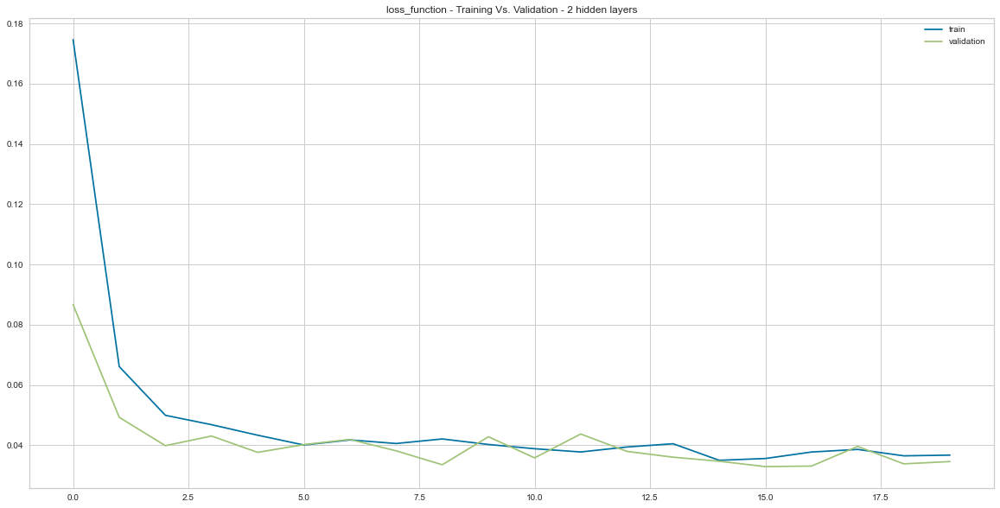

In [239]:
# Train vs test for shallow net
plt.figure(figsize=(20,10))
plt.plot(nn_model.history["loss"])
plt.plot(nn_model.history["val_loss"])
plt.title("loss_function - Training Vs. Validation - 2 hidden layers")
plt.legend(["train", "validation"])
plt.show()
plt.close()

In [240]:
# evaluate the model
scores = neural_network.evaluate(X_test_scaled, y_test_scaled)
print("\n%s: %.2f%%" % (neural_network.metrics_names[1], scores[1]*100))

8/8 [==============================] - 0s 4ms/step - loss: 0.0348 - mean_absolute_error: 0.0348

mean_absolute_error: 3.48%


In [241]:
# make predictions on X_test_scaled
predictions = neural_network.predict(X_test_scaled)

8/8 [==============================] - 0s 3ms/step


In [242]:
predicted_salaries = y_scaler.inverse_transform(predictions)
real_salaries = y_scaler.inverse_transform(y_test_scaled.reshape(-1, 1))

In [243]:
salaries = pd.DataFrame({
    "Real": real_salaries.ravel(),
    "Predicted": predicted_salaries.ravel()
})
salaries.head()

,Real,Predicted
0,16.68,17.287666
1,16.53,16.344456
2,23.50,22.106945
3,26.49,25.217041
4,16.25,15.341590


In [244]:
# obtain the root mean square error, this will show how far off my predictions are
np.sqrt(mean_squared_error(real_salaries, predicted_salaries))

1.2117624578139334

## Predicting the weekly salary

### Train-test split Weekly Salary

In [245]:
drop_elements = ['Weekly_Salary', 'Hourly_Salary']
y1 = Prediction["Weekly_Salary"].values.reshape(-1,1)
X1 = Prediction.drop(drop_elements, axis=1)
X1.head()

,Employees,Paid_Hours,Date_2008-01-01 00:00:00,Date_2008-04-01 00:00:00,Date_2008-07-01 00:00:00,Date_2008-10-01 00:00:00,Date_2009-01-01 00:00:00,Date_2009-04-01 00:00:00,Date_2009-07-01 00:00:00,Date_2009-10-01 00:00:00,...,Year_2020,Year_2021,Year_2022,Day of the week_Monday,Day of the week_Tuesday,Day of the week_Wednesday,Day of the week_Thursday,Day of the week_Friday,Day of the week_Saturday,Day of the week_Sunday
0,1767200,32.9,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
1,7100,44.1,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
2,212900,38.3,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,146700,37.6,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4,319000,31.4,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0


In [246]:
# look at the shape of each data set
X1.shape

(1197, 107)

In [247]:
y1.shape

(1197, 1)

In [248]:
# lets import train test split to split the data up
X_train, X_test, y_train, y_test = train_test_split(X1, y1, test_size=0.2, random_state=2)

In [249]:
# use MinMaxScaler to scale the date
x_scaler = MinMaxScaler()
y_scaler = MinMaxScaler()

In [250]:
# scale the training data
x_scaler.fit(X_train)
y_scaler.fit(y_train)
X_train_scaled = x_scaler.transform(X_train)
X_test_scaled = x_scaler.transform(X_test)
y_train_scaled = y_scaler.transform(y_train)
y_test_scaled =y_scaler.transform(y_test)

## Neural Network Model

In [251]:
# This will act as a random state variable....it might not be exact but it will be close to previous run
seed_value = 0
random.seed(seed_value)
np.random.seed(seed_value)
tf.random.set_seed(seed_value)

In [252]:
# first we need to define the number of hidden nodes and input features
# start with a shallow network and expand from there
# I am going to start with the number of columns as the input features
number_input_columns = X1.shape[1]
number_hidden_nodes = (X1.shape[1]*2)



# Create NN
neural_network = Sequential()

# create the input latter
neural_network.add(Dense(units = number_input_columns, input_dim = number_input_columns, activation = "tanh", kernel_initializer='normal' ))
# create hidden layer
neural_network.add(Dense(units = number_hidden_nodes,  activation = "tanh", kernel_initializer='normal'))

# 2nd hidden layer
neural_network.add(Dense(units = number_hidden_nodes,  activation = "tanh", kernel_initializer='normal'))

# create output layer
neural_network.add(Dense(units = 1, activation = "linear", kernel_initializer='normal'))

In [253]:
# complie the NN and we can see how many total parameters along with how many parameters are in each layer
neural_network.compile(loss="mean_absolute_error", optimizer="adam", metrics=["mean_absolute_error"])
neural_network.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             (None, 107)               11556     
                                                                 
 dense_5 (Dense)             (None, 214)               23112     
                                                                 
 dense_6 (Dense)             (None, 214)               46010     
                                                                 
 dense_7 (Dense)             (None, 1)                 215       
                                                                 
Total params: 80,893
Trainable params: 80,893
Non-trainable params: 0
_________________________________________________________________


In [254]:
# Fit the model to the training sets
nn_model = neural_network.fit(X_train_scaled, y_train_scaled,validation_split=0.2, epochs=20)

Epoch 1/20
24/24 [==============================] - 1s 18ms/step - loss: 0.1501 - mean_absolute_error: 0.1501 - val_loss: 0.0585 - val_mean_absolute_error: 0.0585
Epoch 2/20
24/24 [==============================] - 0s 6ms/step - loss: 0.0536 - mean_absolute_error: 0.0536 - val_loss: 0.0406 - val_mean_absolute_error: 0.0406
Epoch 3/20
24/24 [==============================] - 0s 7ms/step - loss: 0.0386 - mean_absolute_error: 0.0386 - val_loss: 0.0374 - val_mean_absolute_error: 0.0374
Epoch 4/20
24/24 [==============================] - 0s 7ms/step - loss: 0.0367 - mean_absolute_error: 0.0367 - val_loss: 0.0363 - val_mean_absolute_error: 0.0363
Epoch 5/20
24/24 [==============================] - 0s 7ms/step - loss: 0.0371 - mean_absolute_error: 0.0371 - val_loss: 0.0354 - val_mean_absolute_error: 0.0354
Epoch 6/20
24/24 [==============================] - 0s 6ms/step - loss: 0.0358 - mean_absolute_error: 0.0358 - val_loss: 0.0327 - val_mean_absolute_error: 0.0327
Epoch 7/20
24/24 [=========

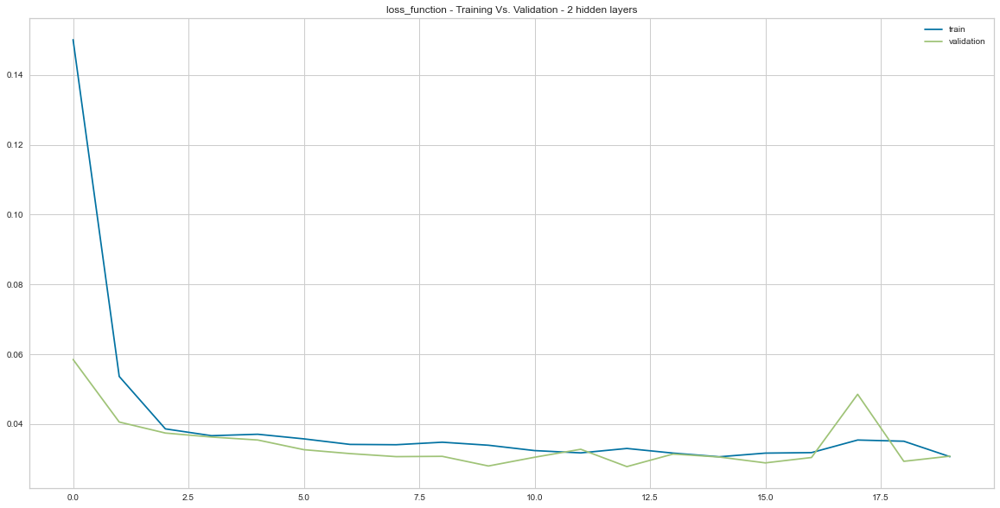

In [255]:
# Train vs test for shallow net
plt.figure(figsize=(20,10))
plt.plot(nn_model.history["loss"])
plt.plot(nn_model.history["val_loss"])
plt.title("loss_function - Training Vs. Validation - 2 hidden layers")
plt.legend(["train", "validation"])
plt.show()
plt.close()

In [256]:
# evaluate the model
scores = neural_network.evaluate(X_test_scaled, y_test_scaled)
print("\n%s: %.2f%%" % (neural_network.metrics_names[1], scores[1]*100))

8/8 [==============================] - 0s 3ms/step - loss: 0.0338 - mean_absolute_error: 0.0338

mean_absolute_error: 3.38%


In [257]:
# make predictions on X_test_scaled
predictions = neural_network.predict(X_test_scaled)

8/8 [==============================] - 0s 3ms/step


In [258]:
predicted_salaries = y_scaler.inverse_transform(predictions)
real_salaries = y_scaler.inverse_transform(y_test_scaled.reshape(-1, 1))

In [259]:
salaries = pd.DataFrame({
    "Real": real_salaries.ravel(),
    "Predicted": predicted_salaries.ravel()
})
salaries.head()

,Real,Predicted
0,513.98,543.191589
1,502.66,447.995209
2,837.05,779.527405
3,870.10,823.501282
4,460.68,427.885132


In [260]:
# obtain the root mean square error, this will show how far off my predictions are
np.sqrt(mean_squared_error(real_salaries, predicted_salaries))

47.016700738192924

# References


* Calamea, A. (2020) Visualization for timeseries exchange data using Plotly. Towards Data Science. Available at: https://towardsdatascience.com/visualization-for-timeseries-exchange-data-8c9f50d4d2d4 (Accessed 19 April 2022).


* Chart Explorers [ChartExplorers]. (2021). How to combine DataFrames in pandas | merge, join, concat, & append. Youtube. Available at: https://www.youtube.com/watch?v=wzN1UyfRSWI (Accessed 13 March 2022).


* Datacarpentry.org (n.d) Indexación, segmentación y creación de subconjuntos a partir de DataFrames en Python – Análisis y visualización de datos usando Python. Available at: https://datacarpentry.org/python-ecology-lesson-es/03-index-slice-subset/ (Accessed 9 February 2022).


* Eddie_. (2021). Dealing with missing values in python. Analytics Vidhya. Available at: https://www.analyticsvidhya.com/blog/2021/05/dealing-with-missing-values-in-python-a-complete-guide/ (Accessed 20 September 2021).


* GeeksforGeeks (2020) StandardScaler, MinMaxScaler and RobustScaler techniques-ML. Available at: https://www.geeksforgeeks.org/standardscaler-minmaxscaler-and-robustscaler-techniques-ml/ (Accessed 15 September 2021).


* Github.io. Scipy lecture notes. (n.d) Matplotlib: Gráficas usando pylab. Available at: https://claudiovz.github.io/scipy-lecture-notes-ES/intro/matplotlib/matplotlib.html (Accessed 1 November 2021).


* Kaggle.com (n.d) What is Root Mean Square Error (RMSE). Available at: https://www.kaggle.com/general/215997 (Accessed 15 March 2022).


* Khan, J. A. (2016). 32 automatically estimating the number of clusters using DBSCAN. Youtube. Available at: https://www.youtube.com/watch?v=Zdi8uLAw5cU (Accessed 27 April 2022).


* Kumar, A. (2021 ). Elbow method vs silhouette score - which is better? Data Analytics. Available at: https://vitalflux.com/elbow-method-silhouette-score-which-better/ (Accessed 25 March 2022).


* Lianne (2020) Data cleaning in Python: The ultimate guide. Towards Data Science. Available at: https://towardsdatascience.com/data-cleaning-in-python-the-ultimate-guide-2020-c63b88bf0a0d (Accessed 26 October 2021).


* Machinelearningmastery (n.d). Standardscaler and Minmaxscaler Transforms in Python. Available at: https://machinelearningmastery.com/standardscaler-and-minmaxscaler-transforms-in-python/ (Accessed 23 November 2021).


* Moffitt, C. (n.d) Pbpython: Guide to encoding categorical values in python. Available at: https://pbpython.com/categorical-encoding.html (Accessed 13 November 2021).


* Moody, J. (2019). What does RMSE really mean? Towards Data Science. Available at: https://towardsdatascience.com/what-does-rmse-really-mean-806b65f2e48e (Accessed 19 December 2021).


* Na. (2018). Aprende Machine Learning: Una sencilla Red Neuronal en Python con Keras y Tensorflow. Available at: https://www.aprendemachinelearning.com/una-sencilla-red-neuronal-en-python-con-keras-y-tensorflow/ (Accessed 19 May 2022).


* Python, R. (2022) Realpython: Combining Data in Pandas With merge(), .join(), and concat(). Available at: https://realpython.com/pandas-merge-join-and-concat/ (Accessed 15 October 2021).


* SAS Institute (n.d) Aprendizaje automático: Qué es y por qué importa Available at:  https://www.sas.com/es_mx/insights/analytics/machine-learning.html (Accessed 19 February 2022).


* Scikit-Learn (n.d). Selecting the number of clusters with silhouette analysis on KMeans clustering. Available at: https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html (Accessed 23 March 2022).


* Zapata, J. (n.d). PANDAS - Manipulacion de Datos con Python. Available at:  https://joserzapata.github.io/courses/python-ciencia-datos/pandas/ (Accessed 15 October 2021).














